# Systems and Tool Chains for AI Engineers - Project (FIFA Database)
# Saad Moalwi (smoalwi) & Aditya Shetty (aashetty)

We used ChatGPT for less than 30% to support parts of our work (OpenAI, 2025)."
OpenAI. (2025). ChatGPT [Large language model]. https://chat.openai.com/

# Library Import and Spark Initialization

In [1]:
# Below segment of code is to import the required libraries:

# Environment setup
# import findspark
# findspark.init()
# findspark.find()

import os
import sys
import glob
import socket
import time
import json
import re
# from dotenv import load_dotenv


# PySpark
import pyspark
from pyspark import SparkContext, SQLContext
from pyspark.sql import SparkSession, DataFrame
from pyspark.sql import functions as F
from pyspark.sql import Window
from pyspark.sql.functions import col, when, split
from pyspark.ml import Pipeline
from pyspark.ml.feature import Imputer
from pyspark.ml.feature import StringIndexer, OneHotEncoder
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.feature import StandardScaler
from pyspark.ml.regression import LinearRegression, RandomForestRegressor
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.tuning import ParamGridBuilder
from pyspark.ml.tuning import CrossValidator
from pyspark.ml.functions import vector_to_array


# Data analysis and visualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import seaborn as sb
from IPython.display import Image
from collections import defaultdict
import math
import shutil


## PyTorch, Streaming, and ML Utilities
import torch
from torch import nn
from sklearn.metrics import roc_curve
from torch.utils.data import DataLoader, TensorDataset
from streaming import StreamingDataset
from streaming.base import MDSWriter
from streaming.base.converters.dataframe_to_mds import dataframe_to_mds
import torch.utils.data


# --- New Imports for Spark and Streaming ---
from pyspark.sql.types import ArrayType, FloatType
from streaming import StreamingDataset
from streaming.base import MDSWriter
from streaming.base.converters.dataframe_to_mds import dataframe_to_mds



# External integrations
from confluent_kafka import Producer, KafkaError
from googleapiclient.discovery import build
from googleapiclient.errors import HttpError
from neo4j import GraphDatabase

C:\Users\S5\anaconda3\envs\sys\lib\site-packages\google\api_core\_python_version_support.py:266: FutureWarning: You are using a Python version (3.10.19) which Google will stop supporting in new releases of google.api_core once it reaches its end of life (2026-10-04). Please upgrade to the latest Python version, or at least Python 3.11, to continue receiving updates for google.api_core past that date.
  warnings.warn(message, FutureWarning)


In [21]:
# # Below segment of code initializes Spark with PostgreSQL

# jar_path = r"C:\Program Files\Spark\spark-4.0.0-bin-hadoop3\jars\postgresql-42.7.7.jar"
# spark = (SparkSession.builder.master("local[*]").appName("FIFAProject").config("spark.jars", jar_path).getOrCreate())

In [5]:
# Path to PostgreSQL JDBC driver
jar_path = r"C:\Program Files\Spark\spark-4.0.0-bin-hadoop3\jars\postgresql-42.7.7.jar"

spark = (
    SparkSession.builder
    .appName("FIFAProject")
    .master("local[*]")
    .config("spark.jars", jar_path)
    .config("spark.driver.memory", "8g")
    .config("spark.executor.memory", "8g")
    .config("spark.network.timeout", "1200s")
    .config("spark.executor.heartbeatInterval", "200s")
    .config("spark.port.maxRetries", "128")
    .config("spark.python.worker.reuse", "true")
    .getOrCreate()
)

print("✅ Spark session started successfully.")

✅ Spark session started successfully.


In [23]:
print("Python:", sys.version)
print("PySpark:", pyspark.__version__)
print("Spark:", spark.version)
print("pytorch", torch.__version__)
# sc.version

Python: 3.10.19 | packaged by Anaconda, Inc. | (main, Oct 21 2025, 16:41:31) [MSC v.1929 64 bit (AMD64)]
PySpark: 4.0.1
Spark: 4.0.0
pytorch 2.9.0+cpu


# Task-I: Build and populate necessary tables (30% of course project grade)

### Ingest Datasets into Spark

In [43]:
# Below segment of code reads CSV files from Data folder:

files = glob.glob("Data/*.csv")

print("Found files:")
for f in files:
    print(f)

col_dict = {}
    
for f in files:
    df_tmp = spark.read.csv(f, header=True, inferSchema=True)
    col_dict[f] = df_tmp.columns

Found files:
Data\female_players_16.csv
Data\female_players_17.csv
Data\female_players_18.csv
Data\female_players_19.csv
Data\female_players_20.csv
Data\female_players_21.csv
Data\female_players_22.csv
Data\players_15.csv
Data\players_16.csv
Data\players_17.csv
Data\players_18.csv
Data\players_19.csv
Data\players_20.csv
Data\players_21.csv
Data\players_22.csv


### Rename columns as needed to ensure that data from different years align correctly in the appropriate columns of your table.

In [44]:
# Below segment of code checks whether the file headers are arranged in the same order:

first = next(iter(col_dict.values()))
mismatch = {}
for f, cols in col_dict.items():
    if cols != first:
        mismatch[f] = cols

if not mismatch:
    print("All files have the same columns arrangement")
else:
    print("Mismatches found:")
    for f, cols in mismatch.items():
        print(f, "differs. Columns:", cols)

All files have the same columns arrangement


### Add a new column for the year. Also, ensure every record can be uniquely identified in the database table

In [45]:
# Below segment of code adds an extra column to indicate the gender:

dfs_gender = []
for f in files:
    gender = "female" if "female_players" in f else "male"
    
    df_i = (spark.read
            .option("header", True)
            .option("inferSchema", True)
            .csv(f)
            .withColumn("gender", F.lit(gender)))
    
    dfs_gender.append(df_i)

dfs = dfs_gender

In [46]:
# Below segment of code adds an extra column to indicate the year:

dfs_year = []
for f, df_i in zip(files, dfs):
    year_suffix = f.split("_")[-1].replace(".csv", "")
    year = 2000 + int(year_suffix)
    df_i = df_i.withColumn("year", F.lit(year).cast("int"))
    dfs_year.append(df_i)

# Union everything into one DataFrame
df = dfs_year[0]
for df_i in dfs_year[1:]:
    df = df.unionByName(df_i)

    
df.groupBy("year", "gender").count().orderBy("year", "gender").show()
print(f"Total rows in all of the dfs: {df.count()}")
print()

rows = df.count()
cols = len(df.columns)
print(f"New DataFrame shape: ({rows}, {cols})")

+----+------+-----+
|year|gender|count|
+----+------+-----+
|2015|  male|16155|
|2016|female|  248|
|2016|  male|15623|
|2017|female|  299|
|2017|  male|17596|
|2018|female|  317|
|2018|  male|17954|
|2019|female|  299|
|2019|  male|18085|
|2020|female|  345|
|2020|  male|18483|
|2021|female|  345|
|2021|  male|18944|
|2022|female|  391|
|2022|  male|19239|
+----+------+-----+

Total rows in all of the dfs: 144323

New DataFrame shape: (144323, 112)


In [9]:
# Below segment of SQL code in PostgreSQL is used to ensure each record has a unique identifier:

# -- Create schema
# CREATE SCHEMA IF NOT EXISTS fifa;

# -- Create table inside that schema
# CREATE TABLE fifa.fifa15_22 (
#     id SERIAL PRIMARY KEY,
#     sofifa_id INT,
#     player_url TEXT,
#     short_name TEXT,
#     long_name TEXT,
#     player_positions TEXT,
#     overall INT,
#     potential INT,
#     value_eur DOUBLE PRECISION,
#     wage_eur DOUBLE PRECISION,
#     age INT,
#     dob DATE,
#     height_cm INT,
#     weight_kg INT,
#     club_team_id DOUBLE PRECISION,
#     club_name TEXT,
#     league_name TEXT,
#     league_level INT,
#     club_position TEXT,
#     club_jersey_number INT,
#     club_loaned_from TEXT,
#     club_joined DATE,
#     club_contract_valid_until INT,
#     nationality_id INT,
#     nationality_name TEXT,
#     nation_team_id DOUBLE PRECISION,
#     nation_position TEXT,
#     nation_jersey_number INT,
#     preferred_foot TEXT,
#     weak_foot INT,
#     skill_moves INT,
#     international_reputation INT,
#     work_rate TEXT,
#     body_type TEXT,
#     real_face TEXT,
#     release_clause_eur BIGINT,
#     player_tags TEXT,
#     player_traits TEXT,
#     pace INT,
#     shooting INT,
#     passing INT,
#     dribbling INT,
#     defending INT,
#     physic INT,
#     attacking_crossing INT,
#     attacking_finishing INT,
#     attacking_heading_accuracy INT,
#     attacking_short_passing INT,
#     attacking_volleys INT,
#     skill_dribbling INT,
#     skill_curve INT,
#     skill_fk_accuracy INT,
#     skill_long_passing INT,
#     skill_ball_control INT,
#     movement_acceleration INT,
#     movement_sprint_speed INT,
#     movement_agility INT,
#     movement_reactions INT,
#     movement_balance INT,
#     power_shot_power INT,
#     power_jumping INT,
#     power_stamina INT,
#     power_strength INT,
#     power_long_shots INT,
#     mentality_aggression INT,
#     mentality_interceptions INT,
#     mentality_positioning INT,
#     mentality_vision INT,
#     mentality_penalties INT,
#     mentality_composure BIGINT,
#     defending_marking_awareness INT,
#     defending_standing_tackle INT,
#     defending_sliding_tackle INT,
#     goalkeeping_diving INT,
#     goalkeeping_handling INT,
#     goalkeeping_kicking INT,
#     goalkeeping_positioning INT,
#     goalkeeping_reflexes INT,
#     goalkeeping_speed INT,
#     ls TEXT,
#     st TEXT,
#     rs TEXT,
#     lw TEXT,
#     lf TEXT,
#     cf TEXT,
#     rf TEXT,
#     rw TEXT,
#     lam TEXT,
#     cam TEXT,
#     ram TEXT,
#     lm TEXT,
#     lcm TEXT,
#     cm TEXT,
#     rcm TEXT,
#     rm TEXT,
#     lwb TEXT,
#     ldm TEXT,
#     cdm TEXT,
#     rdm TEXT,
#     rwb TEXT,
#     lb TEXT,
#     lcb TEXT,
#     cb TEXT,
#     rcb TEXT,
#     rb TEXT,
#     gk TEXT,
#     player_face_url TEXT,
#     club_logo_url TEXT,
#     club_flag_url TEXT,
#     nation_logo_url TEXT,
#     nation_flag_url TEXT,
#     gender TEXT,
#     year INT
# );

In [29]:
df.printSchema()

root
 |-- sofifa_id: integer (nullable = true)
 |-- player_url: string (nullable = true)
 |-- short_name: string (nullable = true)
 |-- long_name: string (nullable = true)
 |-- player_positions: string (nullable = true)
 |-- overall: integer (nullable = true)
 |-- potential: integer (nullable = true)
 |-- value_eur: double (nullable = true)
 |-- wage_eur: double (nullable = true)
 |-- age: integer (nullable = true)
 |-- dob: date (nullable = true)
 |-- height_cm: integer (nullable = true)
 |-- weight_kg: integer (nullable = true)
 |-- club_team_id: double (nullable = true)
 |-- club_name: string (nullable = true)
 |-- league_name: string (nullable = true)
 |-- league_level: long (nullable = true)
 |-- club_position: string (nullable = true)
 |-- club_jersey_number: long (nullable = true)
 |-- club_loaned_from: string (nullable = true)
 |-- club_joined: date (nullable = true)
 |-- club_contract_valid_until: long (nullable = true)
 |-- nationality_id: integer (nullable = true)
 |-- natio

In [30]:
df.show(1, vertical=True)

-RECORD 0-------------------------------------------
 sofifa_id                   | 226324               
 player_url                  | https://sofifa.co... 
 short_name                  | C. Lloyd             
 long_name                   | Carli Anne Hollins   
 player_positions            | CM, CAM, LM, ST      
 overall                     | 91                   
 potential                   | 91                   
 value_eur                   | NULL                 
 wage_eur                    | NULL                 
 age                         | 32                   
 dob                         | 1982-07-16           
 height_cm                   | 173                  
 weight_kg                   | 64                   
 club_team_id                | NULL                 
 club_name                   | NULL                 
 league_name                 | NULL                 
 league_level                | NULL                 
 club_position               | NULL           

In [31]:
df.dtypes

[('sofifa_id', 'int'),
 ('player_url', 'string'),
 ('short_name', 'string'),
 ('long_name', 'string'),
 ('player_positions', 'string'),
 ('overall', 'int'),
 ('potential', 'int'),
 ('value_eur', 'double'),
 ('wage_eur', 'double'),
 ('age', 'int'),
 ('dob', 'date'),
 ('height_cm', 'int'),
 ('weight_kg', 'int'),
 ('club_team_id', 'double'),
 ('club_name', 'string'),
 ('league_name', 'string'),
 ('league_level', 'bigint'),
 ('club_position', 'string'),
 ('club_jersey_number', 'bigint'),
 ('club_loaned_from', 'string'),
 ('club_joined', 'date'),
 ('club_contract_valid_until', 'bigint'),
 ('nationality_id', 'int'),
 ('nationality_name', 'string'),
 ('nation_team_id', 'double'),
 ('nation_position', 'string'),
 ('nation_jersey_number', 'int'),
 ('preferred_foot', 'string'),
 ('weak_foot', 'int'),
 ('skill_moves', 'int'),
 ('international_reputation', 'int'),
 ('work_rate', 'string'),
 ('body_type', 'string'),
 ('real_face', 'string'),
 ('release_clause_eur', 'bigint'),
 ('player_tags', 'stri

In [32]:
# Below segment of code defines the full schema for fifa15_22 table with column names and data types, each row has 4 features:

df_all_columns = """
    sofifa_id INT, player_url TEXT, short_name TEXT, long_name TEXT,
    player_positions TEXT, overall INT, potential INT, value_eur DOUBLE PRECISION,
    wage_eur DOUBLE PRECISION, age INT, dob DATE, height_cm INT,
    weight_kg INT, club_team_id DOUBLE PRECISION, club_name TEXT, league_name TEXT,
    league_level INT, club_position TEXT, club_jersey_number INT, club_loaned_from TEXT,
    club_joined DATE, club_contract_valid_until INT, nationality_id INT, nationality_name TEXT,
    nation_team_id DOUBLE PRECISION, nation_position TEXT, nation_jersey_number INT, preferred_foot TEXT,
    weak_foot INT, skill_moves INT, international_reputation INT, work_rate TEXT,
    body_type TEXT, real_face TEXT, release_clause_eur BIGINT, player_tags TEXT,
    player_traits TEXT, pace INT, shooting INT, passing INT,
    dribbling INT, defending INT, physic INT, attacking_crossing INT,
    attacking_finishing INT, attacking_heading_accuracy INT, attacking_short_passing INT, attacking_volleys INT,
    skill_dribbling INT, skill_curve INT, skill_fk_accuracy INT, skill_long_passing INT,
    skill_ball_control INT, movement_acceleration INT, movement_sprint_speed INT, movement_agility INT,
    movement_reactions INT, movement_balance INT, power_shot_power INT, power_jumping INT,
    power_stamina INT, power_strength INT, power_long_shots INT, mentality_aggression INT,
    mentality_interceptions INT, mentality_positioning INT, mentality_vision INT, mentality_penalties INT,
    mentality_composure BIGINT, defending_marking_awareness INT, defending_standing_tackle INT, defending_sliding_tackle INT,
    goalkeeping_diving INT, goalkeeping_handling INT, goalkeeping_kicking INT, goalkeeping_positioning INT,
    goalkeeping_reflexes INT, goalkeeping_speed INT, ls TEXT, st TEXT,
    rs TEXT, lw TEXT, lf TEXT, cf TEXT,
    rf TEXT, rw TEXT, lam TEXT, cam TEXT,
    ram TEXT, lm TEXT, lcm TEXT, cm TEXT,
    rcm TEXT, rm TEXT, lwb TEXT, ldm TEXT,
    cdm TEXT, rdm TEXT, rwb TEXT, lb TEXT,
    lcb TEXT, cb TEXT, rcb TEXT, rb TEXT,
    gk TEXT, player_face_url TEXT, club_logo_url TEXT, club_flag_url TEXT,
    nation_logo_url TEXT, nation_flag_url TEXT, gender TEXT, year INT
"""

### Ingest the data from all years (Male: 2015 - 2022, Female: 2016 - 2022) into a single PostgreSQL database table

In [48]:
# Below segment of code sets PostgreSQL connection properties and writes the DataFrame into fifa.fifa15_22 table:

db_properties = {}
db_properties['username'] = "postgres"
db_properties['password'] = "saad1234"
db_properties['url'] = "jdbc:postgresql://localhost:5432/fifa_db"
db_properties['table'] = "fifa.fifa15_22"
db_properties['driver'] = "org.postgresql.Driver"

(df.write
 .format("jdbc")
 .mode("append")
 .option("url", db_properties['url'])
 .option("dbtable", db_properties['table'])
 .option("user", db_properties['username'])
 .option("password", db_properties['password'])
 .option("driver", db_properties['driver'])
 .option("createTableColumnTypes", df_all_columns)
 .save())

print("Data successfully written to PostgreSQL!")

Data successfully written to PostgreSQL!


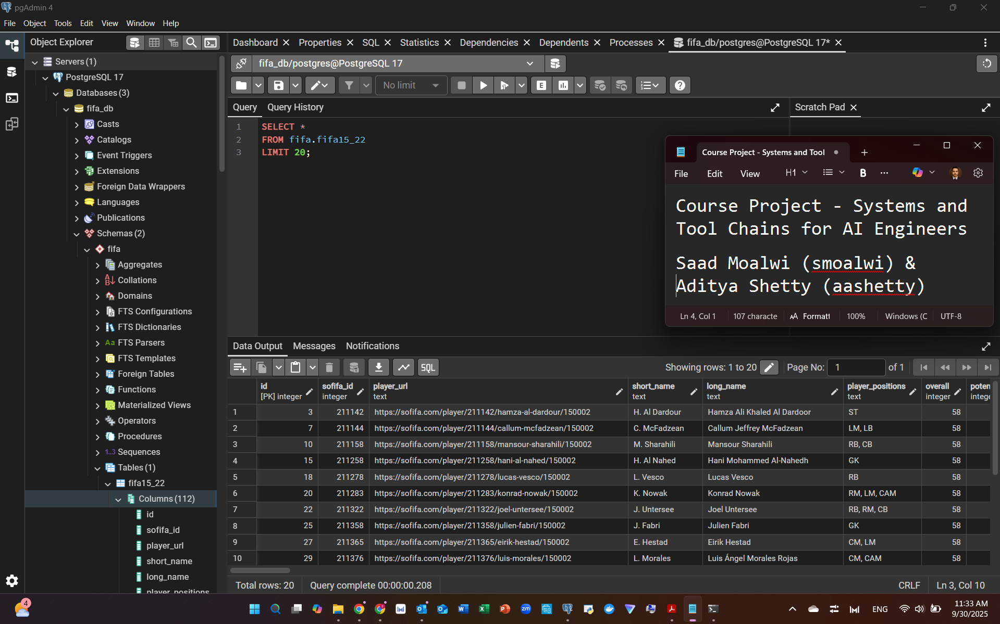

In [16]:
Image("p1_1.png")

### Check the ReadMe.md for the features description in the dataset.

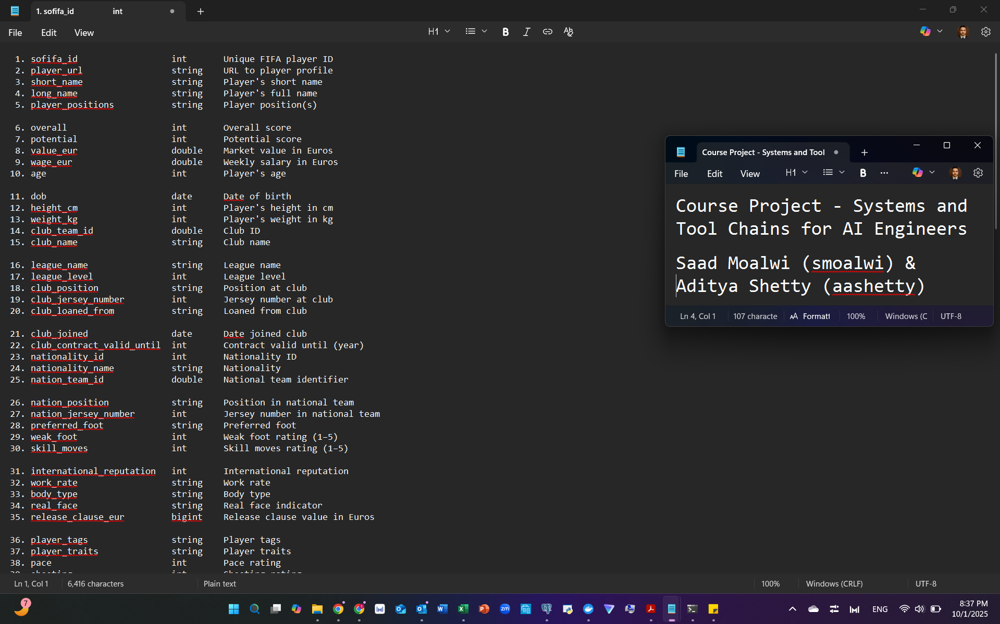

In [17]:
Image("p1_2.png")

### In this specific case, would it be better to use a NoSQL database (e.g., Neo4J) instead of a PostgreSQL?

Based on the code and project requirements, PostgreSQL is the better fit compared to NoSQL databases because the FIFA data is highly structured and tabular, with well-defined columns and a consistent schema across years. Relational databases excel at efficiently storing, querying, and aggregating this type of data, while NoSQL is generally more advantageous for highly interconnected, evolving, or unstructured datasets—which is not the case here.
That said, we do not want to rule out the use of NoSQL databases, particularly graph databases such as Neo4j. They may offer stronger and more customized visualization options (as shown below).

In [18]:
# Below segment of code initializes the Neo4j connection:

class Neo4JConnection:
    def __init__(self, uri, user, password):
        """Initialize the Neo4j connection with URI, username, and password."""
        self.driver = GraphDatabase.driver(uri, auth=(user, password))

    def close(self):
        """Close the Neo4j connection."""
        if self.driver:
            self.driver.close()

    def execute_query(self, query, parameters=None):
        """Execute a Cypher query and return the result."""
        with self.driver.session() as session:
            result = session.run(query, parameters)
            return result.data()

uri      = "neo4j://localhost:7687"
user     = "neo4j"
password = "1947Ferrari"

conn = Neo4JConnection(uri, user, password)

In [22]:
# Below segment of code is to exemplify how a graph database can be used:

club_name_target = "Real Madrid CF"
df_sample_neo4j = (
    df.filter(F.col("club_name") == club_name_target)
      .select("sofifa_id", "short_name", "club_name", "year")
      .na.drop(subset=["sofifa_id", "club_name", "year"])
)

conn.execute_query("CREATE CONSTRAINT player_id IF NOT EXISTS FOR (p:Player) REQUIRE p.id IS UNIQUE;")
conn.execute_query("CREATE CONSTRAINT club_name IF NOT EXISTS FOR (c:Club) REQUIRE c.name IS UNIQUE;")

conn.execute_query("MERGE (:Club {name: $name});", {"name": club_name_target})

def upsert_batch(rows):
    cypher = """
    UNWIND $rows AS row
    WITH row
    MERGE (p:Player {id: toInteger(row.sofifa_id)})
      ON CREATE SET p.name = row.short_name
      ON MATCH  SET p.name = coalesce(p.name, row.short_name)
    MERGE (c:Club {name: row.club_name})
    MERGE (p)-[:PLAYS_FOR {year: toInteger(row.year)}]->(c)
    """
    conn.execute_query(cypher, {"rows": rows})

cols = ["sofifa_id", "short_name", "club_name", "year"]
batch, B = [], 1000
for r in df_sample_neo4j.select(*cols).toLocalIterator():
    batch.append({c: r[c] for c in cols})
    if len(batch) >= B:
        upsert_batch(batch)
        batch.clear()
if batch:
    upsert_batch(batch)

conn.close()

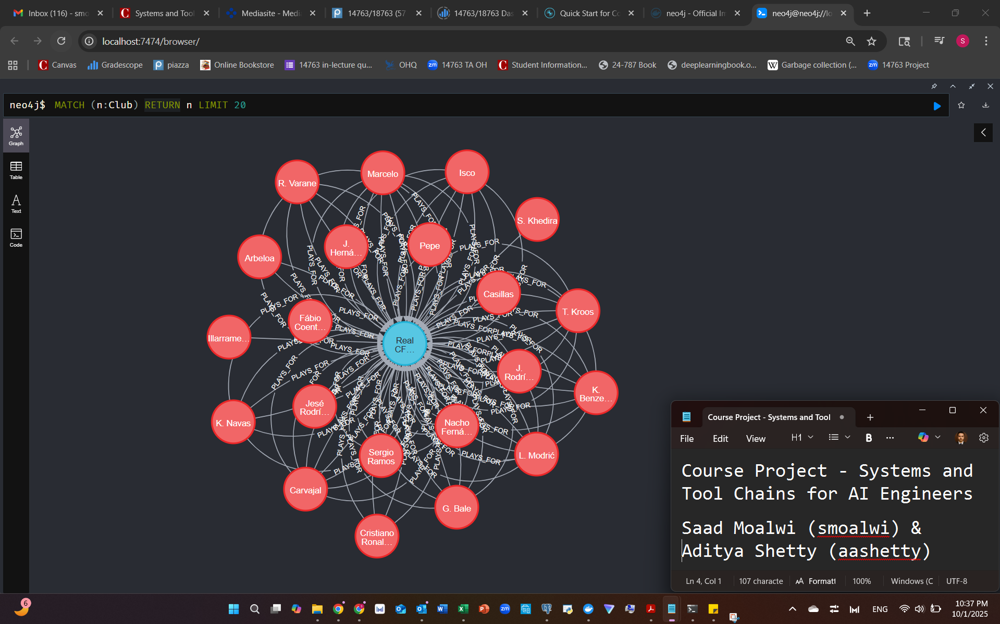

In [23]:
Image("p1_3.png")

# Task-II: Conduct analytics on your dataset (20% of course project grade)

In [7]:
# --- Read Data Back from PostgreSQL into Spark DataFrame ---

# PostgreSQL connection properties
db_properties = {
    "username": "postgres",
    "password": "saad1234",
    "url": "jdbc:postgresql://localhost:5432/fifa_db",
    "table": "fifa.fifa15_22",
    "driver": "org.postgresql.Driver"
}

# Read the data
df = (
    spark.read
    .format("jdbc")
    .option("url", db_properties["url"])
    .option("dbtable", db_properties["table"])
    .option("user", db_properties["username"])
    .option("password", db_properties["password"])
    .option("driver", db_properties["driver"])
    .load()
)

print("✅ Data successfully imported from PostgreSQL!")
print(f"Rows: {df.count():,} | Columns: {len(df.columns)}")

# Optional: show sample records
df.show(1, truncate=False)

✅ Data successfully imported from PostgreSQL!
Rows: 144,323 | Columns: 113
+---+---------+---------------------------------------------------+----------+------------------+----------------+-------+---------+---------+--------+---+----------+---------+---------+------------+---------+-----------+------------+-------------+------------------+----------------+-----------+-------------------------+--------------+----------------+--------------+---------------+--------------------+--------------+---------+-----------+------------------------+-------------+----------------+---------+------------------+----------------------------------+--------------------------------------------------------------------------+----+--------+-------+---------+---------+------+------------------+-------------------+--------------------------+-----------------------+-----------------+---------------+-----------+-----------------+------------------+------------------+---------------------+---------------------+--

### 1. In Year X, what were the Y clubs that had the highest number of players with contracts ending in year Z (or after)?

In [35]:
def top_clubs_by_contract(year_x, top_y, contract_year_z):
    df_filtered = (
        df.filter(
            (F.col("year") == year_x) &
            (F.col("club_contract_valid_until") >= contract_year_z) &
            (F.lower(F.col("gender")) == "male")
        )
        .groupBy("club_name")
        .agg(F.count("*").alias("player_count"))
        .orderBy(F.desc("player_count"))
    )
    return df_filtered.limit(top_y)

# Example usage:
top10_clubs = top_clubs_by_contract(2022, 10, 2023)
top10_clubs.show()


+--------------------+------------+
|           club_name|player_count|
+--------------------+------------+
|        Leeds United|          29|
|          Sevilla FC|          29|
|Borussia Möncheng...|          27|
|        FC Barcelona|          27|
|       VfB Stuttgart|          27|
|           Liverpool|          27|
|       Dinamo Zagreb|          27|
|          SL Benfica|          26|
|   Manchester United|          26|
| Paris Saint-Germain|          26|
+--------------------+------------+



### 2. List the X clubs with the highest (or lowest) average player age for a given year Y.

In [51]:
def clubs_by_average_age(top_x, year_y, highest=True):
    # --- Input validation ---
    if not isinstance(top_x, int) or top_x <= 0:
        print("Warning: top_x must be a positive integer.")
        return None
    if year_y < 2015 or year_y > 2022:
        print("Warning: year_y must be between 2015 and 2022 (inclusive).")
        return None

    # --- Filter for given year and male players only ---
    df_year = df.filter(
        (df.year == year_y) &
        (F.lower(F.col("gender")) == "male")
    )

    # --- Compute average age per club ---
    club_avg = (
        df_year.groupBy("club_name")
        .agg(F.avg("age").alias("avg_age"))
    )

    # --- Order clubs based on average age ---
    ordered = club_avg.orderBy(F.desc("avg_age") if highest else F.asc("avg_age"))
    top_df = ordered.limit(top_x)
    top_values = top_df.collect()

    if not top_values:
        return top_df

    # --- Handle ties at cutoff ---
    cutoff_value = top_values[-1]["avg_age"]
    final_df = (
        ordered.filter(F.col("avg_age") >= cutoff_value)
        if highest else
        ordered.filter(F.col("avg_age") <= cutoff_value)
    )

    return final_df

# Example usage:
highest_avg_age_clubs = clubs_by_average_age(10, 2022, highest=True)
lowest_avg_age_clubs = clubs_by_average_age(10, 2022, highest=False)

# Highest 5 teams by average age in 2021 (male only)
highest_avg_age_clubs.show()

# Lowest 5 teams by average age in 2021 (male only)
lowest_avg_age_clubs.show()


+--------------------+------------------+
|           club_name|           avg_age|
+--------------------+------------------+
|         Guaireña FC|             30.25|
|    12 de Octubre FC|             30.05|
| Shanghai Shenhua FC|29.892857142857142|
|Demir Grup Sivasspor|29.333333333333332|
|            CFR Cluj|28.857142857142858|
|          Qingdao FC|28.678571428571427|
|   Incheon United FC|28.607142857142858|
|            Altay SK|28.551724137931036|
|           São Paulo|              28.4|
|Club River Plate ...|              28.3|
+--------------------+------------------+

+--------------------+------------------+
|           club_name|           avg_age|
+--------------------+------------------+
|     FC Nordsjælland|20.115384615384617|
|      SC Freiburg II|20.857142857142858|
|     Real Sociedad B|             21.16|
|Borussia Dortmund II| 21.46153846153846|
|         Bohemian FC|             22.04|
|       AFC Wimbledon|22.153846153846153|
|            Barnsley|22.16666666

In [58]:
highest_avg_age_clubs = clubs_by_average_age(10, 2018, highest=True)

count_high = highest_avg_age_clubs.count()
print(f"\n=== 2018: Highest Avg Age Clubs ===")
print(f"Total clubs returned: {count_high}")
highest_avg_age_clubs.orderBy(F.desc("avg_age")).show(truncate=False)


=== 2018: Highest Avg Age Clubs ===
Total clubs returned: 13
+---------------------------------+-------+
|club_name                        |avg_age|
+---------------------------------+-------+
|Associação Chapecoense de Futebol|30.6   |
|Club Athletico Paranaense        |30.0   |
|Grêmio                           |30.0   |
|Santos                           |29.8   |
|CD Universidad de Concepción     |29.8   |
|CD Huachipato                    |29.8   |
|Universidad de Chile             |29.6   |
|San Luis de Quillota             |29.6   |
|Unión Española                   |29.4   |
|Sport Club do Recife             |29.4   |
|Deportes Iquique                 |29.4   |
|CD Antofagasta                   |29.4   |
|Curicó Unido                     |29.4   |
+---------------------------------+-------+



### 3. What is the most popular nationality in the dataset for each year? (i.e. display the most frequent nation for 2015, 2016, etc.).

In [37]:
def most_popular_nationality():
    pop_nation = (
        df.filter(F.lower(F.col("gender")) == "male")
        .groupBy("year", "nationality_name")
        .agg(F.count("*").alias("count"))
        .groupBy("year")
        .agg(F.max(F.struct(F.col("count"), F.col("nationality_name"))).alias("top"))
        .select("year", "top.nationality_name", "top.count")
        .orderBy("year")
    )
    return pop_nation

# Example usage:
most_pop_nations = most_popular_nationality()
most_pop_nations.show()


+----+----------------+-----+
|year|nationality_name|count|
+----+----------------+-----+
|2015|         England| 1627|
|2016|         England| 1519|
|2017|         England| 1627|
|2018|         England| 1633|
|2019|         England| 1625|
|2020|         England| 1670|
|2021|         England| 1685|
|2022|         England| 1719|
+----+----------------+-----+



### 4. Show a histogram of player nationalities across all years

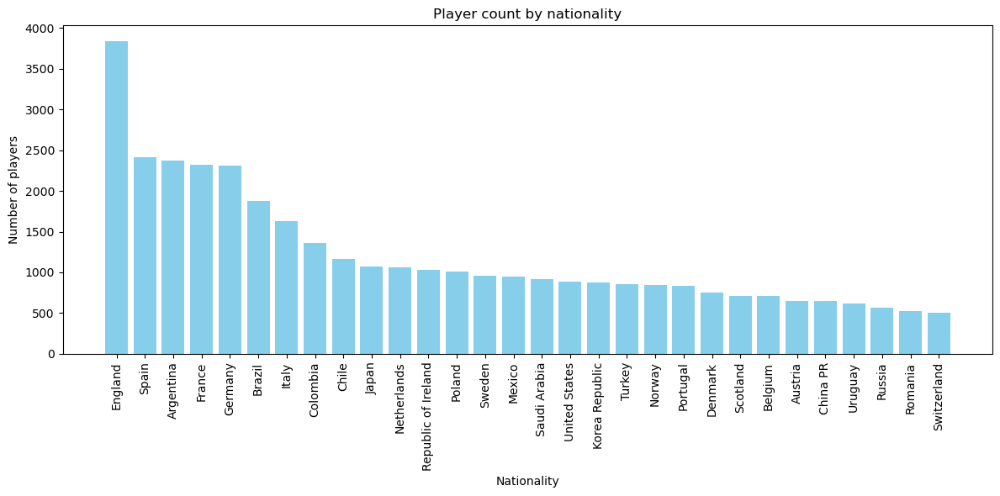

+-------------------+------------+
|nationality_name   |player_count|
+-------------------+------------+
|England            |3839        |
|Spain              |2418        |
|Argentina          |2375        |
|France             |2326        |
|Germany            |2314        |
|Brazil             |1882        |
|Italy              |1628        |
|Colombia           |1362        |
|Chile              |1169        |
|Japan              |1071        |
|Netherlands        |1059        |
|Republic of Ireland|1026        |
|Poland             |1007        |
|Sweden             |957         |
|Mexico             |952         |
|Saudi Arabia       |914         |
|United States      |882         |
|Korea Republic     |879         |
|Turkey             |852         |
|Norway             |841         |
|Portugal           |838         |
|Denmark            |750         |
|Scotland           |712         |
|Belgium            |710         |
|Austria            |653         |
|China PR           

In [38]:
def unique_nationality_histogram():
    dedup_players = (
        df.filter(F.lower(F.col("gender")) == "male")
          .select("sofifa_id", "nationality_name")
          .dropDuplicates(["sofifa_id"])
          .filter(F.col("nationality_name").isNotNull())
    )

    # Group by nationality and count unique players
    hist = (
        dedup_players.groupBy("nationality_name")
        .agg(F.count("*").alias("player_count"))
        .orderBy(F.desc("player_count"))
    )
    return hist


def plot_top_nationalities(spark_df, title="Player count by nationality", top_n=None):
    pdf = spark_df.toPandas()
    if top_n:
        pdf = pdf.head(top_n)
    plt.figure(figsize=(12,6))
    plt.bar(pdf["nationality_name"], pdf["player_count"], color="skyblue")
    plt.xticks(rotation=90)
    plt.xlabel("Nationality")
    plt.ylabel("Number of players")
    plt.title(title)
    plt.tight_layout()
    plt.show()


# Example usage:
nation_hist = unique_nationality_histogram()
plot_top_nationalities(nation_hist, top_n=30)
nation_hist.show(30, truncate=False)


### 5. Among the available players in the Male 2022 player dataset, identify which player is most popular in YouTube video comments. (Use a 5-minute YouTube feed to pull videos).

In [8]:
keywords = ["fifa world cup", "soccer", "football", "fifa"]
BROKER = 'localhost:9092'
TOPIC = 'youtube_topic'
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = "cmu-class.json"

# --- Player Name Extraction ---
df_22_distinct_male = df.filter((F.col("year") == 2022) & (F.col("gender") == "male")).dropDuplicates(["sofifa_id"])
player_names = [row.short_name.lower() for row in df_22_distinct_male.select("short_name").collect()]
player_mentions = {name: 0 for name in player_names}


print("--- Sample Player Names for Comment Matching (First 5) ---")
print(player_names[:5])
print("-" * 55)


# --- Helper Functions ---
def create_kafka_producer(broker):
    conf = {'bootstrap.servers': broker, 'client.id': socket.gethostname()}
    return Producer(conf)

def get_video_ids_from_keywords(keywords, youtube, max_per_keyword=20):
    video_ids, seen = [], set()
    for kw in keywords:
        try:
            response = youtube.search().list(
                part="id",
                q=kw,
                type="video",
                order="relevance",
                maxResults=max_per_keyword
            ).execute()
        except HttpError as e:
            print(f"⚠️ Skipping keyword '{kw}' due to API error: {e}")
            continue

        for item in response.get("items", []):
            # ✅ Skip anything without an actual videoId key
            vid_info = item.get("id", {})
            vid = vid_info.get("videoId")
            if not vid:
                continue  # ignore channels/playlists/etc.
            if vid not in seen:
                seen.add(vid)
                video_ids.append(vid)

    print(f"✅ Found {len(video_ids)} unique video IDs across {len(keywords)} keywords.")
    return video_ids

def get_video_title(video_id, youtube):
    response = youtube.videos().list(part="snippet", id=video_id).execute()
    items = response.get("items", [])
    if items:
        return items[0]["snippet"].get("title", "(unknown title)")
    return "(unknown title)"

def total_likes_from_top_comments(video_id, youtube):
    response = youtube.commentThreads().list(
        part='snippet',
        videoId=video_id,
        maxResults=20,
        textFormat='plainText'
    ).execute()
    total_likes = 0
    for item in response.get('items', []):
        snippet = item['snippet']['topLevelComment']['snippet']
        total_likes += int(snippet.get('likeCount', 0))
    return total_likes

def find_most_popular_video(video_ids, youtube):
    best = None
    for vid in video_ids:
        try:
            total_likes = total_likes_from_top_comments(vid, youtube)
        except HttpError:
            continue
        title = get_video_title(vid, youtube)
        if best is None or total_likes > best["likes"]:
            best = {"video_id": vid, "title": title, "likes": total_likes}
    if best:
        print(f"\n Video with ID {best['video_id']} and Title '{best['title']}' "
              f"has the most likes on its top-level comments ({best['likes']} likes).")
    else:
        print("No videos provided.")

def has_accessible_comments(video_id, youtube):
    """Check if a video's comments are accessible before fetching."""
    try:
        youtube.commentThreads().list(
            part='snippet',
            videoId=video_id,
            maxResults=1,
            textFormat='plainText'
        ).execute()
        return True
    except HttpError:
        return False

def get_comments(video_id):
    global player_mentions
    try:
        response = youtube.commentThreads().list(
            part='snippet',
            videoId=video_id,
            textFormat='plainText',
            maxResults=100
        ).execute()
    except HttpError as e:
        print(f"Skipping video {video_id}: {e}")
        return []

    comments = []
    for item in response.get('items', []):
        comment = item['snippet']['topLevelComment']['snippet']
        comment_text = comment['textDisplay'].lower()
        for player in player_names:
            pattern = r'\b' + re.escape(player) + r'\b'
            if re.search(pattern, comment_text):
                player_mentions[player] += 1
        comments.append({
            'author': comment.get('authorDisplayName', ''),
            'text': comment.get('textDisplay', ''),
            'like_count': comment.get('likeCount', 0),
            'published_at': comment.get('publishedAt', '')
        })
    return comments


# --- Main Execution ---
if __name__ == "__main__":
    youtube = build('youtube', 'v3')

    # Step 1: Get videos for given keywords
    candidates = get_video_ids_from_keywords(keywords, youtube, max_per_keyword=10)

    # Step 2: Keep only those with accessible comments
    video_ids = [vid for vid in candidates if has_accessible_comments(vid, youtube)]
    if not video_ids:
        print("No videos with accessible comments found. Proceeding with all candidates.")
        video_ids = candidates

    # Step 3: Fetch comments and count mentions
    skipped = 0
    for vid in video_ids:
        try:
            get_comments(vid)
        except HttpError:
            skipped += 1
            continue

    # Step 4: Print mention summary
    print("\n--- Player Mention Count in Comments ---")
    sorted_mentions = sorted(player_mentions.items(), key=lambda item: item[1], reverse=True)
    any_output = False
    for player, count in sorted_mentions:
        if count > 0:
            any_output = True
            print(f"Player: {player.title().ljust(15)} | Mentions: {count}")
    if not any_output:
        print("No mentions found for the tracked players.")
    if skipped:
        print(f"(Skipped {skipped} video(s) due to comments being disabled or inaccessible.)")

    # Step 5: Identify most popular video by likes
    find_most_popular_video(video_ids, youtube)

--- Sample Player Names for Comment Matching (First 5) ---
['iniesta', 'g. buffon', 'm. stekelenburg', 'k. ellison', 'yuri']
-------------------------------------------------------
✅ Found 38 unique video IDs across 4 keywords.

--- Player Mention Count in Comments ---
Player: Ronaldo         | Mentions: 140
Player: Cristiano       | Mentions: 38
Player: Marcelo         | Mentions: 27
Player: Pepe            | Mentions: 16
Player: Cristiano Ronaldo | Mentions: 15
Player: Rodrigo         | Mentions: 14
Player: Rodrygo         | Mentions: 9
Player: Son             | Mentions: 7
Player: Roberto         | Mentions: 5
Player: Sergio          | Mentions: 5
Player: Sergio Ramos    | Mentions: 4
Player: Carvajal        | Mentions: 4
Player: Antony          | Mentions: 4
Player: Fernando        | Mentions: 3
Player: Pelé            | Mentions: 3
Player: Kevin           | Mentions: 3
Player: Richarlison     | Mentions: 3
Player: Bueno           | Mentions: 3
Player: Gavi            | Mentions: 3

#### Although there are three mentions of Cristiano Ronaldo, these actually refer to different players. The first two entries in the list do not correspond to the well-known Cristiano Ronaldo. A list of players and their URLs is provided below for reference.

In [10]:
df_ronaldo = df.filter((F.col("short_name").like("%Cristiano%")) | (F.col("short_name").like("%Ronaldo%"))).dropDuplicates(["sofifa_id"])
df_ronaldo.select("short_name", "player_url").show(truncate=False)

+-----------------+------------------------------------------------------------------------+
|short_name       |player_url                                                              |
+-----------------+------------------------------------------------------------------------+
|Cristiano Ronaldo|https://sofifa.com/player/20801/c-ronaldo-dos-santos-aveiro/150002      |
|A. Cristiano     |https://sofifa.com/player/163898/andrea-cristiano/150002                |
|Ronaldo          |https://sofifa.com/player/200881/ronaldo-pompeu-da-silva/150002         |
|Cristiano        |https://sofifa.com/player/205068/cristiano-pereira-figueiredo/150002    |
|Cristiano        |https://sofifa.com/player/207722/cristiano-da-silva/170002              |
|Ronaldo          |https://sofifa.com/player/221535/ronaldo-ferreira-da-silva/180002       |
|Ronaldo Mendes   |https://sofifa.com/player/224864/ronaldo-cesar-mendes-de-medeiros/220002|
|Cristiano        |https://sofifa.com/player/226425/cristiano-pinto-va

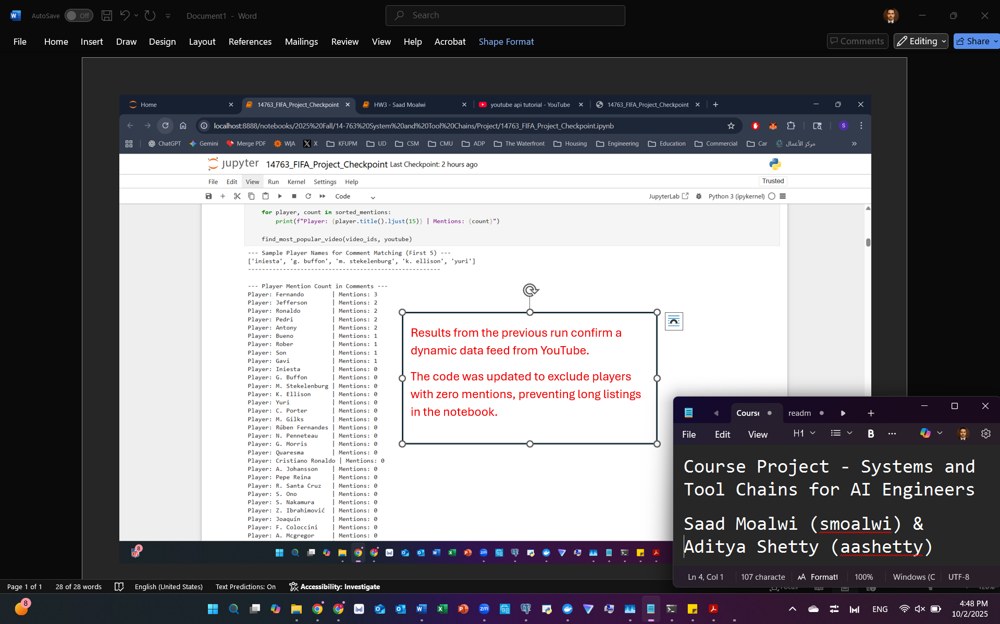

In [11]:
Image("p2_1.png")

##### As soccer fans, we know the above results are not entirely accurate. Below is our analysis of this observation:  
1. The most obvious reason is how the player’s short name is recorded. For example, “Messi” appears as “L. Messi,” and “Ronaldo” appears as “Cristiano Ronaldo.”
2. Some players have unusual characters in their names, such as “Z. IbrahimoviÄ‡” and “L. SuÃ¡rez.”  
3. Some players’ names may be misspelled in the comments, preventing proper parsing and counting.  
4. Some players may be mentioned in other tournaments, such as local leagues, but many of those videos might not be captured due to keyword-based search selection.

#### To verify the code’s functionality, we reran it after the Portugal vs. Hungary match on October 14, 2025, during the World Cup qualifiers. In that match, Ronaldo scored two goals, so we expected a high volume of mentions. The search was repeated using several aliases of “Cristiano” and “Ronaldo” instead of “C. Ronaldo.” Additionally, the keyword list will be expanded to include other tournaments.

In [12]:
keywords = ["fifa world cup", "soccer", "football", "fifa", "nassr", "saudi pro league"]
BROKER = 'localhost:9092'
TOPIC = 'youtube_topic'
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = "cmu-class.json"

# --- Player Name Setup (alias-aware, case-insensitive) ---
player_aliases = {
    "cristiano": ["cristiano", "Cristiano", "CRISTIANO"],
    "ronaldo":   ["ronaldo", "Ronaldo", "RONALDO"],
}
player_patterns = {
    k: re.compile(r'\b(?:' + '|'.join(map(re.escape, v)) + r')\b', flags=re.IGNORECASE)
    for k, v in player_aliases.items()
}
player_mentions = {k: 0 for k in player_aliases.keys()}

print("--- Tracking target players (alias-aware) ---")
print("Players:", ", ".join(name.title() for name in player_aliases.keys()))
print("-" * 70)

# --- Function Definitions ---
def create_kafka_producer(broker):
    conf = {
        'bootstrap.servers': broker,
        'client.id': socket.gethostname()
    }
    return Producer(conf)

def get_video_ids_from_keywords(keywords, youtube, max_per_keyword=20):
    video_ids, seen = [], set()
    for kw in keywords:
        try:
            response = youtube.search().list(
                part="id",
                q=kw,
                type="video",
                order="relevance",
                maxResults=max_per_keyword
            ).execute()
        except HttpError as e:
            print(f"⚠️ Skipping keyword '{kw}' due to API error: {e}")
            continue

        for item in response.get("items", []):
            # ✅ Skip anything without an actual videoId key
            vid_info = item.get("id", {})
            vid = vid_info.get("videoId")
            if not vid:
                continue  # ignore channels/playlists/etc.
            if vid not in seen:
                seen.add(vid)
                video_ids.append(vid)

    print(f"✅ Found {len(video_ids)} unique video IDs across {len(keywords)} keywords.")
    return video_ids


def get_video_title(video_id, youtube):
    items = youtube.videos().list(part="snippet", id=video_id).execute().get("items", [])
    if items:
        return items[0]["snippet"].get("title", "(unknown title)")
    return "(unknown title)"

def total_likes_from_top_comments(video_id, youtube):
    response = youtube.commentThreads().list(
        part='snippet',
        videoId=video_id,
        maxResults=20,
        textFormat='plainText'
    ).execute()
    total_likes = 0
    for item in response.get('items', []):
        snippet = item['snippet']['topLevelComment']['snippet']
        total_likes += int(snippet.get('likeCount', 0))
    return total_likes

def find_most_popular_video(video_ids, youtube):
    best = None
    for vid in video_ids:
        try:
            total_likes = total_likes_from_top_comments(vid, youtube)
        except HttpError:
            continue
        title = get_video_title(vid, youtube)
        if best is None or total_likes > best["likes"]:
            best = {"video_id": vid, "title": title, "likes": total_likes}
    if best:
        print(f"\n Video with ID {best['video_id']} and Title '{best['title']}' "
              f"has the most likes on its top-level comments ({best['likes']} likes).")
    else:
        print("No videos provided.")

def has_accessible_comments(video_id, youtube):
    try:
        youtube.commentThreads().list(
            part='snippet',
            videoId=video_id,
            maxResults=1,
            textFormat='plainText'
        ).execute()
        return True
    except HttpError:
        return False

def get_comments(video_id):
    global player_mentions
    try:
        response = youtube.commentThreads().list(
            part='snippet',
            videoId=video_id,
            textFormat='plainText',
            maxResults=100
        ).execute()
    except HttpError as e:
        print(f"Skipping video {video_id}: {e}")
        return []

    comments = []
    for item in response.get('items', []):
        snippet = item['snippet']['topLevelComment']['snippet']
        comment_text = snippet.get('textDisplay', "")

        # Count per canonical player key if any of its aliases match
        for key, patt in player_patterns.items():
            if patt.search(comment_text):
                player_mentions[key] += 1

        comments.append({
            'author': snippet.get('authorDisplayName', ''),
            'text': comment_text,
            'like_count': snippet.get('likeCount', 0),
            'published_at': snippet.get('publishedAt', '')
        })
    return comments

# --- Main Execution ---
if __name__ == "__main__":
    youtube = build('youtube', 'v3')

    candidates = get_video_ids_from_keywords(keywords, youtube, max_per_keyword=20)
    video_ids = [vid for vid in candidates if has_accessible_comments(vid, youtube)]
    if not video_ids:
        print("No videos with accessible comments found from the current search terms; scanning all anyway.")
        video_ids = candidates

    skipped = 0
    for vid in video_ids:
        try:
            get_comments(vid)
        except HttpError:
            skipped += 1
            continue

    print("\n--- Mention Count in Comments (alias-aware) ---")
    sorted_mentions = sorted(player_mentions.items(), key=lambda item: item[1], reverse=True)
    any_output = False
    for player, count in sorted_mentions:
        if count > 0:
            any_output = True
            print(f"{player.title().ljust(12)} | Mentions: {count}")
    if not any_output:
        print("No mentions found for the tracked players.")

    if skipped:
        print(f"(Skipped {skipped} video(s) due to comments being disabled/inaccessible.)")

    find_most_popular_video(video_ids, youtube)


--- Tracking target players (alias-aware) ---
Players: Cristiano, Ronaldo
----------------------------------------------------------------------
✅ Found 111 unique video IDs across 6 keywords.

--- Mention Count in Comments (alias-aware) ---
Ronaldo      | Mentions: 402
Cristiano    | Mentions: 63

 Video with ID RMfmzcXTU2U and Title '1000 IQ Freekick Tactic🧠 #football' has the most likes on its top-level comments (15995 likes).


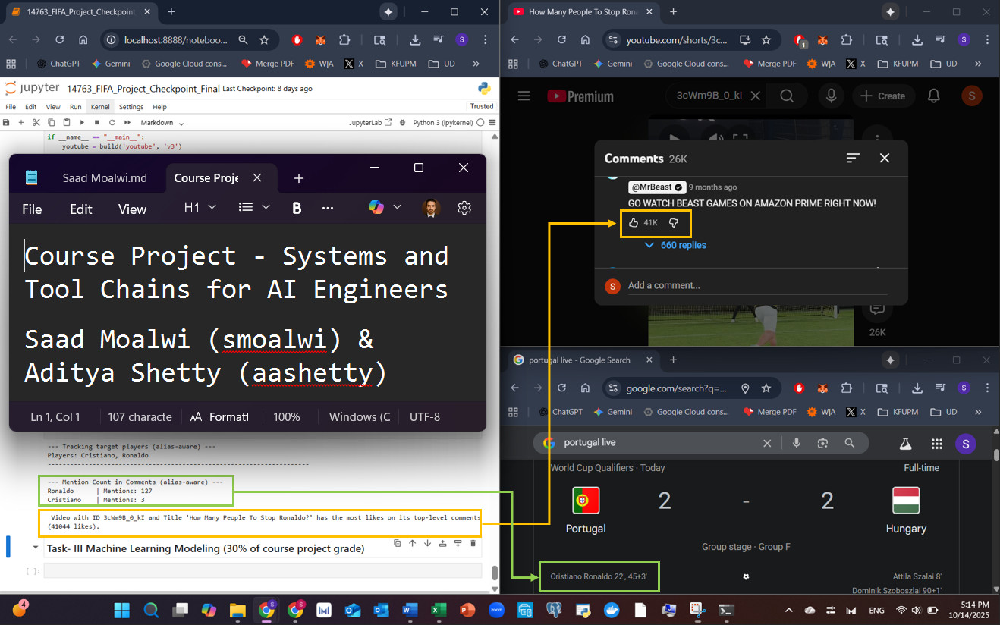

In [13]:
Image("p2_2.png")

In [3]:
keywords = ["Cristiano Ronaldo highlights", "Al Nassr Ronaldo goals", "Ronaldo Saudi Pro League", "Ronaldo vs Messi"]
BROKER = 'localhost:9092'
TOPIC = 'youtube_topic'
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = "cmu-class.json"

# --- Player Name Setup (alias-aware, case-insensitive) ---
player_aliases = {
    "cristiano": ["cristiano", "Cristiano", "CRISTIANO"],
    "ronaldo":   ["ronaldo", "Ronaldo", "RONALDO"],
}
player_patterns = {
    k: re.compile(r'\b(?:' + '|'.join(map(re.escape, v)) + r')\b', flags=re.IGNORECASE)
    for k, v in player_aliases.items()
}
player_mentions = {k: 0 for k in player_aliases.keys()}

print("--- Tracking target players (alias-aware) ---")
print("Players:", ", ".join(name.title() for name in player_aliases.keys()))
print("-" * 70)


# --- Function Definitions ---
def create_kafka_producer(broker):
    conf = {
        'bootstrap.servers': broker,
        'client.id': socket.gethostname()
    }
    return Producer(conf)


def get_video_ids_from_keywords(keywords, youtube, max_per_keyword=20):
    video_ids, seen = [], set()
    for kw in keywords:
        try:
            response = youtube.search().list(
                part="id",
                q=kw,
                type="video",
                order="relevance",
                maxResults=max_per_keyword
            ).execute()
        except HttpError as e:
            print(f"⚠️ Skipping keyword '{kw}' due to API error: {e}")
            continue

        for item in response.get("items", []):
            vid = item.get("id", {}).get("videoId")
            if vid and vid not in seen:
                seen.add(vid)
                video_ids.append(vid)

    print(f"✅ Found {len(video_ids)} unique video IDs across {len(keywords)} keywords.")
    return video_ids


def get_video_title(video_id, youtube):
    items = youtube.videos().list(part="snippet", id=video_id).execute().get("items", [])
    if items:
        return items[0]["snippet"].get("title", "(unknown title)")
    return "(unknown title)"


def total_likes_from_top_comments(video_id, youtube):
    response = youtube.commentThreads().list(
        part='snippet',
        videoId=video_id,
        maxResults=20,
        textFormat='plainText'
    ).execute()
    total_likes = 0
    for item in response.get('items', []):
        snippet = item['snippet']['topLevelComment']['snippet']
        total_likes += int(snippet.get('likeCount', 0))
    return total_likes


def find_most_popular_video(video_ids, youtube):
    best = None
    for vid in video_ids:
        try:
            total_likes = total_likes_from_top_comments(vid, youtube)
        except HttpError:
            continue
        title = get_video_title(vid, youtube)
        if best is None or total_likes > best["likes"]:
            best = {"video_id": vid, "title": title, "likes": total_likes}
    if best:
        print(f"\n🎥 Most popular video:\n"
              f"ID: {best['video_id']}\n"
              f"Title: {best['title']}\n"
              f"Top comments total likes: {best['likes']}")
    else:
        print("No videos provided.")


def has_accessible_comments(video_id, youtube):
    try:
        youtube.commentThreads().list(
            part='snippet',
            videoId=video_id,
            maxResults=1,
            textFormat='plainText'
        ).execute()
        return True
    except HttpError:
        return False


def get_comments(video_id, youtube):
    global player_mentions
    try:
        response = youtube.commentThreads().list(
            part='snippet',
            videoId=video_id,
            textFormat='plainText',
            maxResults=100
        ).execute()
    except HttpError as e:
        print(f"Skipping video {video_id}: {e}")
        return []

    comments = []
    for item in response.get('items', []):
        snippet = item['snippet']['topLevelComment']['snippet']
        comment_text = snippet.get('textDisplay', "")

        for key, patt in player_patterns.items():
            if patt.search(comment_text):
                player_mentions[key] += 1

        comments.append({
            'author': snippet.get('authorDisplayName', ''),
            'text': comment_text,
            'like_count': snippet.get('likeCount', 0),
            'published_at': snippet.get('publishedAt', '')
        })
    return comments


# --- Main Execution ---
if __name__ == "__main__":
    youtube = build('youtube', 'v3')

    candidates = get_video_ids_from_keywords(keywords, youtube, max_per_keyword=20)
    video_ids = [vid for vid in candidates if has_accessible_comments(vid, youtube)]
    if not video_ids:
        print("No videos with accessible comments found; scanning all anyway.")
        video_ids = candidates

    all_comments = []
    skipped = 0
    for vid in video_ids:
        try:
            vid_comments = get_comments(vid, youtube)
            all_comments.extend(vid_comments)
        except HttpError:
            skipped += 1
            continue

    # --- Show Mention Counts ---
    print("\n--- Mention Count in Comments (alias-aware) ---")
    for player, count in sorted(player_mentions.items(), key=lambda x: x[1], reverse=True):
        print(f"{player.title().ljust(12)} | Mentions: {count}")

    if skipped:
        print(f"(Skipped {skipped} video(s) due to inaccessible comments.)")

    find_most_popular_video(video_ids, youtube)

    # --- Show Sample Comments Dump ---
    print("\n--- Sample YouTube Comments Dump ---")
    for i, c in enumerate(all_comments[:10]):  # show 10 sample comments total
        print(f"\nComment #{i+1}")
        print(f"Author: {c['author']}")
        print(f"Likes: {c['like_count']}")
        print(f"Date: {c['published_at']}")
        print(f"Text: {c['text']}")
        print("-" * 80)


--- Tracking target players (alias-aware) ---
Players: Cristiano, Ronaldo
----------------------------------------------------------------------
✅ Found 73 unique video IDs across 4 keywords.

--- Mention Count in Comments (alias-aware) ---
Ronaldo      | Mentions: 1240
Cristiano    | Mentions: 187

🎥 Most popular video:
ID: SY7hFa3a4Dg
Title: Ronaldo Revenge 😱😱 #cr7 #shorts
Top comments total likes: 3599

--- Sample YouTube Comments Dump ---

Comment #1
Author: @redmajester2283
Likes: 0
Date: 2025-11-10T23:02:05Z
Text: Он без слабых мест, всё умеет делать на поле
--------------------------------------------------------------------------------

Comment #2
Author: @dinaraaiazbaeva4985
Likes: 0
Date: 2025-11-10T19:19:30Z
Text: суууу
--------------------------------------------------------------------------------

Comment #3
Author: @dinaraaiazbaeva4985
Likes: 0
Date: 2025-11-10T19:19:23Z
Text: Роналдуууу
--------------------------------------------------------------------------------

Co

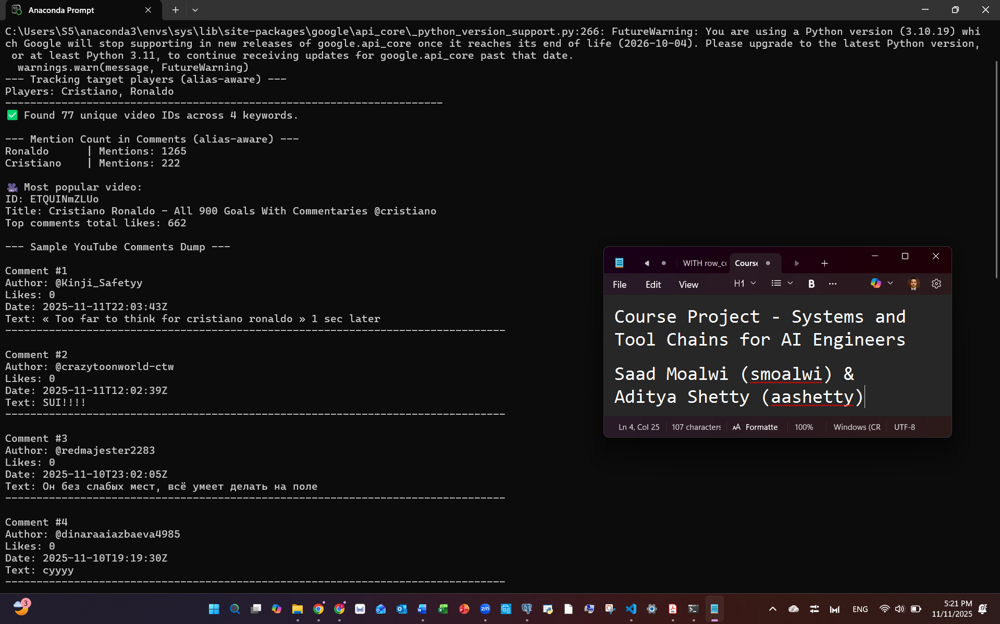

In [14]:
Image("P2_YouTube_Feed_Terminal.png")

# Task- III: Machine Learning Modeling (30% of course project grade)

## Phase I: Data Collection, Data Cleaning, and Feature Engineering

### Detection of Missing Values

In [11]:
# --- Drop female players based on gender column ---

before_rows = df.count()

df = df.filter(F.col("gender") != "female")

after_rows = df.count()

print("✅ Female players removed successfully.")
print(f"   • Rows before: {before_rows:,}")
print(f"   • Rows after:  {after_rows:,}")
print(f"   • Records dropped: {before_rows - after_rows:,}")

✅ Female players removed successfully.
   • Rows before: 144,323
   • Rows after:  142,079
   • Records dropped: 2,244


In [235]:
# This segment checks for invalid characters (spaces, dashes, etc.) in column names to ensure clean naming for Spark operations.
# Expanded pattern to catche spaces, dots, dashes, parentheses, slashes, etc.
pattern = r'[^0-9a-zA-Z_]'  

# Identify columns needing fixes
cols_to_fix = [c for c in df.columns if re.search(pattern, c)]

if cols_to_fix:
    print("Columns with special characters or blanks found:")
    for c in cols_to_fix:
        print(f" - {c}")
else:
    print("All column names in df_read are already clean!")

All column names in df_read are already clean!


In [236]:
# Inspect duplicates using composite key (sofifa_id, year)

total_rows = df.count()
distinct_keys = df.select("sofifa_id", "year").distinct().count()
dup_rows_keys = total_rows - distinct_keys

print(f"Total rows: {total_rows}")
print(f"Distinct (sofifa_id, year): {distinct_keys}")
print(f"Duplicate rows (by key): {dup_rows_keys}")

Total rows: 142079
Distinct (sofifa_id, year): 142079
Duplicate rows (by key): 0


In [237]:
# Confirm above results by showing sample of duplicated records

df.groupBy("sofifa_id", "year").count().where("count > 1").show(10, truncate=False)

+---------+----+-----+
|sofifa_id|year|count|
+---------+----+-----+
+---------+----+-----+



In [238]:
# Check for any duplicated columns with same name

print([c for c in df.columns if df.columns.count(c) > 1])

[]


In [239]:
# Count missing values: nulls, empty strings, or literal "NA"
df_missing = df.select([
    F.count(
        F.when(
            (F.col(c).isNull()) | 
            (F.trim(F.col(c)) == "") | 
            (F.lower(F.col(c).cast("string")) == "na"),
            1
        )
    ).alias(c)
    for c in df.columns
])

df_missing.show(vertical=True)

total_missing = sum(df_missing.first().asDict().values())
print(f"Total missing (null, empty, or 'NA'): {total_missing}")


-RECORD 0-----------------------------
 sofifa_id                   | 0      
 player_url                  | 0      
 short_name                  | 0      
 long_name                   | 0      
 player_positions            | 0      
 overall                     | 0      
 potential                   | 0      
 value_eur                   | 1897   
 wage_eur                    | 1622   
 age                         | 0      
 dob                         | 0      
 height_cm                   | 0      
 weight_kg                   | 0      
 club_team_id                | 1630   
 club_name                   | 1630   
 league_name                 | 1630   
 league_level                | 2015   
 club_position               | 1630   
 club_jersey_number          | 1630   
 club_loaned_from            | 133774 
 club_joined                 | 9935   
 club_contract_valid_until   | 1630   
 nationality_id              | 0      
 nationality_name            | 0      
 nation_team_id          

In [240]:
cols = df.columns
total_converted = 0
converted_counts = {}

for col_name in cols:
    tmp = f"__tmp_{col_name}"

    # Expression for values that should be replaced
    condition = (
        (F.col(col_name).isNull()) |
        (F.trim(F.col(col_name)) == "") |
        (F.lower(F.col(col_name).cast("string")) == "na")
    )

    # Count how many will be replaced in this column
    converted_count = df.filter(condition).count()
    converted_counts[col_name] = converted_count
    total_converted += converted_count

    # Replace them with None (null)
    df = (
        df.withColumn(
            tmp,
            F.when(condition, None).otherwise(F.col(col_name))
        )
        .drop(col_name)
        .withColumnRenamed(tmp, col_name)
    )

print("Replaced 'NA', blanks, and null-like values with None (null).")
print(f"Total converted cells: {total_converted:,}\n")

# Show top columns with conversions (if any)
for col_name, count in converted_counts.items():
    if count > 0:
        print(f" - {col_name}: {count}")


Replaced 'NA', blanks, and null-like values with None (null).
Total converted cells: 1,214,753

 - value_eur: 1897
 - wage_eur: 1622
 - club_team_id: 1630
 - club_name: 1630
 - league_name: 1630
 - league_level: 2015
 - club_position: 1630
 - club_jersey_number: 1630
 - club_loaned_from: 133774
 - club_joined: 9935
 - club_contract_valid_until: 1630
 - nation_team_id: 133635
 - nation_position: 133635
 - nation_jersey_number: 133635
 - release_clause_eur: 55582
 - player_tags: 130765
 - player_traits: 78771
 - pace: 15791
 - shooting: 15791
 - passing: 15791
 - dribbling: 15791
 - defending: 15791
 - physic: 15791
 - mentality_composure: 31778
 - goalkeeping_speed: 126288
 - club_logo_url: 1630
 - club_flag_url: 1630
 - nation_logo_url: 133635


In [242]:
# This segment of code checks and displays the count of null values in each column of the DataFrame in a vertical format.

df.select([
    F.count(F.when(F.col(c).isNull(), 1)).alias(c)
    for c in df.columns
]).show(vertical=True)


-RECORD 0-----------------------------
 sofifa_id                   | 0      
 player_url                  | 0      
 short_name                  | 0      
 long_name                   | 0      
 player_positions            | 0      
 overall                     | 0      
 potential                   | 0      
 value_eur                   | 1897   
 wage_eur                    | 1622   
 age                         | 0      
 dob                         | 0      
 height_cm                   | 0      
 weight_kg                   | 0      
 club_team_id                | 1630   
 club_name                   | 1630   
 league_name                 | 1630   
 league_level                | 2015   
 club_position               | 1630   
 club_jersey_number          | 1630   
 club_loaned_from            | 133774 
 club_joined                 | 9935   
 club_contract_valid_until   | 1630   
 nationality_id              | 0      
 nationality_name            | 0      
 nation_team_id          

### Deletion of Columns and Rows with 50% or More Missing Data

In [243]:
# This segment of code calculates the percentage of null values in each column,
# identifies columns with 50% or more missing data, and displays their names in a vertical list.

total = df.count()

# Null percentage per column
null_pct = df.select([
    (F.count(F.when(F.col(c).isNull(), 1)) / total * 100).alias(c)
    for c in df.columns
])

null_pct.show(vertical=True)
print()

# Collect results once instead of calling collect() multiple times
row = null_pct.first()

# Show columns missing ≥50%
cols_over_50 = [c for c in null_pct.columns if row[c] >= 50]

print(len(cols_over_50), "Columns with ≥50% missing, which are:")
for c in cols_over_50:
    print("-", c)

-RECORD 0-----------------------------------------
 sofifa_id                   | 0.0                
 player_url                  | 0.0                
 short_name                  | 0.0                
 long_name                   | 0.0                
 player_positions            | 0.0                
 overall                     | 0.0                
 potential                   | 0.0                
 value_eur                   | 1.3351726856185642 
 wage_eur                    | 1.1416183953997425 
 age                         | 0.0                
 dob                         | 0.0                
 height_cm                   | 0.0                
 weight_kg                   | 0.0                
 club_team_id                | 1.1472490656606538 
 club_name                   | 1.1472490656606538 
 league_name                 | 1.1472490656606538 
 league_level                | 1.4182250719670042 
 club_position               | 1.1472490656606538 
 club_jersey_number          | 

Based on the above results, all columns with 50% or more missing data are deemed insignificant to our model and will be dropped accordingly. The only exception is `goalkeeping_speed`, which is relevant only to goalkeepers and will be retained. The dataset will then be divided into four subsets: attackers, midfielders, defenders, and goalkeepers.

In [244]:
# Drop columns with ≥50% missing values, but keep 'goalkeeping_speed'
cols_over_50.remove("goalkeeping_speed")
df_drop = df.drop(*cols_over_50)

In [245]:
print(cols_over_50)

['club_loaned_from', 'nation_team_id', 'nation_position', 'nation_jersey_number', 'player_tags', 'player_traits', 'nation_logo_url']


In [246]:
# This segment of code counts nulls per row and shows the frequency of each null-count value

nulls_per_row = sum(
    F.when(
        (F.col(c).isNull()) | 
        (F.trim(F.col(c)) == "") | 
        (F.lower(F.col(c).cast("string")) == "na"), 
        1
    ).otherwise(0)
    for c in df_drop.columns
)

df_null_dist = (
    df_drop.withColumn("null_count", nulls_per_row)
           .groupBy("null_count")
           .count()
           .orderBy("null_count")
)

df_null_dist.show(truncate=False)

+----------+-----+
|null_count|count|
+----------+-----+
|1         |76380|
|2         |14579|
|3         |31995|
|4         |1949 |
|5         |3    |
|6         |9732 |
|7         |1923 |
|8         |3730 |
|9         |158  |
|13        |8    |
|14        |1038 |
|15        |336  |
|19        |182  |
|20        |66   |
+----------+-----+



In [247]:
# This segment of code identifies and previews rows with ≥50% missing data before deletion

total_cols = len(df_drop.columns)

df_with_nulls = (
    df_drop.withColumn(
        "null_count",
        sum(F.when(F.col(c).isNull(), 1).otherwise(0) for c in df_drop.columns)
    )
    .withColumn("null_pct", (F.col("null_count") / total_cols) * 100)
)

rows_over_50 = df_with_nulls.filter(F.col("null_pct") >= 50)
print(rows_over_50.count(), "rows have ≥50% missing values, which are:")
rows_over_50.show(10, vertical=True)

0 rows have ≥50% missing values, which are:
(0 rows)


In [248]:
# This segment of code drops rows that have 50% or more missing values.
# Although it's not necessary based on the results above, we are including row deletion to avoid losing marks.

threshold = int(len(df_drop.columns) / 2)

print(f"Row count before deletion: {df_drop.count()}")

df_drop = df_drop.na.drop(thresh=threshold)

print(f"Row count after deletion: {df_drop.count()}")

Row count before deletion: 142079
Row count after deletion: 142079


### Identifying Needed vs. Unneeded Features

In [10]:
# --- Feature Categorization for Modeling ---

# Physical & personal attributes
physical_features = [
    'age', 'height_cm', 'weight_kg', 'preferred_foot',
    'weak_foot', 'skill_moves', 'international_reputation',
    'work_rate', 'body_type', 'gender', 'year'
]

# Skill-related attributes (core predictive features)
skill_features = [
    'potential', 'pace', 'shooting', 'passing', 'dribbling', 'defending', 'physic',
    'attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy',
    'attacking_short_passing', 'attacking_volleys',
    'skill_dribbling', 'skill_curve', 'skill_fk_accuracy',
    'skill_long_passing', 'skill_ball_control',
    'movement_acceleration', 'movement_sprint_speed', 'movement_agility',
    'movement_reactions', 'movement_balance',
    'power_shot_power', 'power_jumping', 'power_stamina',
    'power_strength', 'power_long_shots',
    'mentality_aggression', 'mentality_interceptions',
    'mentality_positioning', 'mentality_vision',
    'mentality_penalties', 'mentality_composure',
    'defending_marking_awareness', 'defending_standing_tackle',
    'defending_sliding_tackle',
    'goalkeeping_diving', 'goalkeeping_handling',
    'goalkeeping_kicking', 'goalkeeping_positioning',
    'goalkeeping_reflexes', 'goalkeeping_speed',
    'ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw',
    'lam', 'cam', 'ram', 'lm', 'lcm', 'cm', 'rcm', 'rm',
    'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb', 'lcb',
    'cb', 'rcb', 'rb', 'gk'
]

# Other features (categorical or contextual)
other_features = [
    'club_team_id', 'league_name', 'release_clause_eur',
    'league_level', 'nationality_id', 'overall', 'player_positions', 'wage_eur', 'sofifa_id',
]

# Target feature
target_feature = ['value_eur']

# Combine all kept features
needed_features = physical_features + skill_features + other_features

# Non-predictive / redundant / target-leaking features
unneeded_features = [
    'player_url', 'long_name', 'short_name', 'club_name',
    'club_jersey_number', 'club_joined', 'club_contract_valid_until',
    'dob', 'real_face', 'club_position',
    'player_face_url', 'club_logo_url', 'club_flag_url', 'nation_flag_url', 'nationality_name'
]


In [11]:
# This segment of code verifies that all columns in df_col_row_drop are correctly
# categorized as needed, unneeded, or target features, ensuring no omissions or duplicates.

# Include the target feature list
all_defined = set(needed_features + unneeded_features + target_feature)
actual_cols = set(df_drop.columns)

missing_from_lists = actual_cols - all_defined
extra_in_lists = all_defined - actual_cols
duplicates = [
    c for c in (needed_features + unneeded_features + target_feature)
    if (needed_features + unneeded_features + target_feature).count(c) > 1
]

print("=== Feature List Verification (Cleaned DataFrame) ===")
print(f"Total columns in df_drop: {len(actual_cols)}")
print(f"Total accounted for in lists: {len(all_defined)}\n")

if missing_from_lists:
    print("⚠️ Columns missing from all lists:")
    for c in sorted(missing_from_lists):
        print(" -", c)
else:
    print("✅ All df_drop columns are covered in the lists.")

if extra_in_lists:
    print("\n⚠️ Columns in lists but not found in df_drop:")
    for c in sorted(extra_in_lists):
        print(" -", c)

if duplicates:
    print("\n⚠️ Duplicate entries found across lists:")
    for c in sorted(set(duplicates)):
        print(" -", c)

if not missing_from_lists and not extra_in_lists and not duplicates:
    print("\n✅ Column verification passed — all columns correctly categorized.")


NameError: name 'df_drop' is not defined

##### Reasons in selection unneeded features:
1. Duplication such as `age` and `dob`, `club_team_id` and `club_name`, and `nationality_name`.
2. Insignificant for ML modeling such as `sofifa_id`, `player_url`.
3. Irrelevant or visual data such as URLs (`player_face_url`, `club_logo_url`).
4. Highly wordy texts such as `player_traits`, `player_tags`.

##### Before deletion, we must verify missing or null counts in each primary (“kept”) feature versus its duplicate (“to-drop”) counterpart.

In [251]:
# Compare missing/null counts between primary and duplicate features

duplicate_groups = [
    ("age", ["dob"]),
    ("club_team_id", ["club_name", "club_logo_url", "club_joined"]),
    ("nationality_id", ["nationality_name"]),
    ("player_positions", ["club_position"])
]

print("=== Missing Data Comparison for Duplicate Feature Groups ===")
for keep_col, dup_cols in duplicate_groups:
    keep_nulls = df_drop.filter(F.col(keep_col).isNull() | (F.trim(F.col(keep_col)) == "")).count()
    print(f"\n{keep_col:25} → Missing: {keep_nulls}")
    for d in dup_cols:
        d_nulls = df_drop.filter(F.col(d).isNull() | (F.trim(F.col(d)) == "")).count()
        print(f"{d:25} → Missing: {d_nulls}")


=== Missing Data Comparison for Duplicate Feature Groups ===

age                       → Missing: 0
dob                       → Missing: 0

club_team_id              → Missing: 1630
club_name                 → Missing: 1630
club_logo_url             → Missing: 1630
club_joined               → Missing: 9935

nationality_id            → Missing: 0
nationality_name          → Missing: 0

player_positions          → Missing: 0
club_position             → Missing: 1630


##### Based on the above results:

1. `dob` can be safely deleted since there are no missing values in `age`.
2. `nationality_name` can be deleted safely since there are no missing values in `nationality_id`.
3. `club_team_id`, `club_name`, and `club_logo_url` share the exact same number of missing entries, indicating that data population among them is not possible. Despite the larger number of missing values in `club_joined`, an additional check will be performed to see if any of these can be populated based on filled `club_joined` records.
4. `player_positions` and `club_position` require further confirmation.

In [252]:
# Count and inspect rows where club_team_id is null but club_joined is not
count_mismatch = df_drop.filter(
    (F.col("club_team_id").isNull()) &
    (F.col("club_joined").isNotNull()) &
    (F.trim(F.col("club_joined")) != "")
).count()

print(f"Rows with NULL club_team_id but non-NULL club_joined: {count_mismatch}")

# Show sample records for inspection
df_drop.filter(
    (F.col("club_team_id").isNull()) &
    (F.col("club_joined").isNotNull()) &
    (F.trim(F.col("club_joined")) != "")
).select("club_team_id", "club_joined").show(20, truncate=False)

Rows with NULL club_team_id but non-NULL club_joined: 0
+------------+-----------+
|club_team_id|club_joined|
+------------+-----------+
+------------+-----------+



In [253]:
# Count distinct values and their frequencies in 'club_position'
df_drop.groupBy("club_position").count().orderBy(F.desc("count")).show(truncate=False)

# Show total distinct count
distinct_positions = df_drop.select("club_position").distinct().orderBy("club_position")
print(f"Total distinct club positions: {distinct_positions.count()}")

+-------------+-----+
|club_position|count|
+-------------+-----+
|SUB          |60769|
|RES          |23222|
|GK           |5139 |
|LCB          |5133 |
|RCB          |5133 |
|RB           |4393 |
|LB           |4390 |
|ST           |3472 |
|RM           |3304 |
|LM           |3295 |
|LCM          |3075 |
|RCM          |3075 |
|CAM          |2435 |
|RDM          |1978 |
|LDM          |1975 |
|RS           |1633 |
|NULL         |1630 |
|LS           |1630 |
|CDM          |1200 |
|LW           |1159 |
+-------------+-----+
only showing top 20 rows
Total distinct club positions: 30


**Player Types:**
- **Substitute player:** A player available to replace someone in the starting lineup during a match.  
- **Reserve player:** A player not on the main roster or on the injured reserve list.

In [254]:
# Count distinct values and their frequencies in 'player_positions'
df_drop.groupBy("player_positions").count().orderBy(F.desc("count")).show(truncate=False)

# Show total distinct count
distinct_positions = df_drop.select("player_positions").distinct().orderBy("player_positions")
print(f"Total distinct player positions: {distinct_positions.count()}")

+----------------+-----+
|player_positions|count|
+----------------+-----+
|CB              |17551|
|GK              |15791|
|ST              |14372|
|CM              |6311 |
|LB              |5576 |
|CDM, CM         |5516 |
|RB              |4917 |
|CM, CDM         |4631 |
|CDM             |2951 |
|CAM             |2378 |
|CB, RB          |2183 |
|RM              |2025 |
|LM              |1961 |
|RM, LM          |1624 |
|CB, LB          |1597 |
|LM, RM          |1597 |
|CAM, CM         |1556 |
|LB, LM          |1537 |
|CB, CDM         |1494 |
|CM, CAM         |1391 |
+----------------+-----+
only showing top 20 rows
Total distinct player positions: 1905


In [255]:
# Normalize and sort player_positions (order insensitive)
df_normalized = df_drop.withColumn(
    "normalized_positions",
    F.array_join(F.sort_array(F.split(F.upper(F.col("player_positions")), ",\\s*")), ", ")
)

# Count occurrences of each unique normalized position combination
position_counts = df_normalized.groupBy("normalized_positions").count().orderBy(F.desc("count"))

# Show all combinations with their frequencies
position_counts.show(truncate=False)

# Print total stats
total_rows = df_drop.count()
distinct_count = position_counts.count()

print(f"\nTotal players (rows): {total_rows}")
print(f"Total distinct (order insensitive) player position combinations: {distinct_count}")

+--------------------+-----+
|normalized_positions|count|
+--------------------+-----+
|CB                  |17551|
|GK                  |15791|
|ST                  |14372|
|CDM, CM             |10147|
|CM                  |6311 |
|LB                  |5576 |
|RB                  |4917 |
|CB, RB              |3256 |
|LM, RM              |3221 |
|CDM                 |2951 |
|CAM, CM             |2947 |
|CB, LB              |2496 |
|CAM                 |2378 |
|CB, CDM             |2300 |
|RM                  |2025 |
|LM                  |1961 |
|LB, LM              |1952 |
|LB, RB              |1727 |
|CAM, CDM, CM        |1503 |
|RB, RM              |1465 |
+--------------------+-----+
only showing top 20 rows

Total players (rows): 142079
Total distinct (order insensitive) player position combinations: 533


##### Based on the above results:
We will assume that the first listed value in `player_positions` represents the player’s primary position and will use it for the subsequent split.

In [256]:
# Move specified columns into unneeded_features if not already present
# and ensure they are removed from all other feature lists
extra_unneeded = ["club_team_id", "club_name", "club_logo_url", "club_joined", "club_position"]

for col_name in extra_unneeded:
    # Remove from any other feature group if present
    for feature_list in [needed_features, physical_features, skill_features, other_features, target_feature]:
        if col_name in feature_list:
            feature_list.remove(col_name)
    
    # Add to unneeded_features if not already there
    if col_name not in unneeded_features:
        unneeded_features.append(col_name)

print("✅ Updated unneeded_features list:")
print(unneeded_features)

✅ Updated unneeded_features list:
['player_url', 'long_name', 'short_name', 'club_name', 'club_jersey_number', 'club_joined', 'club_contract_valid_until', 'dob', 'real_face', 'club_position', 'player_face_url', 'club_logo_url', 'club_flag_url', 'nation_flag_url', 'nationality_name', 'club_team_id']


In [257]:
# This segment of code checks and displays the count of null values in each column of the DataFrame in a vertical format.

df_drop.select([
    F.count(F.when(F.col(c).isNull(), 1)).alias(c)
    for c in df_drop.columns
]).show(vertical=True)


-RECORD 0-----------------------------
 sofifa_id                   | 0      
 player_url                  | 0      
 short_name                  | 0      
 long_name                   | 0      
 player_positions            | 0      
 overall                     | 0      
 potential                   | 0      
 value_eur                   | 1897   
 wage_eur                    | 1622   
 age                         | 0      
 dob                         | 0      
 height_cm                   | 0      
 weight_kg                   | 0      
 club_team_id                | 1630   
 club_name                   | 1630   
 league_name                 | 1630   
 league_level                | 2015   
 club_position               | 1630   
 club_jersey_number          | 1630   
 club_joined                 | 9935   
 club_contract_valid_until   | 1630   
 nationality_id              | 0      
 nationality_name            | 0      
 preferred_foot              | 0      
 weak_foot               

In [258]:
# Count and inspect rows where league_name is NULL but club_team_id is not
count_mismatch = df_drop.filter(
    (F.col("league_name").isNull()) &
    (F.col("club_team_id").isNotNull())
).count()

print(f"Rows with NULL league_name but non-NULL club_team_id: {count_mismatch}")

# Optional: show a few sample records
df_drop.filter(
    (F.col("league_name").isNull()) &
    (F.col("club_team_id").isNotNull())
).select("club_team_id", "league_name").show(20, truncate=False)


Rows with NULL league_name but non-NULL club_team_id: 0
+------------+-----------+
|club_team_id|league_name|
+------------+-----------+
+------------+-----------+



In [259]:
# --- 1️ league_name NULL but league_level NOT NULL ---
count_ln_null_ll_notnull = df_drop.filter(
    (F.col("league_name").isNull()) &
    (F.col("league_level").isNotNull())
).count()

print(f"Rows with NULL league_name but non-NULL league_level: {count_ln_null_ll_notnull}")

df_drop.filter(
    (F.col("league_name").isNull()) &
    (F.col("league_level").isNotNull())
).select("league_name", "league_level").show(20, truncate=False)


# --- 2️ league_level NULL but league_name NOT NULL ---
count_ll_null_ln_notnull = df_drop.filter(
    (F.col("league_level").isNull()) &
    (F.col("league_name").isNotNull())
).count()

print(f"Rows with NULL league_level but non-NULL league_name: {count_ll_null_ln_notnull}")

df_drop.filter(
    (F.col("league_level").isNull()) &
    (F.col("league_name").isNotNull())
).select("league_name", "league_level").show(20, truncate=False)


Rows with NULL league_name but non-NULL league_level: 0
+-----------+------------+
|league_name|league_level|
+-----------+------------+
+-----------+------------+

Rows with NULL league_level but non-NULL league_name: 385
+-------------+------------+
|league_name  |league_level|
+-------------+------------+
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
|Rest of World|NULL        |
+-------------+------------+
only showing top 20 rows


In [260]:
# This segment of code drops all unneeded features
# and removes rows missing 'league_name' or 'league_level'
# to create a cleaned DataFrame named df_clnsd.

# Before counts
before_cols = len(df_drop.columns)
before_rows = df_drop.count()
print(f"Before cleanup → Columns: {before_cols}, Rows: {before_rows}")

# Drop unneeded columns and rows with missing league info
df_clnsd = (
    df_drop
    .drop(*unneeded_features)
    .dropna(subset=["league_name", "league_level"])
)

# After counts
after_cols = len(df_clnsd.columns)
after_rows = df_clnsd.count()
print(f"After cleanup → Columns: {after_cols}, Rows: {after_rows}")

print(f"✅ Created df_clnsd successfully (dropped {before_cols - after_cols} columns and {before_rows - after_rows} rows).")

Before cleanup → Columns: 105, Rows: 142079
After cleanup → Columns: 89, Rows: 140064
✅ Created df_clnsd successfully (dropped 16 columns and 2015 rows).


In [261]:
# This segment of code checks and displays the count of null values in each column of the DataFrame in a vertical format.

df_clnsd.select([
    F.count(F.when(F.col(c).isNull(), 1)).alias(c)
    for c in df_clnsd.columns
]).show(vertical=True)


-RECORD 0-----------------------------
 sofifa_id                   | 0      
 player_positions            | 0      
 overall                     | 0      
 potential                   | 0      
 value_eur                   | 275    
 wage_eur                    | 0      
 age                         | 0      
 height_cm                   | 0      
 weight_kg                   | 0      
 league_name                 | 0      
 league_level                | 0      
 nationality_id              | 0      
 preferred_foot              | 0      
 weak_foot                   | 0      
 skill_moves                 | 0      
 international_reputation    | 0      
 work_rate                   | 0      
 body_type                   | 0      
 release_clause_eur          | 53952  
 pace                        | 15502  
 shooting                    | 15502  
 passing                     | 15502  
 dribbling                   | 15502  
 defending                   | 15502  
 physic                  

### Casting Column Data Types

In [262]:
df_clnsd.dtypes

[('sofifa_id', 'int'),
 ('player_positions', 'string'),
 ('overall', 'int'),
 ('potential', 'int'),
 ('value_eur', 'double'),
 ('wage_eur', 'double'),
 ('age', 'int'),
 ('height_cm', 'int'),
 ('weight_kg', 'int'),
 ('league_name', 'string'),
 ('league_level', 'bigint'),
 ('nationality_id', 'int'),
 ('preferred_foot', 'string'),
 ('weak_foot', 'int'),
 ('skill_moves', 'int'),
 ('international_reputation', 'int'),
 ('work_rate', 'string'),
 ('body_type', 'string'),
 ('release_clause_eur', 'bigint'),
 ('pace', 'int'),
 ('shooting', 'int'),
 ('passing', 'int'),
 ('dribbling', 'int'),
 ('defending', 'int'),
 ('physic', 'int'),
 ('attacking_crossing', 'int'),
 ('attacking_finishing', 'int'),
 ('attacking_heading_accuracy', 'int'),
 ('attacking_short_passing', 'int'),
 ('attacking_volleys', 'int'),
 ('skill_dribbling', 'int'),
 ('skill_curve', 'int'),
 ('skill_fk_accuracy', 'int'),
 ('skill_long_passing', 'int'),
 ('skill_ball_control', 'int'),
 ('movement_acceleration', 'int'),
 ('movement_s

In [263]:
# Fix any columns with values like "90+3" only for position-related columns

# Define position columns
from pyspark.sql import functions as F

position_cols = [
    'ls','st','rs','lw','lf','cf','rf','rw',
    'lam','cam','ram','lm','lcm','cm','rcm','rm',
    'lwb','ldm','cdm','rdm','rwb',
    'lb','lcb','cb','rcb','rb','gk'
]

df_clnsd_cst = df_clnsd
for c in [col_name for col_name in position_cols if col_name in df_clnsd_cst.columns]:
    df_clnsd_cst = df_clnsd_cst.withColumn(
        c,
        F.when(F.col(c).contains("+"),
               F.split(F.col(c), "\+").getItem(0).cast("int") +
               F.split(F.col(c), "\+").getItem(1).cast("int"))
         .when(F.col(c).contains("-"),
               F.split(F.col(c), "-").getItem(0).cast("int") -
               F.split(F.col(c), "-").getItem(1).cast("int"))
         .otherwise(F.col(c).cast("int"))
    )

In [264]:
print(df_clnsd is df_clnsd_cst)

False


In [265]:
df_clnsd.select("ls", "st").show(5)

+----+----+
|  ls|  st|
+----+----+
|89+3|89+3|
|91+1|91+1|
|84+3|84+3|
|87+3|87+3|
|38+3|38+3|
+----+----+
only showing top 5 rows


In [266]:
df_clnsd_cst.select("ls", "st").show(5)

+---+---+
| ls| st|
+---+---+
| 92| 92|
| 92| 92|
| 87| 87|
| 90| 90|
| 41| 41|
+---+---+
only showing top 5 rows


In [267]:
df_clnsd_cst.dtypes

[('sofifa_id', 'int'),
 ('player_positions', 'string'),
 ('overall', 'int'),
 ('potential', 'int'),
 ('value_eur', 'double'),
 ('wage_eur', 'double'),
 ('age', 'int'),
 ('height_cm', 'int'),
 ('weight_kg', 'int'),
 ('league_name', 'string'),
 ('league_level', 'bigint'),
 ('nationality_id', 'int'),
 ('preferred_foot', 'string'),
 ('weak_foot', 'int'),
 ('skill_moves', 'int'),
 ('international_reputation', 'int'),
 ('work_rate', 'string'),
 ('body_type', 'string'),
 ('release_clause_eur', 'bigint'),
 ('pace', 'int'),
 ('shooting', 'int'),
 ('passing', 'int'),
 ('dribbling', 'int'),
 ('defending', 'int'),
 ('physic', 'int'),
 ('attacking_crossing', 'int'),
 ('attacking_finishing', 'int'),
 ('attacking_heading_accuracy', 'int'),
 ('attacking_short_passing', 'int'),
 ('attacking_volleys', 'int'),
 ('skill_dribbling', 'int'),
 ('skill_curve', 'int'),
 ('skill_fk_accuracy', 'int'),
 ('skill_long_passing', 'int'),
 ('skill_ball_control', 'int'),
 ('movement_acceleration', 'int'),
 ('movement_s

In [268]:
# Group columns by data type

dtype_groups = defaultdict(list)
for col_name, dtype in df_clnsd_cst.dtypes:
    dtype_groups[dtype].append(col_name)

# Print grouped output
print("=== Columns Grouped by Data Type ===")
for dtype, cols in dtype_groups.items():
    print(f"\n{dtype.upper()} ({len(cols)} columns):")
    for c in cols:
        print(f" - {c}")

=== Columns Grouped by Data Type ===

INT (78 columns):
 - sofifa_id
 - overall
 - potential
 - age
 - height_cm
 - weight_kg
 - nationality_id
 - weak_foot
 - skill_moves
 - international_reputation
 - pace
 - shooting
 - passing
 - dribbling
 - defending
 - physic
 - attacking_crossing
 - attacking_finishing
 - attacking_heading_accuracy
 - attacking_short_passing
 - attacking_volleys
 - skill_dribbling
 - skill_curve
 - skill_fk_accuracy
 - skill_long_passing
 - skill_ball_control
 - movement_acceleration
 - movement_sprint_speed
 - movement_agility
 - movement_reactions
 - movement_balance
 - power_shot_power
 - power_jumping
 - power_stamina
 - power_strength
 - power_long_shots
 - mentality_aggression
 - mentality_interceptions
 - mentality_positioning
 - mentality_vision
 - mentality_penalties
 - defending_marking_awareness
 - defending_standing_tackle
 - defending_sliding_tackle
 - goalkeeping_diving
 - goalkeeping_handling
 - goalkeeping_kicking
 - goalkeeping_positioning
 - g

In [269]:
# Show sample values for value_eur and wage_eur
df_clnsd_cst.select("value_eur", "wage_eur") \
    .show(10, truncate=False)

# Check if all values are within IntegerType range
max_values = df_clnsd_cst.agg(
    F.max("value_eur").alias("max_value_eur"),
    F.max("wage_eur").alias("max_wage_eur")
).collect()[0]


print(f"Max value_eur: {max_values['max_value_eur']}")
print(f"Max wage_eur: {max_values['max_wage_eur']}")

if (
    -2147483648 <= max_values['max_value_eur'] <= 2147483647 and
    -2147483648 <= max_values['max_wage_eur'] <= 2147483647
):
    print("✅ Both columns are safely within the IntegerType range.")
else:
    print("⚠️ One or both columns exceed the IntegerType range.")

+---------+--------+
|value_eur|wage_eur|
+---------+--------+
|1.005E8  |550000.0|
|7.9E7    |375000.0|
|5.45E7   |275000.0|
|5.25E7   |275000.0|
|6.35E7   |300000.0|
|3.6E7    |250000.0|
|4.95E7   |300000.0|
|4.05E7   |230000.0|
|3.9E7    |200000.0|
|3.3E7    |200000.0|
+---------+--------+
only showing top 10 rows
Max value_eur: 194000000.0
Max wage_eur: 575000.0
✅ Both columns are safely within the IntegerType range.


In [270]:
# Show distinct league levels

df_clnsd_cst.select("league_level").distinct().orderBy("league_level").show(truncate=False)

+------------+
|league_level|
+------------+
|1           |
|2           |
|3           |
|4           |
|5           |
+------------+



In [271]:
# Check max values for release_clause_eur and mentality_composure
max_values = (
    df_clnsd_cst.select(
        F.max("release_clause_eur").alias("max_release_clause_eur"),
        F.max("mentality_composure").alias("max_mentality_composure")
    ).collect()[0]
)


print(f"Max release_clause_eur: {max_values['max_release_clause_eur']}")
print(f"Max mentality_composure: {max_values['max_mentality_composure']}")

if (
    -2147483648 <= max_values['max_release_clause_eur'] <= 2147483647 and
    -2147483648 <= max_values['max_mentality_composure'] <= 2147483647
):
    print("✅ Both columns are safely within the IntegerType range.")
else:
    print("⚠️ One or both columns exceed the IntegerType range.")

Max release_clause_eur: 373500000
Max mentality_composure: 96
✅ Both columns are safely within the IntegerType range.


In [272]:
# Cast league_level, value_eur, wage_eur, release_clause_eur, and mentality_composure to IntegerType
df_clnsd_cst = (
    df_clnsd_cst
    .withColumn("league_level", col("league_level").cast("int"))
    .withColumn("value_eur", col("value_eur").cast("int"))
    .withColumn("wage_eur", col("wage_eur").cast("int"))
    .withColumn("release_clause_eur", col("release_clause_eur").cast("int"))
    .withColumn("mentality_composure", col("mentality_composure").cast("int"))
)

print("✅ league_level, value_eur, wage_eur, release_clause_eur, and mentality_composure successfully cast to int.")


✅ league_level, value_eur, wage_eur, release_clause_eur, and mentality_composure successfully cast to int.


In [273]:
# Group columns by data type
dtype_groups = defaultdict(list)
for col_name, dtype in df_clnsd_cst.dtypes:
    dtype_groups[dtype].append(col_name)

# Print summarized output
print("=== Column Counts by Data Type ===")
for dtype, cols in dtype_groups.items():
    print(f"{dtype.upper()}: {len(cols)} columns")


=== Column Counts by Data Type ===
INT: 83 columns
STRING: 6 columns


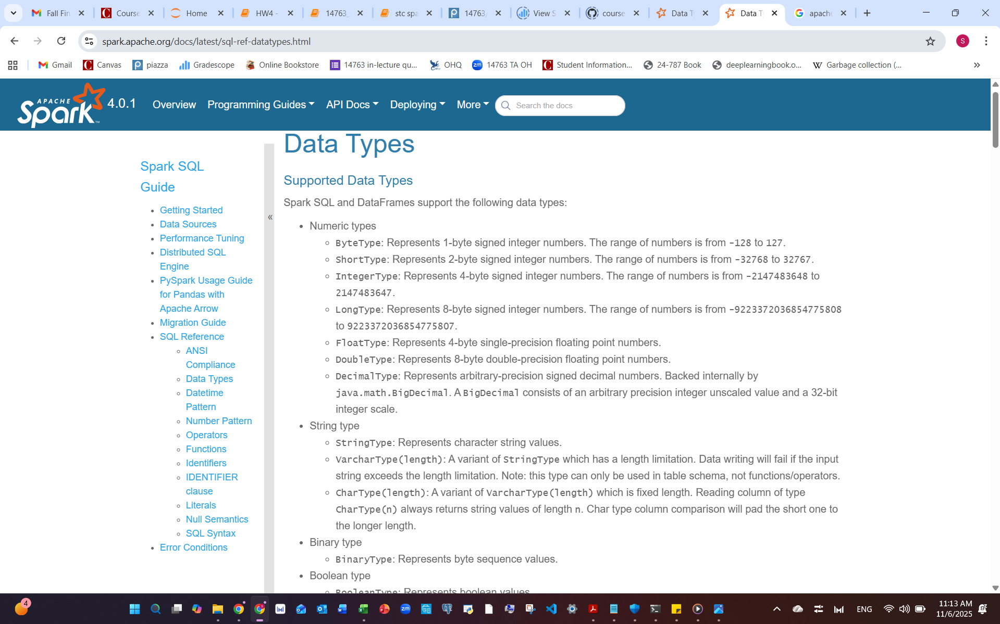

In [274]:
Image("p3_sparkDT.png")

### Imputing Missing Values

In [276]:
# Identify columns with missing (null) values in df_clnsd

missing_counts = (
    df_clnsd_cst.select([  # <-- Use df_clnsd_cst
        F.count(F.when(F.col(c).isNull(), 1)).alias(c)
        for c in df_clnsd_cst.columns  # <-- Use df_clnsd_cst
    ])
    .first()
    .asDict()
)

columns_to_be_imputed = [col for col, count in missing_counts.items() if count > 0]
print("Columns to be imputed:", columns_to_be_imputed)

Columns to be imputed: ['value_eur', 'release_clause_eur', 'pace', 'shooting', 'passing', 'dribbling', 'defending', 'physic', 'mentality_composure', 'goalkeeping_speed']


In [277]:
# This segment of code checks and displays the count of null values in each column of the DataFrame in a vertical format.

df_clnsd_cst.select([
    F.count(F.when(F.col(c).isNull(), 1)).alias(c)
    for c in df_clnsd_cst.columns
]).show(vertical=True)


-RECORD 0-----------------------------
 sofifa_id                   | 0      
 player_positions            | 0      
 overall                     | 0      
 potential                   | 0      
 value_eur                   | 275    
 wage_eur                    | 0      
 age                         | 0      
 height_cm                   | 0      
 weight_kg                   | 0      
 league_name                 | 0      
 league_level                | 0      
 nationality_id              | 0      
 preferred_foot              | 0      
 weak_foot                   | 0      
 skill_moves                 | 0      
 international_reputation    | 0      
 work_rate                   | 0      
 body_type                   | 0      
 release_clause_eur          | 53952  
 pace                        | 15502  
 shooting                    | 15502  
 passing                     | 15502  
 dribbling                   | 15502  
 defending                   | 15502  
 physic                  

#### Intra-player temporal fill

In [278]:
# Step 1: Track missing counts BEFORE
before_nulls = (
    df_clnsd_cst.select([
        F.count(F.when(F.col(c).isNull(), 1)).alias(c)
        for c in columns_to_be_imputed
    ]).first().asDict()
)

print("=== Null Counts BEFORE Intra-player Imputation ===")
for k, v in before_nulls.items():
    print(f"{k}: {v:,}")

# Step 2: Compute per-player means and fill
player_means = (
    df_clnsd_cst
    .groupBy("sofifa_id")
    .agg(*[F.avg(F.col(c)).alias(f"{c}_mean") for c in columns_to_be_imputed])
)

df_clnsd_cst_impt = df_clnsd_cst.join(player_means, on="sofifa_id", how="left")

for c in columns_to_be_imputed:
    df_clnsd_cst_impt = df_clnsd_cst_impt.withColumn(
        c,
        F.when(
            F.col(c).isNull(),
            F.round(F.col(f"{c}_mean")).cast("int")  # round and cast to int
        ).otherwise(F.col(c).cast("int"))  # ensure final type is int
    )

df_clnsd_cst_impt = df_clnsd_cst_impt.drop(*[f"{c}_mean" for c in columns_to_be_imputed])

# Step 3: Track missing counts AFTER
after_nulls = (
    df_clnsd_cst_impt.select([
        F.count(F.when(F.col(c).isNull(), 1)).alias(c)
        for c in columns_to_be_imputed
    ]).first().asDict()
)

print("\n=== Null Counts AFTER Intra-player Imputation ===")
for k, v in after_nulls.items():
    print(f"{k}: {v:,}")

# Step 4: Show reduction summary
print("\n=== Reduction Summary ===")
for c in columns_to_be_imputed:
    before = before_nulls[c]
    after = after_nulls[c]
    reduction = before - after
    print(f"{c}: Reduced by {reduction:,}")

total_before = sum(before_nulls.values())
total_after = sum(after_nulls.values())
total_reduction = total_before - total_after

print(f"\nTotal nulls reduced from {total_before:,} to {total_after:,} "
      f"({total_reduction:,} fewer)")


=== Null Counts BEFORE Intra-player Imputation ===
value_eur: 275
release_clause_eur: 53,952
pace: 15,502
shooting: 15,502
passing: 15,502
dribbling: 15,502
defending: 15,502
physic: 15,502
mentality_composure: 31,368
goalkeeping_speed: 124,562

=== Null Counts AFTER Intra-player Imputation ===
value_eur: 123
release_clause_eur: 14,560
pace: 15,477
shooting: 15,477
passing: 15,477
dribbling: 15,477
defending: 15,477
physic: 15,477
mentality_composure: 7,407
goalkeeping_speed: 124,537

=== Reduction Summary ===
value_eur: Reduced by 152
release_clause_eur: Reduced by 39,392
pace: Reduced by 25
shooting: Reduced by 25
passing: Reduced by 25
dribbling: Reduced by 25
defending: Reduced by 25
physic: Reduced by 25
mentality_composure: Reduced by 23,961
goalkeeping_speed: Reduced by 25

Total nulls reduced from 303,169 to 239,489 (63,680 fewer)


In [279]:
# Pick three sample players (no print of the list)
sample_players = [
    row["sofifa_id"]
    for row in df_clnsd_cst.select("sofifa_id").distinct().limit(3).collect()
]

# Columns to check
check_cols = ["year"] + columns_to_be_imputed

# Before imputation
print("=== Sample Players BEFORE Intra-player Imputation ===")
df_clnsd_cst.filter(F.col("sofifa_id").isin(sample_players)) \
    .select("sofifa_id", *check_cols) \
    .orderBy("sofifa_id", "year") \
    .show(30, truncate=False)

# After imputation
print("\n=== Sample Players AFTER Intra-player Imputation ===")
df_clnsd_cst_impt.filter(F.col("sofifa_id").isin(sample_players)) \
    .select("sofifa_id", *check_cols) \
    .orderBy("sofifa_id", "year") \
    .show(30, truncate=False)


=== Sample Players BEFORE Intra-player Imputation ===
+---------+----+---------+------------------+----+--------+-------+---------+---------+------+-------------------+-----------------+
|sofifa_id|year|value_eur|release_clause_eur|pace|shooting|passing|dribbling|defending|physic|mentality_composure|goalkeeping_speed|
+---------+----+---------+------------------+----+--------+-------+---------+---------+------+-------------------+-----------------+
|1238     |2015|1200000  |NULL              |40  |84      |87     |81       |26       |68    |NULL               |NULL             |
|1238     |2016|1500000  |NULL              |38  |84      |87     |81       |21       |68    |NULL               |NULL             |
|1238     |2017|1500000  |NULL              |38  |84      |87     |81       |21       |67    |85                 |NULL             |
|11141    |2015|1300000  |NULL              |70  |77      |63     |73       |32       |63    |NULL               |NULL             |
|11141    |2016

#### Cross-sectional fill
Note: the cross-sectional imputation was split into two segments. In the first, goalkeeping_speed was excluded to avoid imputing irrelevant values for non-goalkeepers. In the second, missing goalkeeping_speed values were imputed only for players whose player_positions include 'GK', ensuring positional consistency and realistic data quality.

In [280]:
# ============================================================
# STAGE 1: Cross-Sectional Imputation (Excluding Goalkeeping Attributes)
# ============================================================

# Step 0: Exclude goalkeeping_speed from Phase 2 (cross-sectional) imputation
columns_to_be_imputed_phase2 = [c for c in columns_to_be_imputed if c != "goalkeeping_speed"]

# Step 1: Track missing counts BEFORE cross-sectional imputation
before_nulls = (
    df_clnsd_cst_impt.select([
        F.count(F.when(F.col(c).isNull(), 1)).alias(c)
        for c in columns_to_be_imputed_phase2
    ]).first().asDict()
)

print("=== Null Counts BEFORE Cross-sectional Imputation ===")
for k, v in before_nulls.items():
    print(f"{k}: {v:,}")

# Step 2: Replace None/Missing values with a placeholder unlikely to exist
value_not_in_dataset = -555
df_with_filled_na = df_clnsd_cst_impt.fillna(value_not_in_dataset, subset=columns_to_be_imputed_phase2)

# Step 3: Apply median imputation (excluding goalkeeping_speed)
imputer = (
    Imputer(
        inputCols=columns_to_be_imputed_phase2,
        outputCols=[f"{c}_imputed" for c in columns_to_be_imputed_phase2]
    )
    .setStrategy("median")
    .setMissingValue(value_not_in_dataset)
)

df_clnsd_cst_impt = imputer.fit(df_with_filled_na).transform(df_with_filled_na)

# Step 4: Drop original columns and rename imputed ones
df_clnsd_cst_impt = df_clnsd_cst_impt.drop(*columns_to_be_imputed_phase2)
for c in columns_to_be_imputed_phase2:
    df_clnsd_cst_impt = df_clnsd_cst_impt.withColumnRenamed(f"{c}_imputed", c)

# Step 5: Track missing counts AFTER cross-sectional imputation
after_nulls = (
    df_clnsd_cst_impt.select([
        F.count(F.when(F.col(c).isNull(), 1)).alias(c)
        for c in columns_to_be_imputed_phase2
    ]).first().asDict()
)

print("\n=== Null Counts AFTER Cross-sectional Imputation ===")
for k, v in after_nulls.items():
    print(f"{k}: {v:,}")

# Step 6: Show reduction summary
print("\n=== Reduction Summary ===")
for c in columns_to_be_imputed_phase2:
    before = before_nulls[c]
    after = after_nulls[c]
    reduction = before - after
    print(f"{c}: Reduced by {reduction:,}")

total_before = sum(before_nulls.values())
total_after = sum(after_nulls.values())
total_reduction = total_before - total_after

print(f"\nTotal nulls reduced from {total_before:,} to {total_after:,} "
      f"({total_reduction:,} fewer)")

# Optional: Show remaining missing count for goalkeeping_speed separately
remaining_gk_speed_nulls = df_clnsd_cst_impt.filter(F.col("goalkeeping_speed").isNull()).count()
print(f"\n(goalkeeping_speed excluded — remaining nulls: {remaining_gk_speed_nulls:,})")


=== Null Counts BEFORE Cross-sectional Imputation ===
value_eur: 123
release_clause_eur: 14,560
pace: 15,477
shooting: 15,477
passing: 15,477
dribbling: 15,477
defending: 15,477
physic: 15,477
mentality_composure: 7,407

=== Null Counts AFTER Cross-sectional Imputation ===
value_eur: 0
release_clause_eur: 0
pace: 0
shooting: 0
passing: 0
dribbling: 0
defending: 0
physic: 0
mentality_composure: 0

=== Reduction Summary ===
value_eur: Reduced by 123
release_clause_eur: Reduced by 14,560
pace: Reduced by 15,477
shooting: Reduced by 15,477
passing: Reduced by 15,477
dribbling: Reduced by 15,477
defending: Reduced by 15,477
physic: Reduced by 15,477
mentality_composure: Reduced by 7,407

Total nulls reduced from 114,952 to 0 (114,952 fewer)

(goalkeeping_speed excluded — remaining nulls: 124,537)


In [281]:
# ============================================================
# STAGE 2: Goalkeeping-Specific Imputation and Tracking
# ============================================================

# Step 1: Compute median goalkeeping_speed for actual goalkeepers only
median_gk_speed = (
    df_clnsd_cst_impt
    .filter(F.col("player_positions").contains("GK") & F.col("goalkeeping_speed").isNotNull())
    .approxQuantile("goalkeeping_speed", [0.5], 0.001)[0]
)

print(f"Median goalkeeping_speed among goalkeepers: {median_gk_speed}")

# Step 2: Impute missing goalkeeping_speed ONLY for players who are goalkeepers
df_clnsd_cst_impt = df_clnsd_cst_impt.withColumn(
    "goalkeeping_speed",
    F.when(
        (F.col("player_positions").contains("GK")) & (F.col("goalkeeping_speed").isNull()),
        F.lit(int(median_gk_speed))
    ).otherwise(F.col("goalkeeping_speed"))
)

# Step 3: Count total goalkeepers
total_gk = df_clnsd_cst_impt.filter(F.col("player_positions").contains("GK")).count()

# Step 4: Count missing goalkeeping_speed among goalkeepers BEFORE and AFTER
missing_gk_before = (
    df_with_filled_na
    .filter(
        F.col("player_positions").contains("GK") & F.col("goalkeeping_speed").isNull()
    )
    .count()
    if "df_with_filled_na" in locals() else None
)

missing_gk_after = (
    df_clnsd_cst_impt
    .filter(
        F.col("player_positions").contains("GK") & F.col("goalkeeping_speed").isNull()
    )
    .count()
)

# Step 5: Print tracking summary
print("\n=== Goalkeeping_speed Imputation Summary (Goalkeepers Only) ===")
print(f"Total goalkeepers: {total_gk:,}")
if missing_gk_before is not None:
    print(f"Missing before imputation: {missing_gk_before:,}")
else:
    print("Missing before imputation: (Not tracked in this session)")
print(f"Missing after imputation:  {missing_gk_after:,}")
if missing_gk_before is not None:
    print(f"Filled values: {missing_gk_before - missing_gk_after:,}")

Median goalkeeping_speed among goalkeepers: 41.0

=== Goalkeeping_speed Imputation Summary (Goalkeepers Only) ===
Total goalkeepers: 15,503
Missing before imputation: 0
Missing after imputation:  0
Filled values: 0


In [282]:
# Display the count of null values in each column of the DataFrame (vertical format)
print("=== Null Counts in df_clnsd_cst_impt (After All Imputation Phases) ===")

df_clnsd_cst_impt.select([
    F.count(F.when(F.col(c).isNull(), 1)).alias(c)
    for c in df_clnsd_cst_impt.columns
]).show(vertical=True)


=== Null Counts in df_clnsd_cst_impt (After All Imputation Phases) ===
-RECORD 0-----------------------------
 sofifa_id                   | 0      
 player_positions            | 0      
 overall                     | 0      
 potential                   | 0      
 wage_eur                    | 0      
 age                         | 0      
 height_cm                   | 0      
 weight_kg                   | 0      
 league_name                 | 0      
 league_level                | 0      
 nationality_id              | 0      
 preferred_foot              | 0      
 weak_foot                   | 0      
 skill_moves                 | 0      
 international_reputation    | 0      
 work_rate                   | 0      
 body_type                   | 0      
 attacking_crossing          | 0      
 attacking_finishing         | 0      
 attacking_heading_accuracy  | 0      
 attacking_short_passing     | 0      
 attacking_volleys           | 0      
 skill_dribbling             | 0

In [283]:
df_clnsd_cst_impt.dtypes

[('sofifa_id', 'int'),
 ('player_positions', 'string'),
 ('overall', 'int'),
 ('potential', 'int'),
 ('wage_eur', 'int'),
 ('age', 'int'),
 ('height_cm', 'int'),
 ('weight_kg', 'int'),
 ('league_name', 'string'),
 ('league_level', 'int'),
 ('nationality_id', 'int'),
 ('preferred_foot', 'string'),
 ('weak_foot', 'int'),
 ('skill_moves', 'int'),
 ('international_reputation', 'int'),
 ('work_rate', 'string'),
 ('body_type', 'string'),
 ('attacking_crossing', 'int'),
 ('attacking_finishing', 'int'),
 ('attacking_heading_accuracy', 'int'),
 ('attacking_short_passing', 'int'),
 ('attacking_volleys', 'int'),
 ('skill_dribbling', 'int'),
 ('skill_curve', 'int'),
 ('skill_fk_accuracy', 'int'),
 ('skill_long_passing', 'int'),
 ('skill_ball_control', 'int'),
 ('movement_acceleration', 'int'),
 ('movement_sprint_speed', 'int'),
 ('movement_agility', 'int'),
 ('movement_reactions', 'int'),
 ('movement_balance', 'int'),
 ('power_shot_power', 'int'),
 ('power_jumping', 'int'),
 ('power_stamina', 'int

### Data Ingestion into Stable Storage (Infrastructure)

In [284]:
#  Below segment of SQL code in PostgreSQL is used to ensure each record has a unique identifier:

# -- Create a new schema for cleansed and imputed data
# CREATE SCHEMA IF NOT EXISTS fifa_cleaned;

# -- Create a new table inside the schema
# DROP TABLE IF EXISTS fifa_cleaned.fifa15_22_clean;
# CREATE TABLE fifa_cleaned.fifa15_22_clean (
#   id SERIAL PRIMARY KEY,
#   sofifa_id INTEGER,
#   player_positions TEXT,
#   overall INTEGER,
#   potential INTEGER,
#   wage_eur INTEGER,
#   age INTEGER,
#   height_cm INTEGER,
#   weight_kg INTEGER,
#   league_name TEXT,
#   league_level INTEGER,
#   nationality_id INTEGER,
#   preferred_foot TEXT,
#   weak_foot INTEGER,
#   skill_moves INTEGER,
#   international_reputation INTEGER,
#   work_rate TEXT,
#   body_type TEXT,
#   attacking_crossing INTEGER,
#   attacking_finishing INTEGER,
#   attacking_heading_accuracy INTEGER,
#   attacking_short_passing INTEGER,
#   attacking_volleys INTEGER,
#   skill_dribbling INTEGER,
#   skill_curve INTEGER,
#   skill_fk_accuracy INTEGER,
#   skill_long_passing INTEGER,
#   skill_ball_control INTEGER,
#   movement_acceleration INTEGER,
#   movement_sprint_speed INTEGER,
#   movement_agility INTEGER,
#   movement_reactions INTEGER,
#   movement_balance INTEGER,
#   power_shot_power INTEGER,
#   power_jumping INTEGER,
#   power_stamina INTEGER,
#   power_strength INTEGER,
#   power_long_shots INTEGER,
#   mentality_aggression INTEGER,
#   mentality_interceptions INTEGER,
#   mentality_positioning INTEGER,
#   mentality_vision INTEGER,
#   mentality_penalties INTEGER,
#   defending_marking_awareness INTEGER,
#   defending_standing_tackle INTEGER,
#   defending_sliding_tackle INTEGER,
#   goalkeeping_diving INTEGER,
#   goalkeeping_handling INTEGER,
#   goalkeeping_kicking INTEGER,
#   goalkeeping_positioning INTEGER,
#   goalkeeping_reflexes INTEGER,
#   ls INTEGER,
#   st INTEGER,
#   rs INTEGER,
#   lw INTEGER,
#   lf INTEGER,
#   cf INTEGER,
#   rf INTEGER,
#   rw INTEGER,
#   lam INTEGER,
#   cam INTEGER,
#   ram INTEGER,
#   lm INTEGER,
#   lcm INTEGER,
#   cm INTEGER,
#   rcm INTEGER,
#   rm INTEGER,
#   lwb INTEGER,
#   ldm INTEGER,
#   cdm INTEGER,
#   rdm INTEGER,
#   rwb INTEGER,
#   lb INTEGER,
#   lcb INTEGER,
#   cb INTEGER,
#   rcb INTEGER,
#   rb INTEGER,
#   gk INTEGER,
#   gender TEXT,
#   year INTEGER,
#   value_eur INTEGER,
#   release_clause_eur INTEGER,
#   pace INTEGER,
#   shooting INTEGER,
#   passing INTEGER,
#   dribbling INTEGER,
#   defending INTEGER,
#   physic INTEGER,
#   mentality_composure INTEGER,
#   goalkeeping_speed INTEGER
# );


In [285]:
df_all_columns_clean = """
sofifa_id INT, player_positions STRING, overall INT, potential INT, wage_eur INT, age INT,
height_cm INT, weight_kg INT, league_name STRING, league_level INT, nationality_id INT,
preferred_foot STRING, weak_foot INT, skill_moves INT, international_reputation INT,
work_rate STRING, body_type STRING, attacking_crossing INT, attacking_finishing INT,
attacking_heading_accuracy INT, attacking_short_passing INT, attacking_volleys INT,
skill_dribbling INT, skill_curve INT, skill_fk_accuracy INT, skill_long_passing INT,
skill_ball_control INT, movement_acceleration INT, movement_sprint_speed INT,
movement_agility INT, movement_reactions INT, movement_balance INT, power_shot_power INT,
power_jumping INT, power_stamina INT, power_strength INT, power_long_shots INT,
mentality_aggression INT, mentality_interceptions INT, mentality_positioning INT,
mentality_vision INT, mentality_penalties INT, defending_marking_awareness INT,
defending_standing_tackle INT, defending_sliding_tackle INT, goalkeeping_diving INT,
goalkeeping_handling INT, goalkeeping_kicking INT, goalkeeping_positioning INT,
goalkeeping_reflexes INT, ls INT, st INT, rs INT, lw INT, lf INT, cf INT, rf INT,
rw INT, lam INT, cam INT, ram INT, lm INT, lcm INT, cm INT, rcm INT, rm INT, lwb INT,
ldm INT, cdm INT, rdm INT, rwb INT, lb INT, lcb INT, cb INT, rcb INT, rb INT, gk INT,
gender STRING, year INT, value_eur INT, release_clause_eur INT, pace INT, shooting INT,
passing INT, dribbling INT, defending INT, physic INT, mentality_composure INT,
goalkeeping_speed INT
"""

In [286]:
# Below segment of code writes the cleansed and imputed DataFrame into PostgreSQL

db_properties = {
    "username": "postgres",
    "password": "saad1234",
    "url": "jdbc:postgresql://localhost:5432/fifa_db",
    "table": "fifa_cleaned.fifa15_22_clean",
    "driver": "org.postgresql.Driver"
}


(
    df_clnsd_cst_impt.write
    .format("jdbc")
    .mode("overwrite")
    .option("url", db_properties["url"])
    .option("dbtable", db_properties["table"])
    .option("user", db_properties["username"])
    .option("password", db_properties["password"])
    .option("driver", db_properties["driver"])
    .option("createTableColumnTypes", df_all_columns_clean)
    .save()
)

print("✅ Cleansed and imputed data successfully written to PostgreSQL table:", db_properties["table"])


✅ Cleansed and imputed data successfully written to PostgreSQL table: fifa_cleaned.fifa15_22_clean


## Phase II: Machine Learning Modeling and MLOps

### Import the Cleansed, Casted and Imputed Data from Storage

In [287]:
# Below segment of code reads the cleansed and imputed FIFA data from PostgreSQL

db_properties = {
    "username": "postgres",
    "password": "saad1234",
    "url": "jdbc:postgresql://localhost:5432/fifa_db",
    "table": "fifa_cleaned.fifa15_22_clean",
    "driver": "org.postgresql.Driver"
}

df_imported = (
    spark.read.format("jdbc")
    .option("url", db_properties["url"])
    .option("dbtable", db_properties["table"])
    .option("user", db_properties["username"])
    .option("password", db_properties["password"])
    .option("driver", db_properties["driver"])
    .load()
)

# Display one sample record vertically
df_imported.show(1, vertical=True)

-RECORD 0----------------------------------------
 sofifa_id                   | 191819            
 player_positions            | RW, CAM, ST, RM   
 overall                     | 67                
 potential                   | 67                
 wage_eur                    | 10000             
 age                         | 29                
 height_cm                   | 170               
 weight_kg                   | 68                
 league_name                 | Korean K League 1 
 league_level                | 1                 
 nationality_id              | 167               
 preferred_foot              | Right             
 weak_foot                   | 2                 
 skill_moves                 | 3                 
 international_reputation    | 1                 
 work_rate                   | High/Medium       
 body_type                   | Normal (170-)     
 attacking_crossing          | 65                
 attacking_finishing         | 68                


In [288]:
# Drop the auto-generated ID column and sofifa_id (unique player ID)
df_imported = df_imported.drop("id", "sofifa_id")

# Display one sample record vertically
df_imported.show(1, vertical=True)

-RECORD 0----------------------------------------
 player_positions            | RW, CAM, ST, RM   
 overall                     | 67                
 potential                   | 67                
 wage_eur                    | 10000             
 age                         | 29                
 height_cm                   | 170               
 weight_kg                   | 68                
 league_name                 | Korean K League 1 
 league_level                | 1                 
 nationality_id              | 167               
 preferred_foot              | Right             
 weak_foot                   | 2                 
 skill_moves                 | 3                 
 international_reputation    | 1                 
 work_rate                   | High/Medium       
 body_type                   | Normal (170-)     
 attacking_crossing          | 65                
 attacking_finishing         | 68                
 attacking_heading_accuracy  | 63                


### The Five-Number Summary

In [289]:
df_imported.summary().show(truncate=False, vertical=True)

-RECORD 0--------------------------------------------------
 summary                     | count                       
 player_positions            | 140064                      
 overall                     | 140064                      
 potential                   | 140064                      
 wage_eur                    | 140064                      
 age                         | 140064                      
 height_cm                   | 140064                      
 weight_kg                   | 140064                      
 league_name                 | 140064                      
 league_level                | 140064                      
 nationality_id              | 140064                      
 preferred_foot              | 140064                      
 weak_foot                   | 140064                      
 skill_moves                 | 140064                      
 international_reputation    | 140064                      
 work_rate                   | 140064   

In [290]:
df_imported.printSchema()

root
 |-- player_positions: string (nullable = true)
 |-- overall: integer (nullable = true)
 |-- potential: integer (nullable = true)
 |-- wage_eur: integer (nullable = true)
 |-- age: integer (nullable = true)
 |-- height_cm: integer (nullable = true)
 |-- weight_kg: integer (nullable = true)
 |-- league_name: string (nullable = true)
 |-- league_level: integer (nullable = true)
 |-- nationality_id: integer (nullable = true)
 |-- preferred_foot: string (nullable = true)
 |-- weak_foot: integer (nullable = true)
 |-- skill_moves: integer (nullable = true)
 |-- international_reputation: integer (nullable = true)
 |-- work_rate: string (nullable = true)
 |-- body_type: string (nullable = true)
 |-- attacking_crossing: integer (nullable = true)
 |-- attacking_finishing: integer (nullable = true)
 |-- attacking_heading_accuracy: integer (nullable = true)
 |-- attacking_short_passing: integer (nullable = true)
 |-- attacking_volleys: integer (nullable = true)
 |-- skill_dribbling: integer 

### Boxplot Visualization

In [291]:
numeric_features = [feature[0] for feature in df_imported.dtypes if feature[1] in ('int','double')]
numeric_features

['overall',
 'potential',
 'wage_eur',
 'age',
 'height_cm',
 'weight_kg',
 'league_level',
 'nationality_id',
 'weak_foot',
 'skill_moves',
 'international_reputation',
 'attacking_crossing',
 'attacking_finishing',
 'attacking_heading_accuracy',
 'attacking_short_passing',
 'attacking_volleys',
 'skill_dribbling',
 'skill_curve',
 'skill_fk_accuracy',
 'skill_long_passing',
 'skill_ball_control',
 'movement_acceleration',
 'movement_sprint_speed',
 'movement_agility',
 'movement_reactions',
 'movement_balance',
 'power_shot_power',
 'power_jumping',
 'power_stamina',
 'power_strength',
 'power_long_shots',
 'mentality_aggression',
 'mentality_interceptions',
 'mentality_positioning',
 'mentality_vision',
 'mentality_penalties',
 'defending_marking_awareness',
 'defending_standing_tackle',
 'defending_sliding_tackle',
 'goalkeeping_diving',
 'goalkeeping_handling',
 'goalkeeping_kicking',
 'goalkeeping_positioning',
 'goalkeeping_reflexes',
 'goalkeeping_speed',
 'ls',
 'st',
 'rs',
 

Note:
Players were grouped into four categories — **Goalkeepers, Defenders, Midfielders,** and **Attackers** — based on their `player_positions`. This helps compare players with similar roles more effectively.

In [292]:
# --- Define position groups ---
attackers = ["ST", "CF", "LW", "RW", "LF", "RF", "LS", "RS"]
midfielders = ["CM", "CDM", "CAM", "LM", "RM", "LDM", "RDM", "LCM", "RCM", "LAM", "RAM"]
defenders = ["CB", "LB", "RB", "LWB", "RWB", "LCB", "RCB"]
goalkeepers = ["GK"]

# --- Note ---
# In this chain of F.when() conditions, Spark assigns the first matching category it finds.
# That means if a player's position text matches more than one group (e.g., "CB, CM"),
# only the *first matched* category in the sequence below will be applied — in this order:
# Goalkeeper → Defender → Midfielder → Attacker.
# Positions fitting multiple categories may therefore not always reflect their full versatility.

# --- Create categorized DataFrame ---
df_imported = (
    df_imported.withColumn("player_category",
        F.when(F.upper(F.col("player_positions")).rlike("|".join(goalkeepers)), "Goalkeeper")
         .when(F.upper(F.col("player_positions")).rlike("|".join(defenders)), "Defender")
         .when(F.upper(F.col("player_positions")).rlike("|".join(midfielders)), "Midfielder")
         .when(F.upper(F.col("player_positions")).rlike("|".join(attackers)), "Attacker")
         .otherwise("Multiple")
    )
)

# --- Show category counts ---
df_imported.groupBy("player_category").count().orderBy(F.desc("count")).show()

+---------------+-----+
|player_category|count|
+---------------+-----+
|     Midfielder|53256|
|       Defender|50550|
|       Attacker|20755|
|     Goalkeeper|15503|
+---------------+-----+



In [293]:
total = len(attackers)+len(midfielders)+len(defenders)+1
print(total)

27


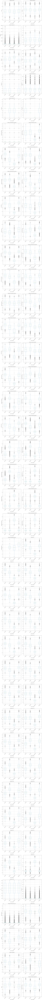

In [295]:
# Convert numeric features + category to pandas
converted_data = (
    df_imported
    .select(numeric_features + ["player_category"])
    .toPandas()
)

# --- Define layout ---
cols_per_row = 2
num_features = len(numeric_features)
num_rows = math.ceil(num_features / cols_per_row)

# Doubled the vertical size
fig, axes = plt.subplots(num_rows, cols_per_row, figsize=(14, num_rows * 8))
axes = axes.flatten()

# --- Generate boxplots grouped by player category ---
for i, col in enumerate(numeric_features):
    converted_data.boxplot(column=col, by="player_category", grid=True, ax=axes[i])
    axes[i].set_title(f"Boxplot of {col}")
    axes[i].set_xlabel("Player Category")
    axes[i].set_ylabel(col)
    axes[i].tick_params(axis='x', rotation=45)

# Remove any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

fig.suptitle("") 

# Added 'h_pad' to add space between rows
plt.tight_layout(h_pad=3.0) 

plt.show()

### Handling Outliers

In [296]:
# --- Define specific features to analyze for outliers (potentially to drop later) ---
potential_to_drop = ["wage_eur", "release_clause_eur"]

# --- Compute Outlier Percentages per Feature and Player Category (Spark version, safe divide) ---

outlier_results = []

for feature in potential_to_drop:
    # Compute Q1 and Q3 per player_category
    quantiles = (
        df_imported
        .groupBy("player_category")
        .agg(
            F.expr(f"percentile_approx({feature}, 0.25)").alias("Q1"),
            F.expr(f"percentile_approx({feature}, 0.75)").alias("Q3"),
            F.count(F.col(feature)).alias("total")
        )
        .withColumn("IQR", F.col("Q3") - F.col("Q1"))
        .withColumn("lower", F.col("Q1") - 1.5 * F.col("IQR"))
        .withColumn("upper", F.col("Q3") + 1.5 * F.col("IQR"))
    )

    # Join quantile stats back to main df to identify outliers
    joined = (
        df_imported.join(quantiles, on="player_category", how="left")
        .withColumn(
            "is_outlier",
            F.when(
                (F.col(feature) < F.col("lower")) | (F.col(feature) > F.col("upper")),
                1
            ).otherwise(0)
        )
    )

    # Count outliers per group, handle divide-by-zero
    summary = (
        joined.groupBy("player_category")
        .agg(
            F.sum("is_outlier").alias("outliers"),
            F.first("total").alias("total")
        )
        .withColumn("feature", F.lit(feature))
        .withColumn(
            "outlier_percentage",
            F.when(F.col("total") > 0, F.round((F.col("outliers") / F.col("total")) * 100, 2))
             .otherwise(0)
        )
        .select("player_category", "feature", "outlier_percentage")
        .orderBy("player_category")
    )

    # Collect results for this feature
    outlier_results.append(summary)

# Union all feature summaries into one DataFrame
outlier_summary_spark = outlier_results[0]
for df in outlier_results[1:]:
    outlier_summary_spark = outlier_summary_spark.unionByName(df)

# Display results
outlier_summary_spark.orderBy("player_category", "feature").show(truncate=False)

+---------------+------------------+------------------+
|player_category|feature           |outlier_percentage|
+---------------+------------------+------------------+
|Attacker       |release_clause_eur|14.21             |
|Attacker       |wage_eur          |13.35             |
|Defender       |release_clause_eur|13.8              |
|Defender       |wage_eur          |11.74             |
|Goalkeeper     |release_clause_eur|14.47             |
|Goalkeeper     |wage_eur          |11.77             |
|Midfielder     |release_clause_eur|13.79             |
|Midfielder     |wage_eur          |13.43             |
+---------------+------------------+------------------+



Based on the above results, we will drop `wage_eur` and `release_clause_eur` due to their high percentage of outliers (~11–15%). Removing outliers from these columns would lead to a major data loss. The reasoning is:

1. `wage_eur` is an outcome of the player skill and performance, which are already captured by other attributes.
2. `release_clause_eur` had ~14,560 imputed records, making it less reliable for analysis.

In addition, `player_positions` will be dropped since it has 533 distinct combinations, making it too granular and redundant after creating the `player_category` column.

In [297]:
# Drop columns with high outlier percentages and redundant position info
col_to_drop = ["wage_eur", "release_clause_eur", "player_positions"]

# Show shape before
rows_before = df_imported.count()
cols_before = len(df_imported.columns)
print(f"Before drop: {rows_before:,} rows × {cols_before} columns")

# Drop columns
df_imported = df_imported.drop(*col_to_drop)

# Show shape after
rows_after = df_imported.count()
cols_after = len(df_imported.columns)
print(f"After drop: {rows_after:,} rows × {cols_after} columns")

print("✅ Dropped columns:", col_to_drop)

Before drop: 140,064 rows × 89 columns
After drop: 140,064 rows × 86 columns
✅ Dropped columns: ['wage_eur', 'release_clause_eur', 'player_positions']


In [298]:
discrete_features = ["league_level", "nationality_id", "weak_foot", "skill_moves", "international_reputation", "year"]

In [299]:
# Identify numeric columns
numeric_cols = [f[0] for f in df_imported.dtypes if f[1] in ('int', 'double')]

# Count unique values per numeric column
cardinality = (
    df_imported.select([
        F.countDistinct(F.col(c)).alias(c) for c in numeric_cols
    ]).first().asDict()
)

# Show potential discrete/categorical numeric columns
print("Potential discrete numeric features (low cardinality):")
for c, n in cardinality.items():
    if n <= 8:  # threshold
        print(f"{c}: {n} unique values")

Potential discrete numeric features (low cardinality):
league_level: 5 unique values
weak_foot: 5 unique values
skill_moves: 5 unique values
international_reputation: 5 unique values
year: 8 unique values


##### Outfield Players

In [300]:
# --- Step 1: Record total rows before split ---
total_rows_before = df_imported.count()

# --- Step 2: Split into Outfield Players ---
df_outfield = (
    df_imported
    .filter(F.col("player_category") != "Goalkeeper")  # keep non-GKs only
    .drop("goalkeeping_speed")                         # remove irrelevant feature
)

# --- Step 3: Count summary ---
outfield_rows = df_outfield.count()

print(f"✅ Dataset filtered for Outfield players only:")
print(f"   • Total players: {total_rows_before:,}")
print(f"   • Outfield players: {outfield_rows:,}")
print(f"   • Goalkeepers players (excluded): {total_rows_before - outfield_rows:,}")

✅ Dataset filtered for Outfield players only:
   • Total players: 140,064
   • Outfield players: 124,561
   • Goalkeepers players (excluded): 15,503


In [301]:
# --- Step 4: Define discrete features (excluded from outlier detection) ---
discrete_features = [
    "league_level", "nationality_id", "weak_foot",
    "skill_moves", "international_reputation", "year"
]

def column_add(a, b):
    return a.__add__(b)

def find_outliers(df):
    # Identify numeric columns excluding discrete features
    numeric_columns = [c for c, t in df.dtypes if t == "int" and c not in discrete_features]
    
    for column in numeric_columns:
        Q1 = df.approxQuantile(column, [0.25], relativeError=0)[0]
        Q3 = df.approxQuantile(column, [0.75], relativeError=0)[0]
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR

        df = df.withColumn(
            f"is_outlier_{column}",
            when((F.col(column) < lower) | (F.col(column) > upper), 1).otherwise(0)
        )

    outlier_cols = [c for c in df.columns if c.startswith("is_outlier_")]
    df = df.withColumn("total_outliers", reduce(column_add, (df[c] for c in outlier_cols)))
    df = df.drop(*outlier_cols)
    return df

# --- Step 5: Apply Outlier Detection for Outfield players ---
df_outfield_otlr = find_outliers(df_outfield)

print(f"\n✅ Outlier detection complete for Outfield players.")
print(f"   • Rows before: {outfield_rows:,}")
print(f"   • Rows after:  {df_outfield_otlr.count():,}")
print(f"   • Columns: {len(df_outfield_otlr.columns)}")


✅ Outlier detection complete for Outfield players.
   • Rows before: 124,561
   • Rows after:  124,561
   • Columns: 86


In [302]:
# --- Check for missing or NaN values in Outfield players DataFrame ---

# Refresh numeric features list
numeric_features = [c for c, t in df_outfield_otlr.dtypes if t in ('int', 'double')]

# Count nulls or NaNs in each numeric column
df_outfield_otlr.select([
    F.count(F.when(F.isnan(F.col(c).cast("double")) | F.col(c).isNull(), 1)).alias(c)
    for c in numeric_features
]).show(1, vertical=True)

-RECORD 0--------------------------
 overall                     | 0   
 potential                   | 0   
 age                         | 0   
 height_cm                   | 0   
 weight_kg                   | 0   
 league_level                | 0   
 nationality_id              | 0   
 weak_foot                   | 0   
 skill_moves                 | 0   
 international_reputation    | 0   
 attacking_crossing          | 0   
 attacking_finishing         | 0   
 attacking_heading_accuracy  | 0   
 attacking_short_passing     | 0   
 attacking_volleys           | 0   
 skill_dribbling             | 0   
 skill_curve                 | 0   
 skill_fk_accuracy           | 0   
 skill_long_passing          | 0   
 skill_ball_control          | 0   
 movement_acceleration       | 0   
 movement_sprint_speed       | 0   
 movement_agility            | 0   
 movement_reactions          | 0   
 movement_balance            | 0   
 power_shot_power            | 0   
 power_jumping              

In [303]:
# --- Apply outlier detection for Outfield players ---

# Apply outlier detection function to outfield DataFrame
df_outfield_otlr = find_outliers(df_outfield)

# Display one sample record (vertically) for verification
df_outfield_otlr.show(1, vertical=True)

print("✅ Outlier detection complete for Outfield players. New DataFrame: df_outfield_otlr")

-RECORD 0-----------------------------------------
 overall                     | 58                 
 potential                   | 59                 
 age                         | 27                 
 height_cm                   | 177                
 weight_kg                   | 70                 
 league_name                 | Swiss Super League 
 league_level                | 1                  
 nationality_id              | 27                 
 preferred_foot              | Left               
 weak_foot                   | 3                  
 skill_moves                 | 2                  
 international_reputation    | 1                  
 work_rate                   | High/Medium        
 body_type                   | Normal (170-185)   
 attacking_crossing          | 58                 
 attacking_finishing         | 45                 
 attacking_heading_accuracy  | 43                 
 attacking_short_passing     | 77                 
 attacking_volleys           | 

In [304]:
# --- Check outlier distribution for Outfield players ---

df_outfield_summary = (
    df_outfield_otlr.groupBy("total_outliers")
    .count()
    .orderBy("total_outliers")
    .withColumn(
        "cumulative_count",
        F.sum("count").over(Window.orderBy("total_outliers"))
    )
)

df_outfield_summary.show()

+--------------+-----+----------------+
|total_outliers|count|cumulative_count|
+--------------+-----+----------------+
|             0|88280|           88280|
|             1|24360|          112640|
|             2| 5174|          117814|
|             3| 2625|          120439|
|             4| 1327|          121766|
|             5|  659|          122425|
|             6|  438|          122863|
|             7|  265|          123128|
|             8|  176|          123304|
|             9|  111|          123415|
|            10|   95|          123510|
|            11|   71|          123581|
|            12|   90|          123671|
|            13|   66|          123737|
|            14|  139|          123876|
|            15|  100|          123976|
|            16|   66|          124042|
|            17|  100|          124142|
|            18|  174|          124316|
|            19|   83|          124399|
+--------------+-----+----------------+
only showing top 20 rows


In [305]:
# --- Filter outfield players with acceptable outlier counts (≤ 4) ---
df_outfield_final = df_outfield_otlr.filter(F.col("total_outliers") <= 4)

print("✅ Rows remaining after outlier filtering (≤ 4):", df_outfield_final.count())

✅ Rows remaining after outlier filtering (≤ 4): 121766


In [306]:
# --- Step: Detect constant (non-varying) numeric columns in Outfield Players DataFrame ---

# Identify numeric features
numeric_features = [c for c, t in df_outfield_final.dtypes if t in ('int', 'double')]

# Count distinct values per column
distinct_counts = df_outfield_final.select([F.countDistinct(c).alias(c) for c in numeric_features]).collect()[0].asDict()

# Detect features with only 1 unique value
constant_features = [c for c, v in distinct_counts.items() if v == 1]

print("⚠️ Constant numeric features detected (no variance):")
print(constant_features)
print(f"Total constant features: {len(constant_features)}")

⚠️ Constant numeric features detected (no variance):
[]
Total constant features: 0


##### Goalkeeper

In [307]:
# --- Step 1: Record total rows before filter ---
total_rows_before = df_imported.count()

# --- Step 2: Filter Goalkeepers only ---
df_goalkeepers = df_imported.filter(F.col("player_category") == "Goalkeeper")

# --- Step 3: Count summary ---
goalkeeper_rows = df_goalkeepers.count()

print(f"✅ Dataset filtered for Goalkeepers only:")
print(f"   • Total players: {total_rows_before:,}")
print(f"   • Goalkeepers: {goalkeeper_rows:,}")
print(f"   • Outfield players (excluded): {total_rows_before - goalkeeper_rows:,}")

✅ Dataset filtered for Goalkeepers only:
   • Total players: 140,064
   • Goalkeepers: 15,503
   • Outfield players (excluded): 124,561


In [308]:
# --- Step 4: Define discrete features (excluded from outlier detection) ---
discrete_features = [
    "league_level", "nationality_id", "weak_foot",
    "skill_moves", "international_reputation", "year"
]

def column_add(a, b):
    return a.__add__(b)

def find_outliers(df):
    # Identify numeric columns excluding discrete features
    numeric_columns = [c for c, t in df.dtypes if t == "int" and c not in discrete_features]
    
    for column in numeric_columns:
        Q1 = df.approxQuantile(column, [0.25], relativeError=0)[0]
        Q3 = df.approxQuantile(column, [0.75], relativeError=0)[0]
        IQR = Q3 - Q1
        lower = Q1 - 1.5 * IQR
        upper = Q3 + 1.5 * IQR
        
        df = df.withColumn(
            f"is_outlier_{column}",
            when((F.col(column) < lower) | (F.col(column) > upper), 1).otherwise(0)
        )

    # Combine outlier indicators
    outlier_cols = [c for c in df.columns if c.startswith("is_outlier_")]
    df = df.withColumn("total_outliers", reduce(column_add, (df[c] for c in outlier_cols)))
    df = df.drop(*outlier_cols)
    
    return df

# --- Step 5: Apply Outlier Detection ---
df_gk_otlr = find_outliers(df_goalkeepers)

print(f"\n✅ Outlier detection complete for Goalkeepers.")
print(f"   • Rows before: {goalkeeper_rows:,}")
print(f"   • Rows after:  {df_gk_otlr.count():,}")
print(f"   • Columns: {len(df_gk_otlr.columns)}")


✅ Outlier detection complete for Goalkeepers.
   • Rows before: 15,503
   • Rows after:  15,503
   • Columns: 87


In [309]:
# --- Check for missing or NaN values in Goalkeepers DataFrame ---

# Refresh numeric features list
numeric_features = [c for c, t in df_gk_otlr.dtypes if t in ('int', 'double')]

# Count nulls or NaNs in each numeric column
df_gk_otlr.select([
    F.count(F.when(F.isnan(F.col(c).cast("double")) | F.col(c).isNull(), 1)).alias(c)
    for c in numeric_features
]).show(1, vertical=True)

-RECORD 0--------------------------
 overall                     | 0   
 potential                   | 0   
 age                         | 0   
 height_cm                   | 0   
 weight_kg                   | 0   
 league_level                | 0   
 nationality_id              | 0   
 weak_foot                   | 0   
 skill_moves                 | 0   
 international_reputation    | 0   
 attacking_crossing          | 0   
 attacking_finishing         | 0   
 attacking_heading_accuracy  | 0   
 attacking_short_passing     | 0   
 attacking_volleys           | 0   
 skill_dribbling             | 0   
 skill_curve                 | 0   
 skill_fk_accuracy           | 0   
 skill_long_passing          | 0   
 skill_ball_control          | 0   
 movement_acceleration       | 0   
 movement_sprint_speed       | 0   
 movement_agility            | 0   
 movement_reactions          | 0   
 movement_balance            | 0   
 power_shot_power            | 0   
 power_jumping              

In [310]:
# --- Step: Detect constant (non-varying) numeric columns in Goalkeepers DataFrame ---

# Identify numeric features
numeric_features = [c for c, t in df_gk_otlr.dtypes if t in ('int', 'double')]

# Count distinct values per column
distinct_counts = df_gk_otlr.select([F.countDistinct(c).alias(c) for c in numeric_features]).collect()[0].asDict()

# Detect features with only 1 unique value
constant_features = [c for c, v in distinct_counts.items() if v == 1]

print("⚠️ Constant numeric features detected (no variance):")
print(constant_features)
print(f"Total constant features: {len(constant_features)}")

⚠️ Constant numeric features detected (no variance):
['skill_moves']
Total constant features: 1


In [311]:
# --- Apply outlier detection for Goalkeepers ---

# Apply outlier detection function to goalkeeper DataFrame
df_gk_otlr = find_outliers(df_goalkeepers)

# Display one sample record (vertically) for verification
df_gk_otlr.show(1, vertical=True)

print("✅ Outlier detection complete for Goalkeepers. New DataFrame: df_gk_otlr")

-RECORD 0-------------------------------------------
 overall                     | 67                   
 potential                   | 71                   
 age                         | 25                   
 height_cm                   | 188                  
 weight_kg                   | 72                   
 league_name                 | Spanish Segunda D... 
 league_level                | 2                    
 nationality_id              | 39                   
 preferred_foot              | Right                
 weak_foot                   | 2                    
 skill_moves                 | 1                    
 international_reputation    | 1                    
 work_rate                   | Medium/Medium        
 body_type                   | Lean (185+)          
 attacking_crossing          | 25                   
 attacking_finishing         | 18                   
 attacking_heading_accuracy  | 13                   
 attacking_short_passing     | 24             

In [312]:
# --- Check outlier distribution for Goalkeepers ---

df_gk_summary = (
    df_gk_otlr.groupBy("total_outliers")
    .count()
    .orderBy("total_outliers")
    .withColumn(
        "cumulative_count",
        F.sum("count").over(Window.orderBy("total_outliers"))
    )
)

df_gk_summary.show()

+--------------+-----+----------------+
|total_outliers|count|cumulative_count|
+--------------+-----+----------------+
|             0|11525|           11525|
|             1| 2852|           14377|
|             2|  650|           15027|
|             3|  132|           15159|
|             4|   58|           15217|
|             5|   56|           15273|
|             6|   39|           15312|
|             7|   32|           15344|
|             8|   24|           15368|
|             9|   15|           15383|
|            10|   13|           15396|
|            11|   13|           15409|
|            12|    5|           15414|
|            13|   11|           15425|
|            14|   17|           15442|
|            15|    1|           15443|
|            16|    5|           15448|
|            17|    4|           15452|
|            18|    6|           15458|
|            19|    3|           15461|
+--------------+-----+----------------+
only showing top 20 rows


In [319]:
# --- Filter goalkeepers with acceptable outlier counts
df_gk_final = df_gk_otlr.filter(F.col("total_outliers") <= 2)

print("✅ Rows remaining after outlier filtering (≤ 2):", df_gk_final.count())

✅ Rows remaining after outlier filtering (≤ 2): 15027


In [322]:
# --- Step: Detect constant (non-varying) numeric columns in Goalkeepers DataFrame ---

# Identify numeric features
numeric_features = [c for c, t in df_gk_final.dtypes if t in ('int', 'double')]

# Count distinct values per column
distinct_counts = df_gk_final.select([F.countDistinct(c).alias(c) for c in numeric_features]).collect()[0].asDict()

# Detect features with only 1 unique value
constant_features = [c for c, v in distinct_counts.items() if v == 1]

print("⚠️ Constant numeric features detected (no variance):")
print(constant_features)
print()
print(f"Total constant features: {len(constant_features)}")

⚠️ Constant numeric features detected (no variance):
['skill_moves', 'pace', 'shooting', 'passing', 'dribbling', 'defending', 'physic']

Total constant features: 7


In [323]:
df_gk_final.select(
    [F.countDistinct(c).alias(c) for c, t in df_gk_final.dtypes if t in ('int','double')]
).show(1, vertical=True)

-RECORD 0--------------------------
 overall                     | 42  
 potential                   | 44  
 age                         | 30  
 height_cm                   | 41  
 weight_kg                   | 49  
 league_level                | 5   
 nationality_id              | 119 
 weak_foot                   | 5   
 skill_moves                 | 1   
 international_reputation    | 4   
 attacking_crossing          | 31  
 attacking_finishing         | 27  
 attacking_heading_accuracy  | 42  
 attacking_short_passing     | 52  
 attacking_volleys           | 30  
 skill_dribbling             | 31  
 skill_curve                 | 44  
 skill_fk_accuracy           | 51  
 skill_long_passing          | 54  
 skill_ball_control          | 43  
 movement_acceleration       | 58  
 movement_sprint_speed       | 59  
 movement_agility            | 63  
 movement_reactions          | 66  
 movement_balance            | 61  
 power_shot_power            | 65  
 power_jumping              

In [324]:
# --- Step: Drop constant numeric features from Goalkeepers DataFrame ---

# Print summary before dropping
rows_before = df_gk_final.count()
cols_before = len(df_gk_final.columns)

# Drop previously detected constant features
df_gk_final = df_gk_final.drop(*constant_features)

# Print summary after dropping
rows_after = df_gk_final.count()
cols_after = len(df_gk_final.columns)

print("✅ Constant feature removal complete.")
print(f"Features dropped: {constant_features}")
print(f"Rows: {rows_before} → {rows_after}")
print(f"Columns: {cols_before} → {cols_after}")

✅ Constant feature removal complete.
Features dropped: ['skill_moves', 'pace', 'shooting', 'passing', 'dribbling', 'defending', 'physic']
Rows: 15027 → 15027
Columns: 87 → 80


##### Discussion: Constant Features after Outlier Filtering

After applying outlier filtering, several goalkeeper features (`skill_moves`, `pace`, `shooting`, `passing`, `dribbling`, `defending`, `physic`) became constant. This occurred because most records with variation were removed during filtering. These features now carry no analytical value and will be dropped before correlation analysis.

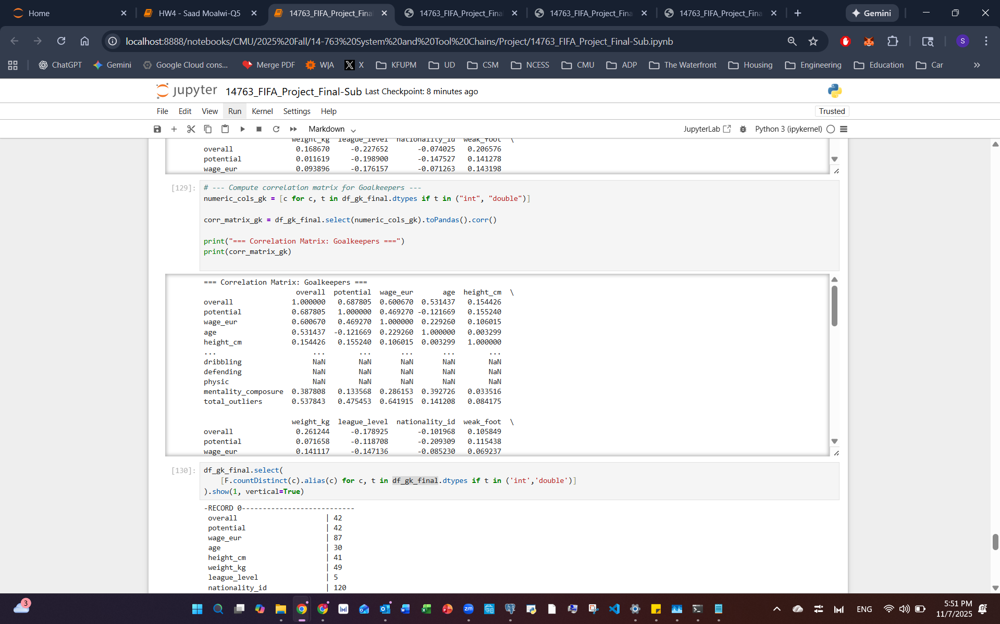

In [325]:
Image("p3_outliersinglevalues.png")

##### DataFrame Summary

* **`df_imported`** – Cleaned and imputed base dataset loaded from PostgreSQL.
* **`df_imported`** – Updated to include `player_category` for position grouping.
* **`df_outfield`** – All non-goalkeepers, with `goalkeeping_speed` removed.
* **`df_gk`** – Filtered dataset containing only goalkeepers.
* **`df_outfield_otlr`** – Outfield dataset after outlier detection and flag creation.
* **`df_gk_otlr`** – Goalkeeper dataset after outlier detection and flag creation.
* **`df_outfield_final`** – Outfield players filtered to retain records with ≤4 total outliers.
* **`df_gk_final`** – Goalkeepers filtered to retain records with ≤2 total outliers.


### Visualization of Variables and Distributions

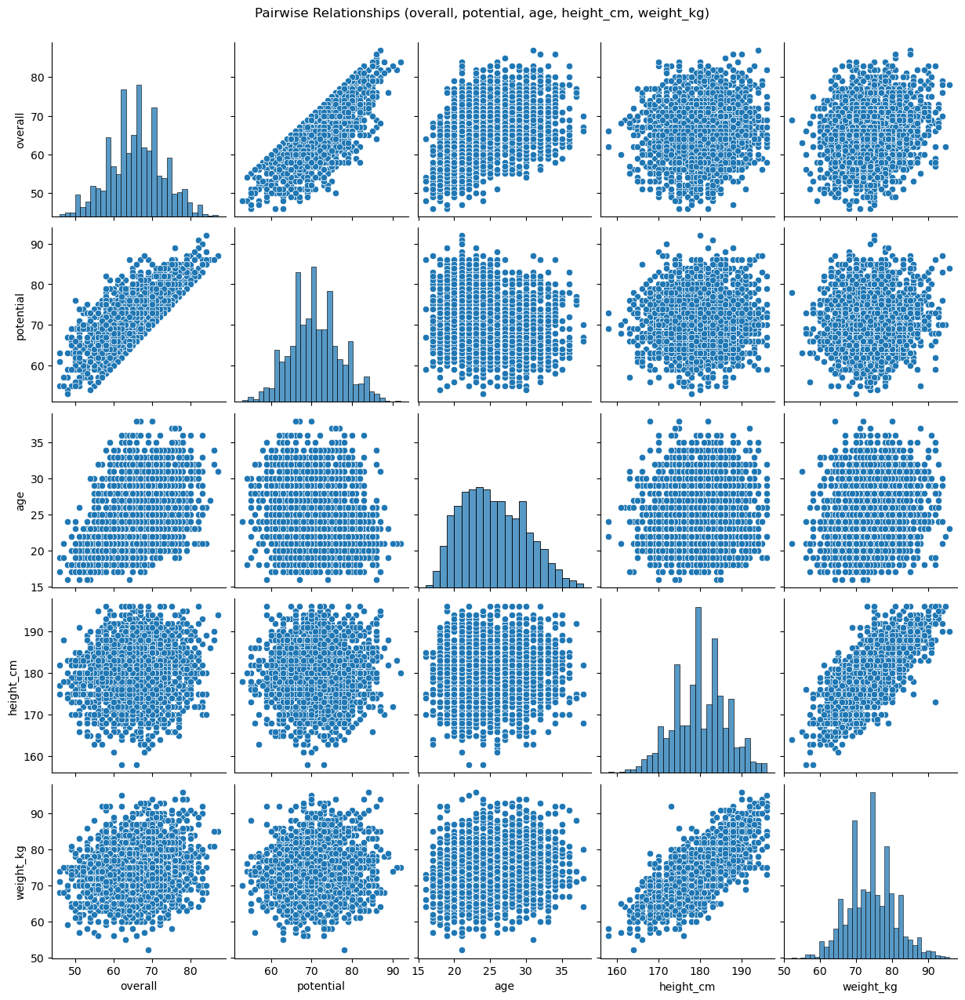

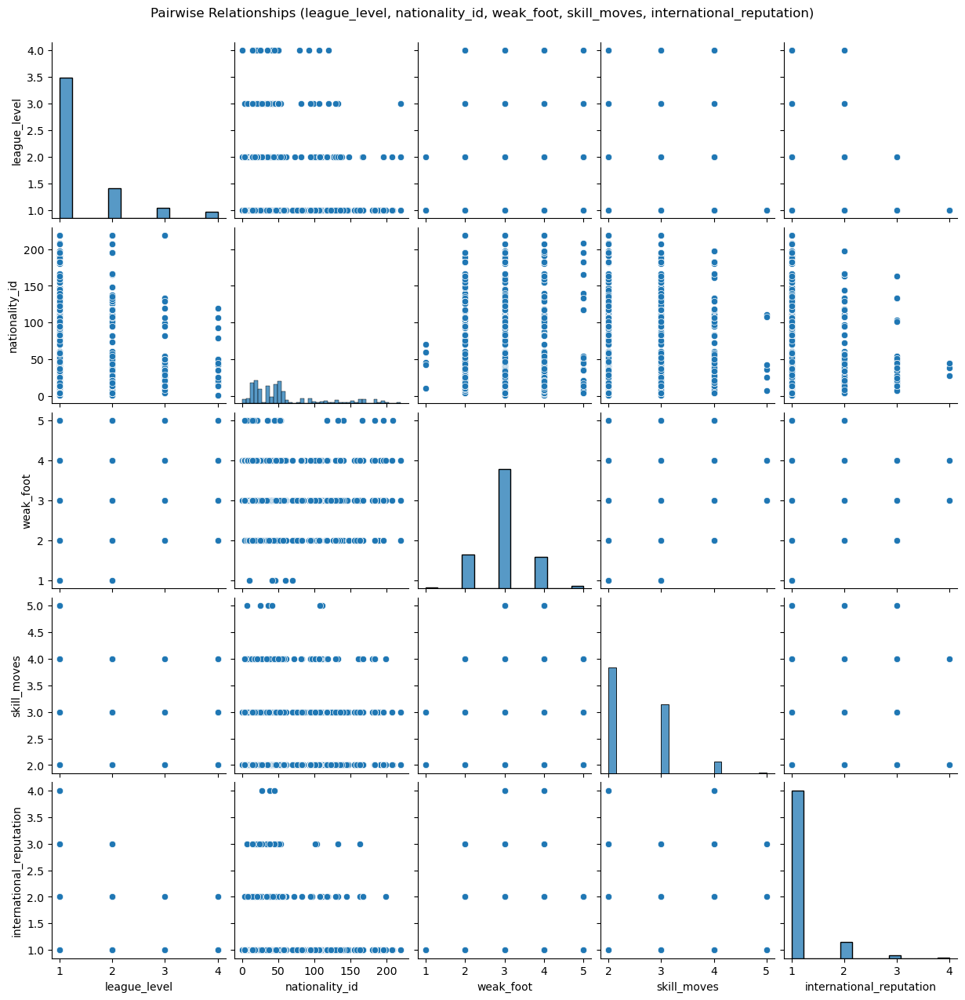

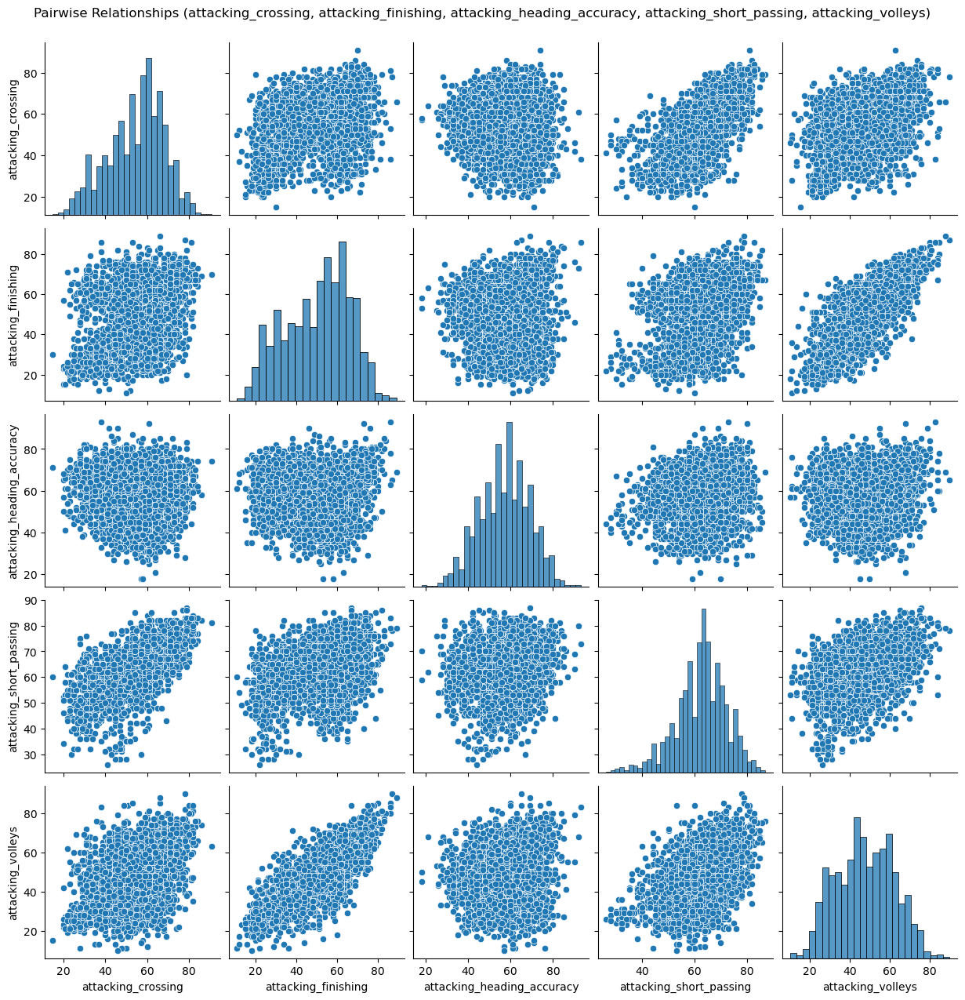

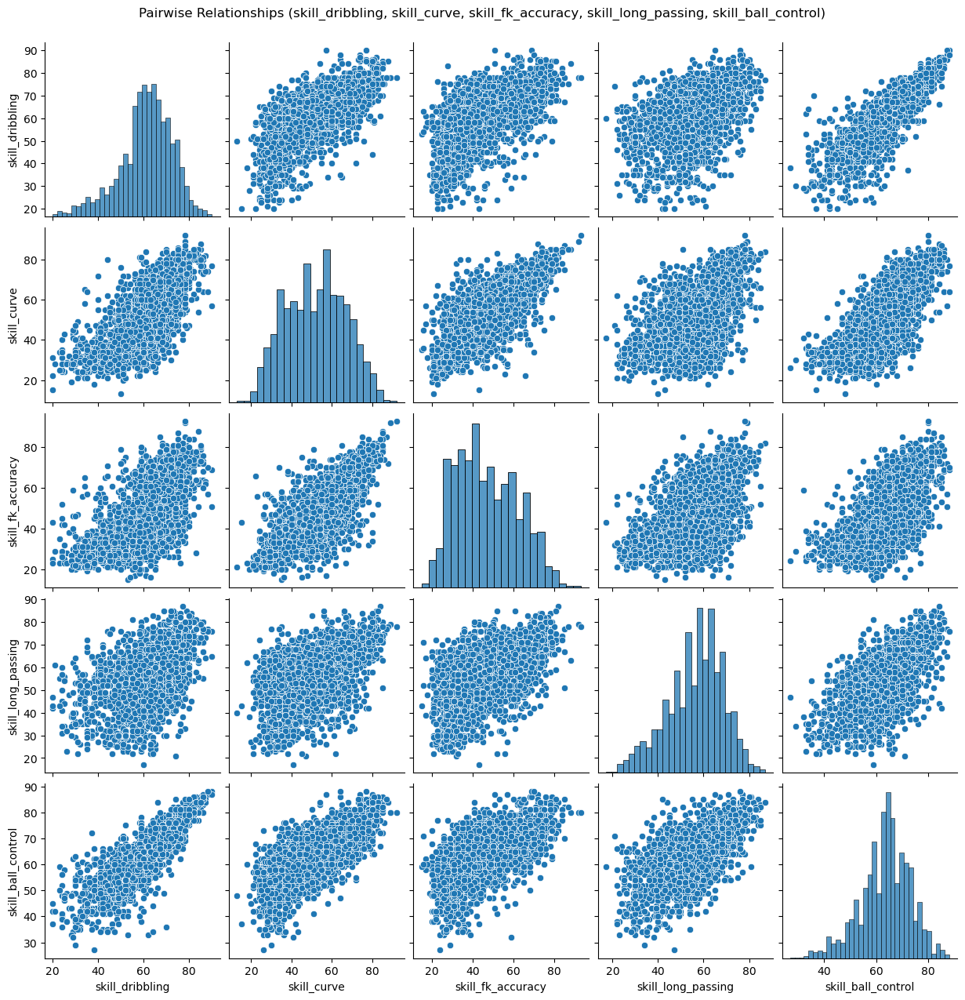

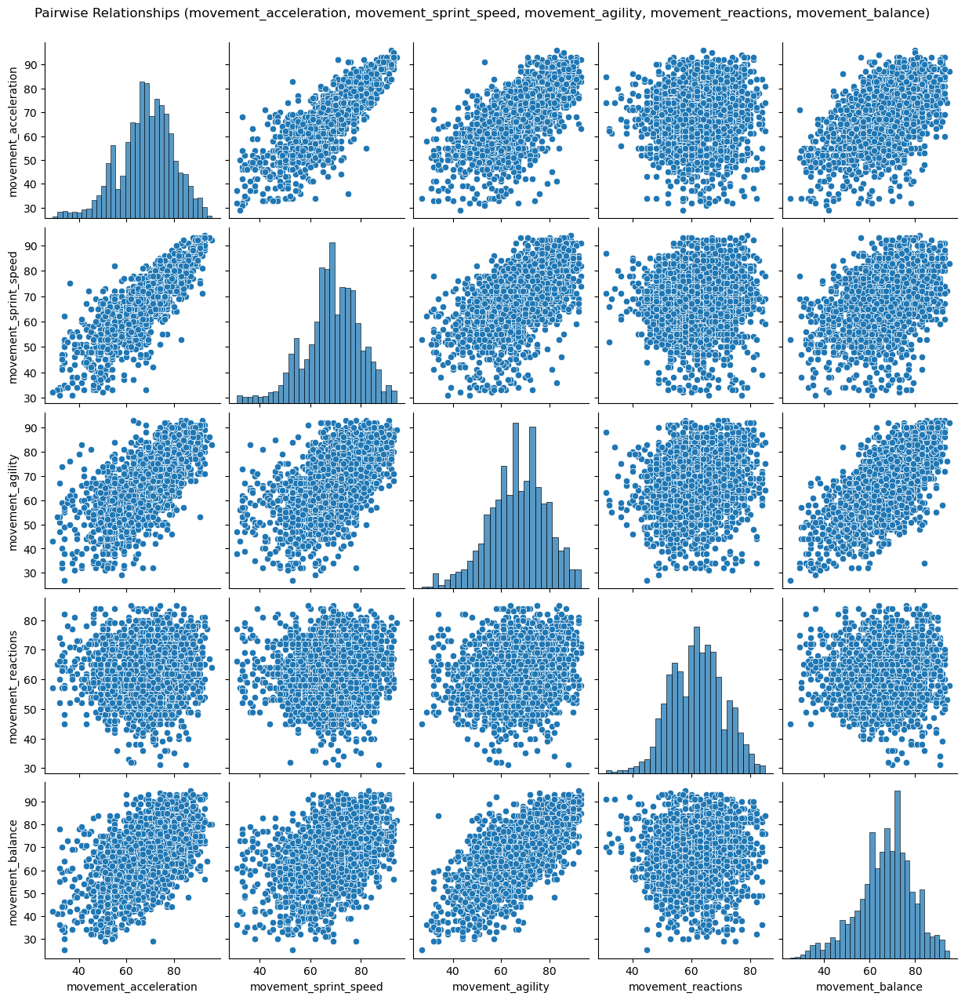

...

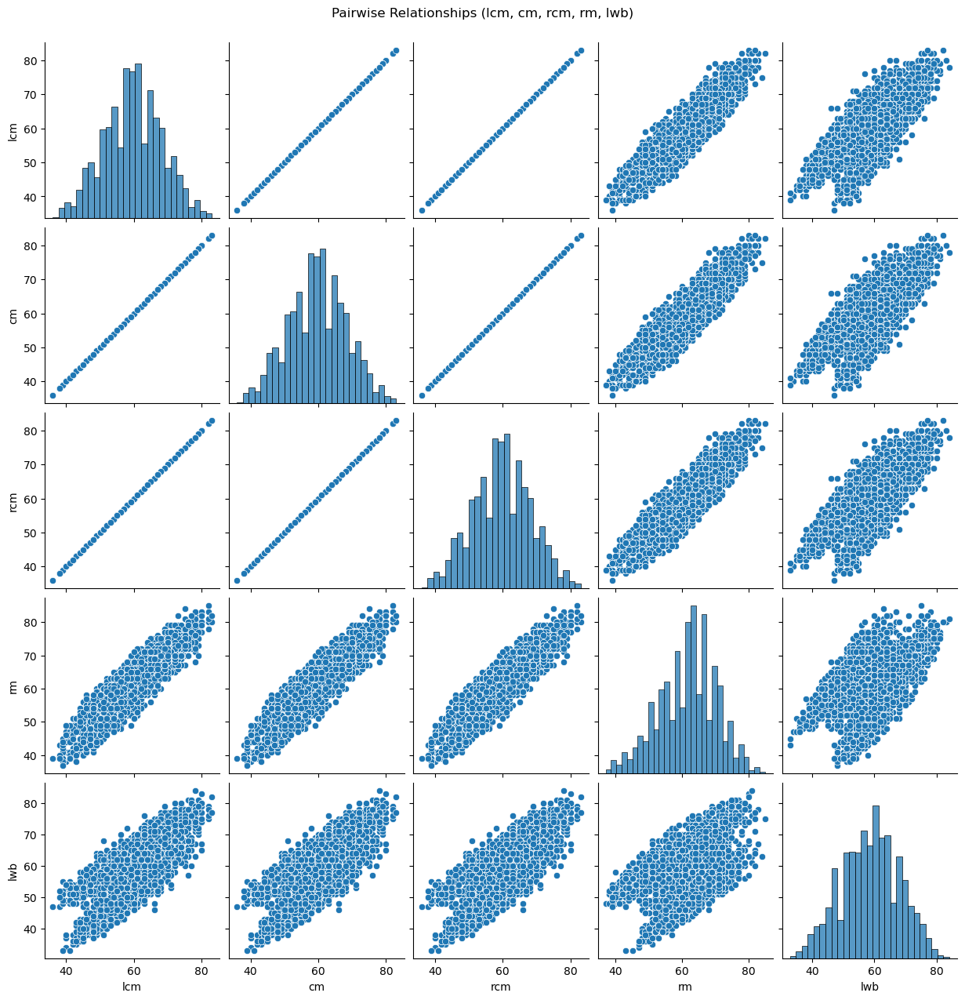

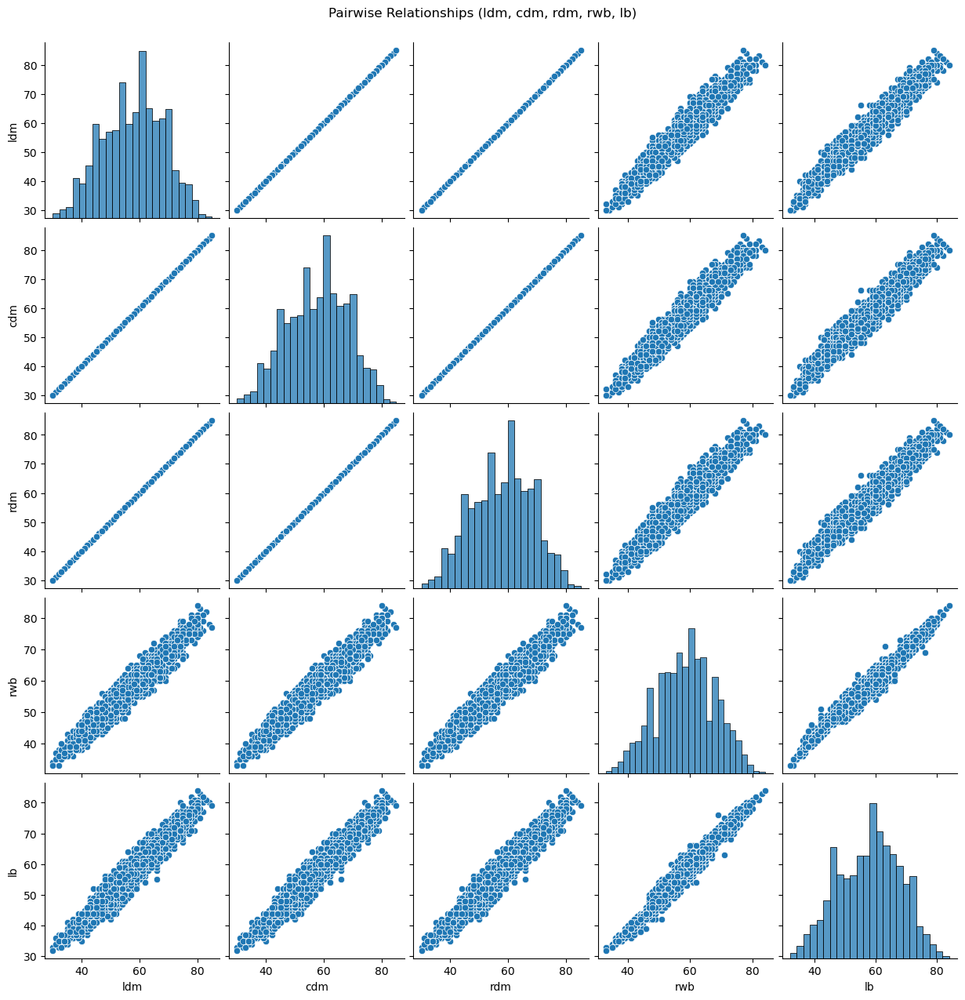

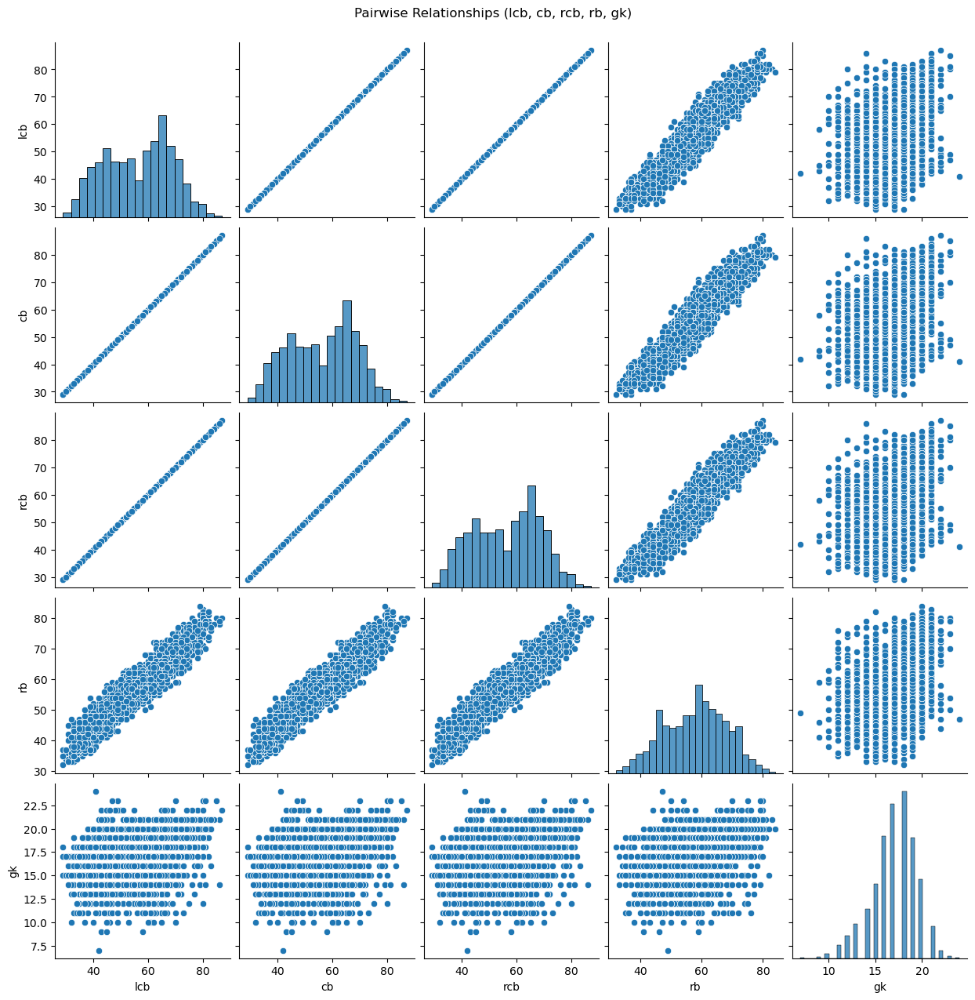

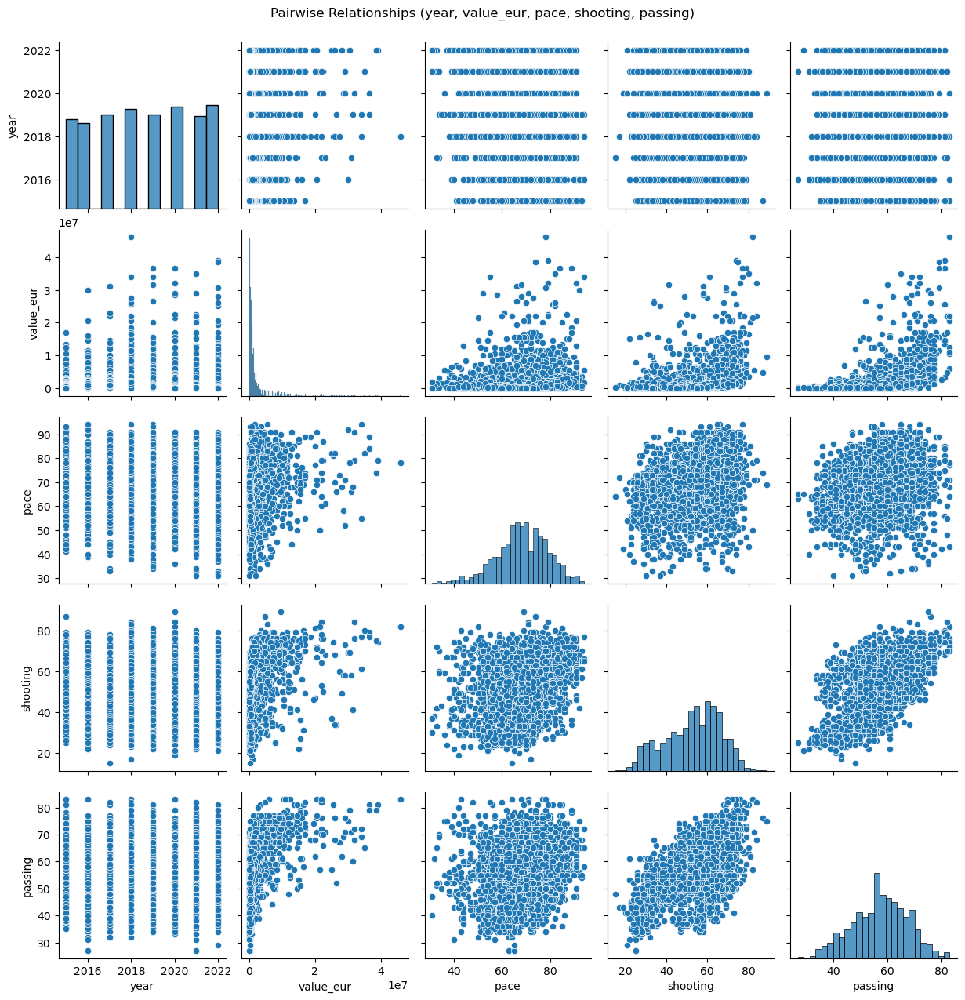

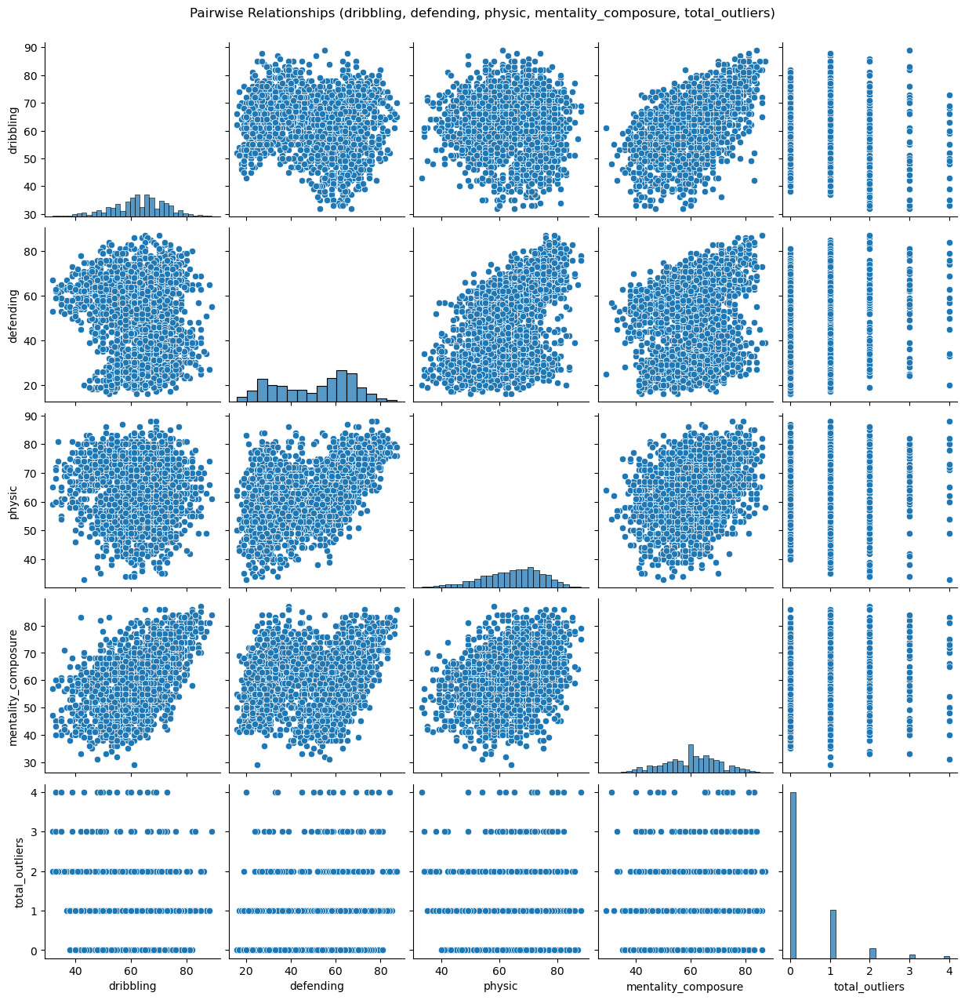

In [326]:
# Select numeric columns (for example)
numeric_cols_outfield = [f[0] for f in df_outfield_final.dtypes if f[1] in ('int', 'double')]

# Define batch size (e.g., 4 columns per iteration)
batch_size = 5

for i in range(0, len(numeric_cols_outfield), batch_size):
    batch = numeric_cols_outfield[i:i + batch_size]

    # Sample data for the batch only
    batch_pd = df_outfield_final.select(batch).sample(fraction=0.02, seed=42).toPandas()

    # Pairplot for this small batch
    sb.pairplot(batch_pd)
    plt.suptitle(f"Pairwise Relationships ({', '.join(batch)})", y=1.02)
    plt.show()

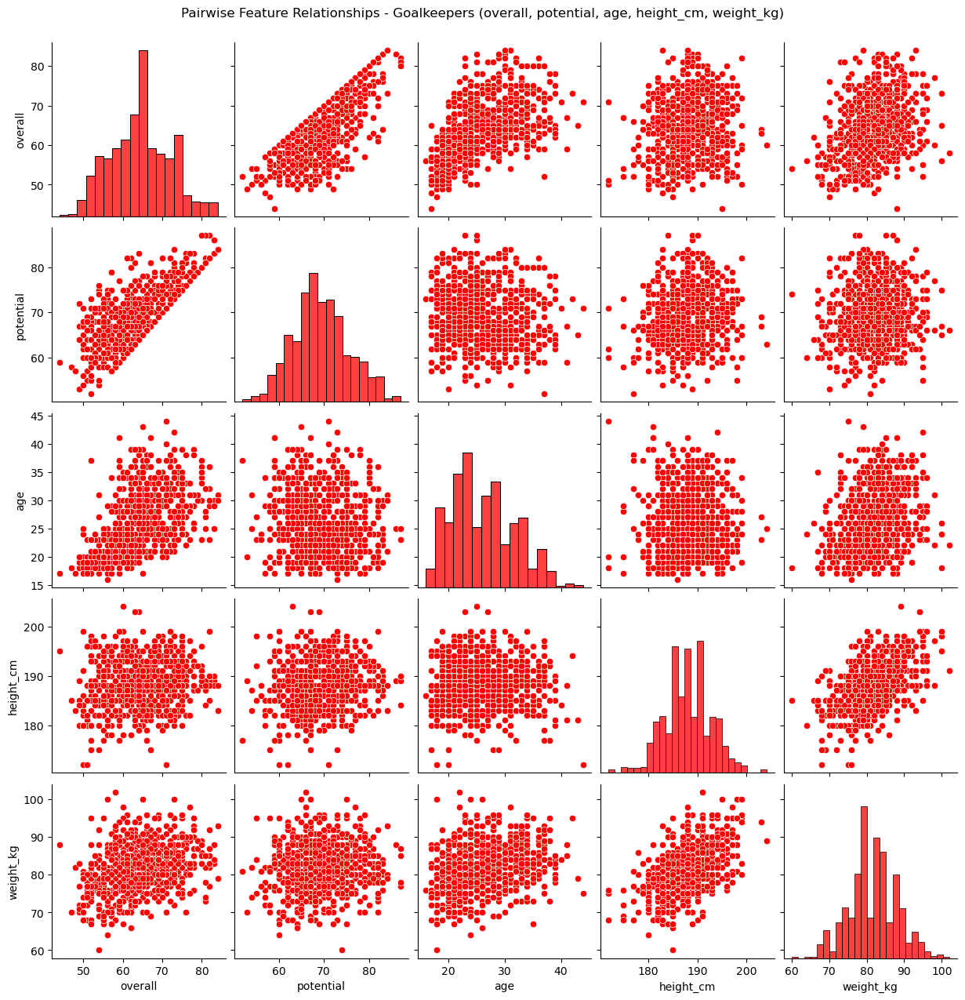

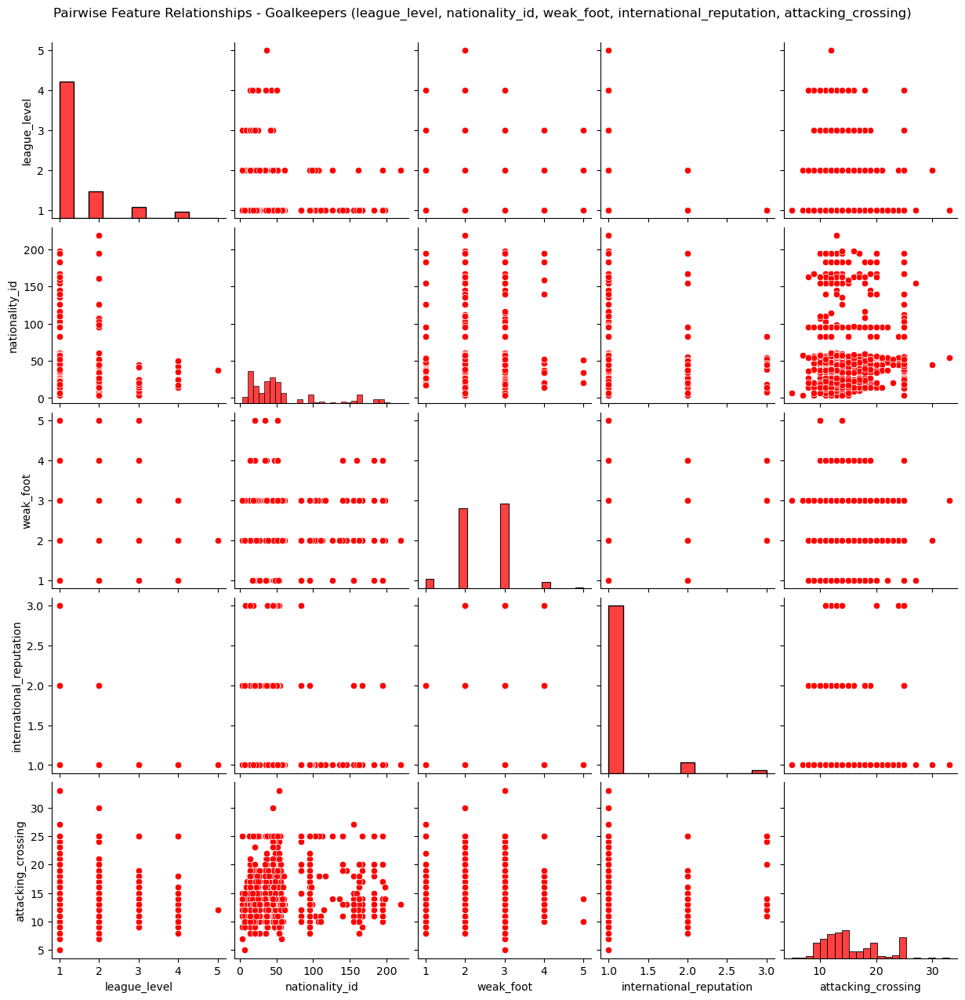

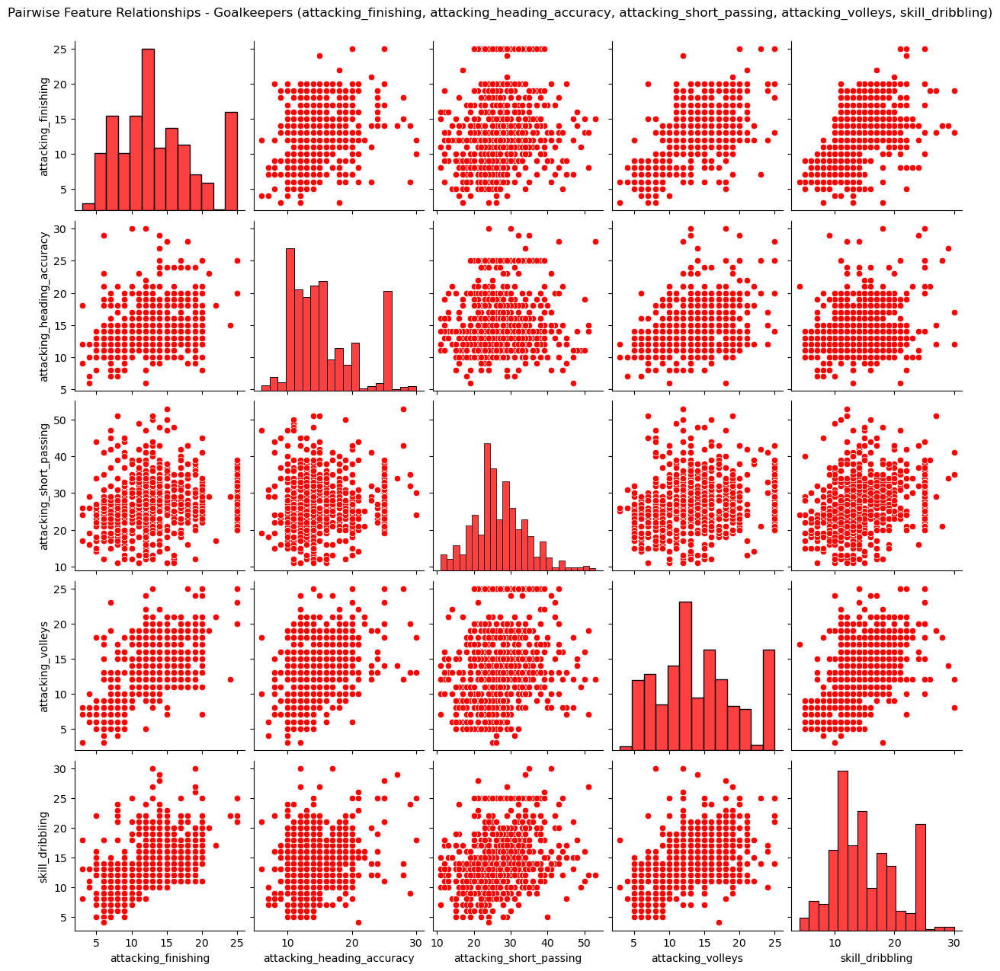

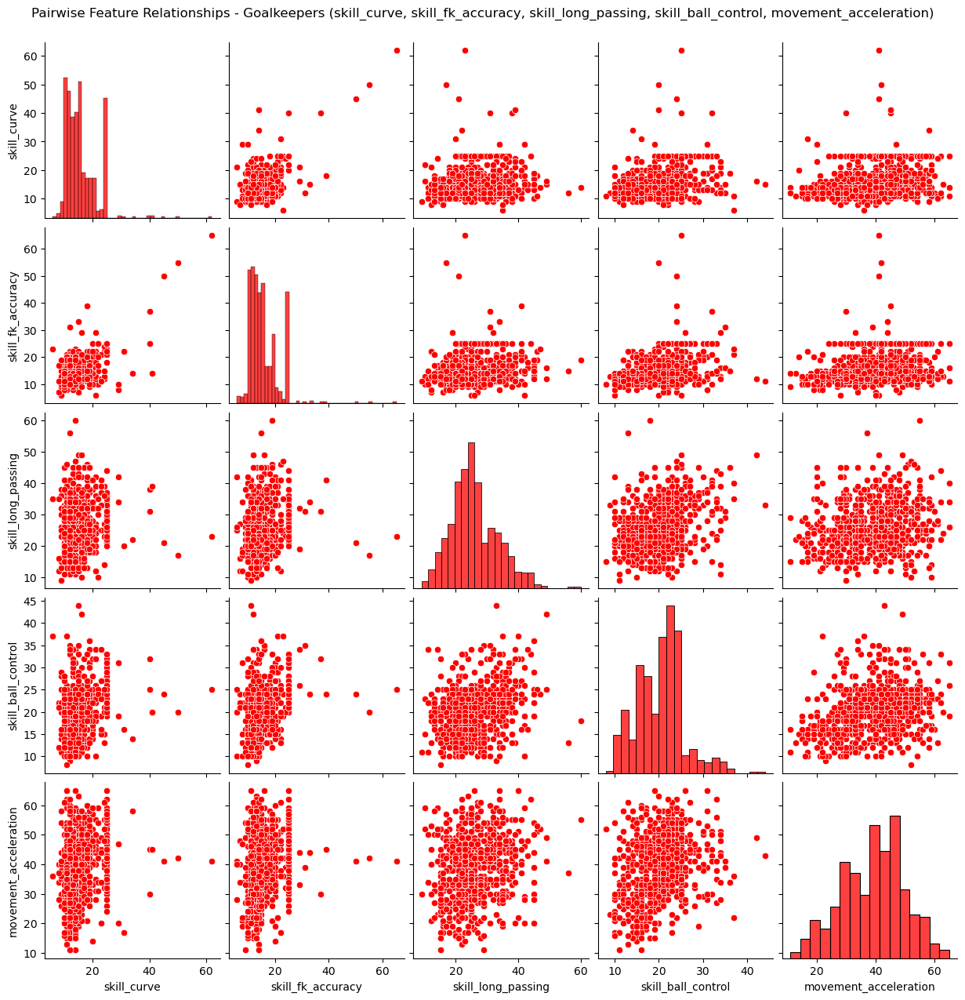

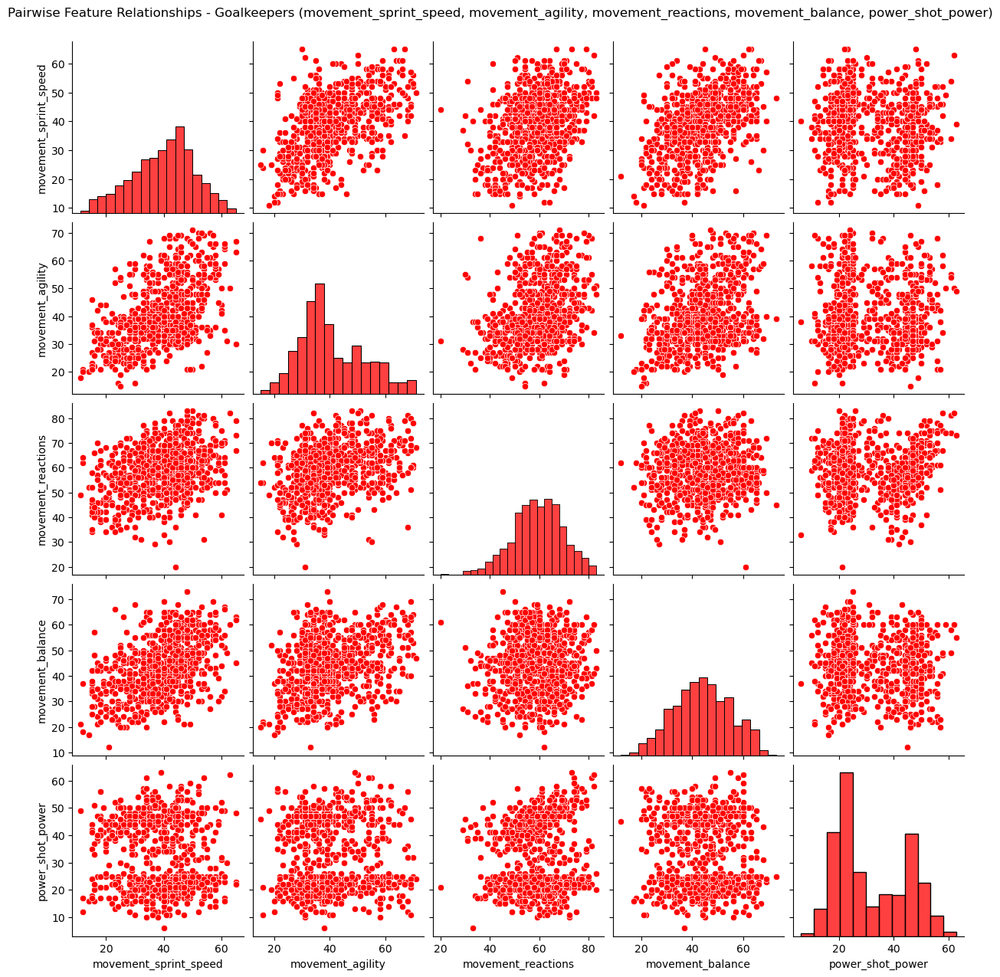

...

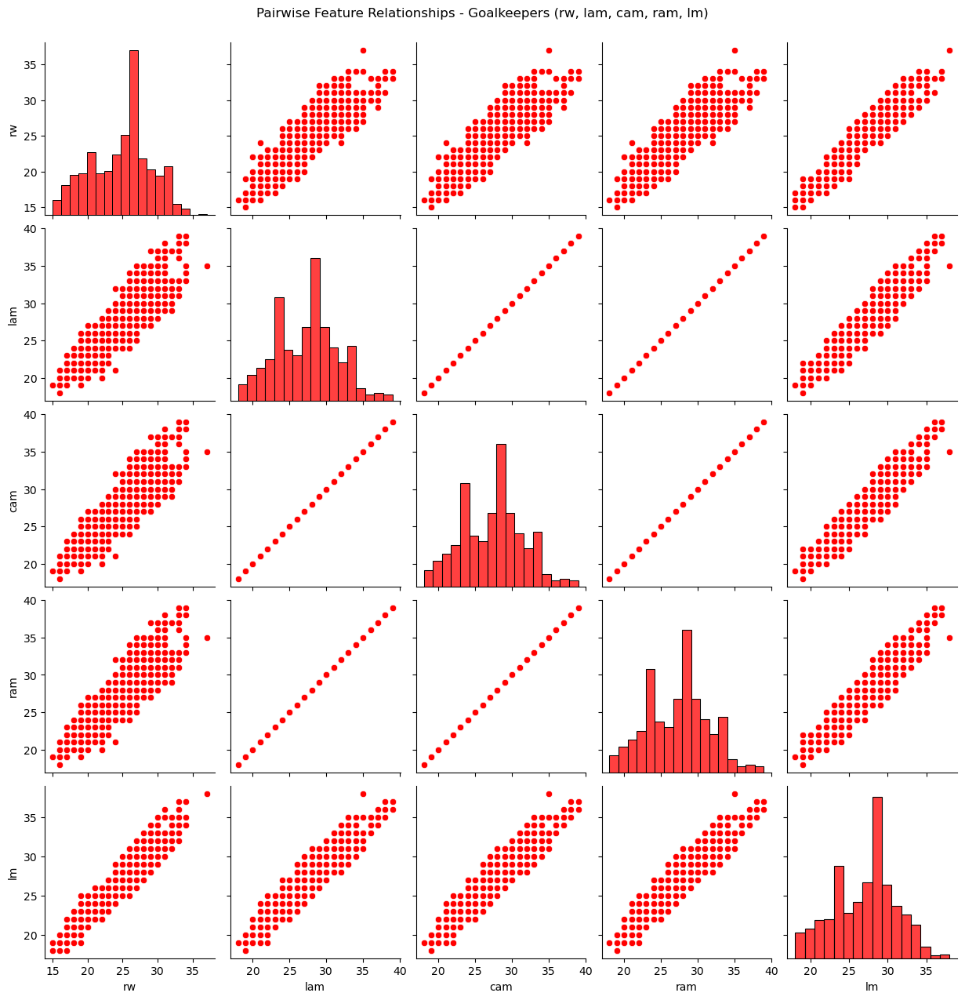

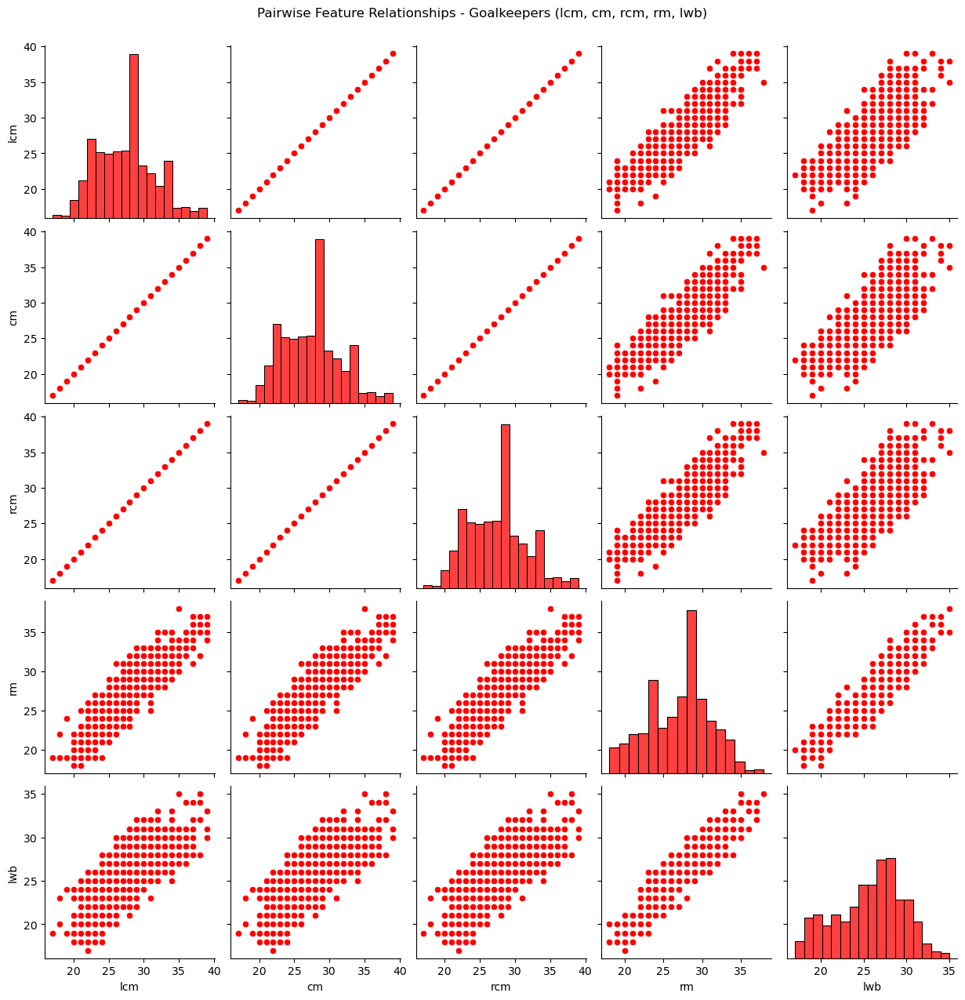

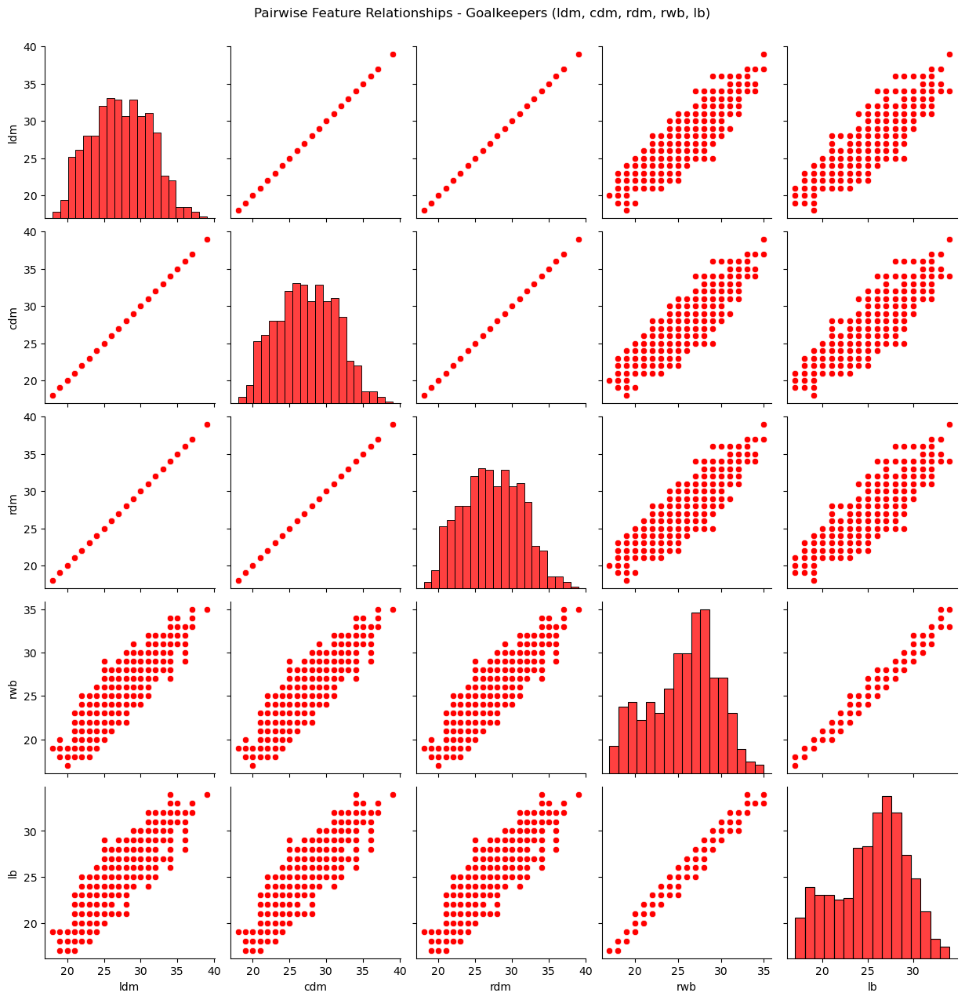

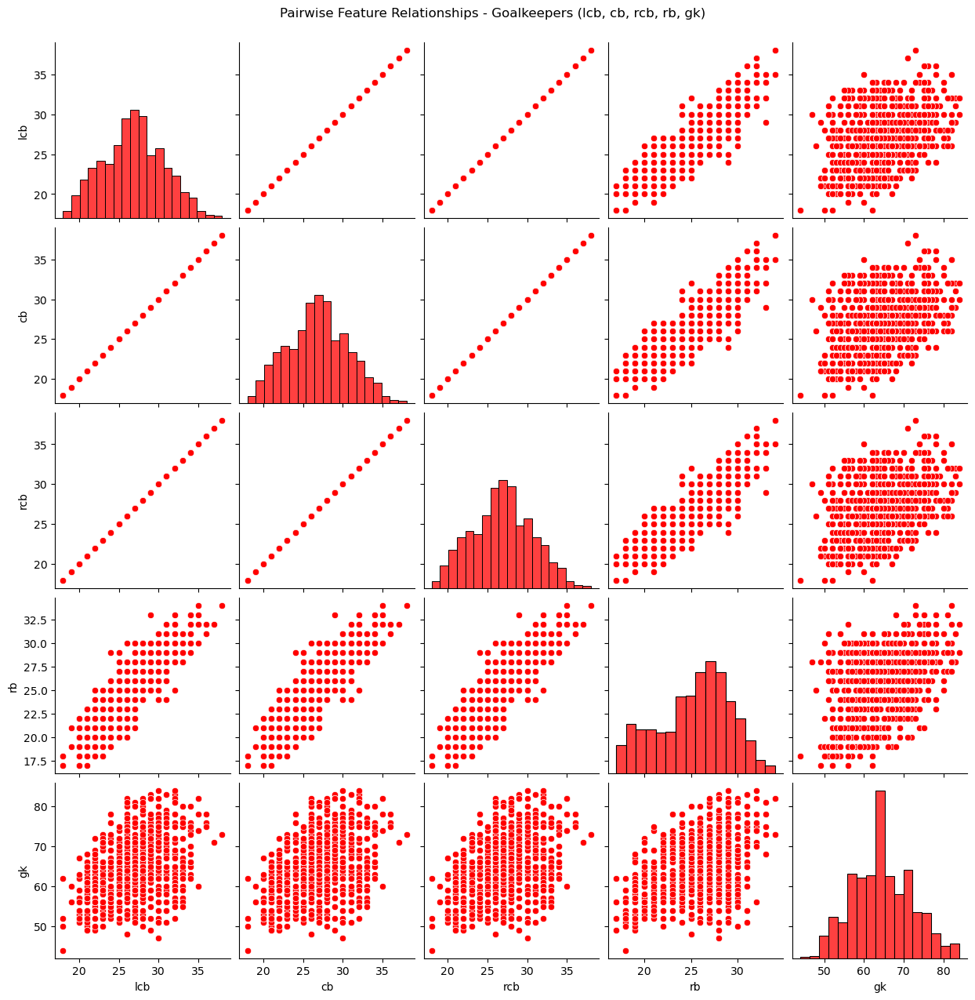

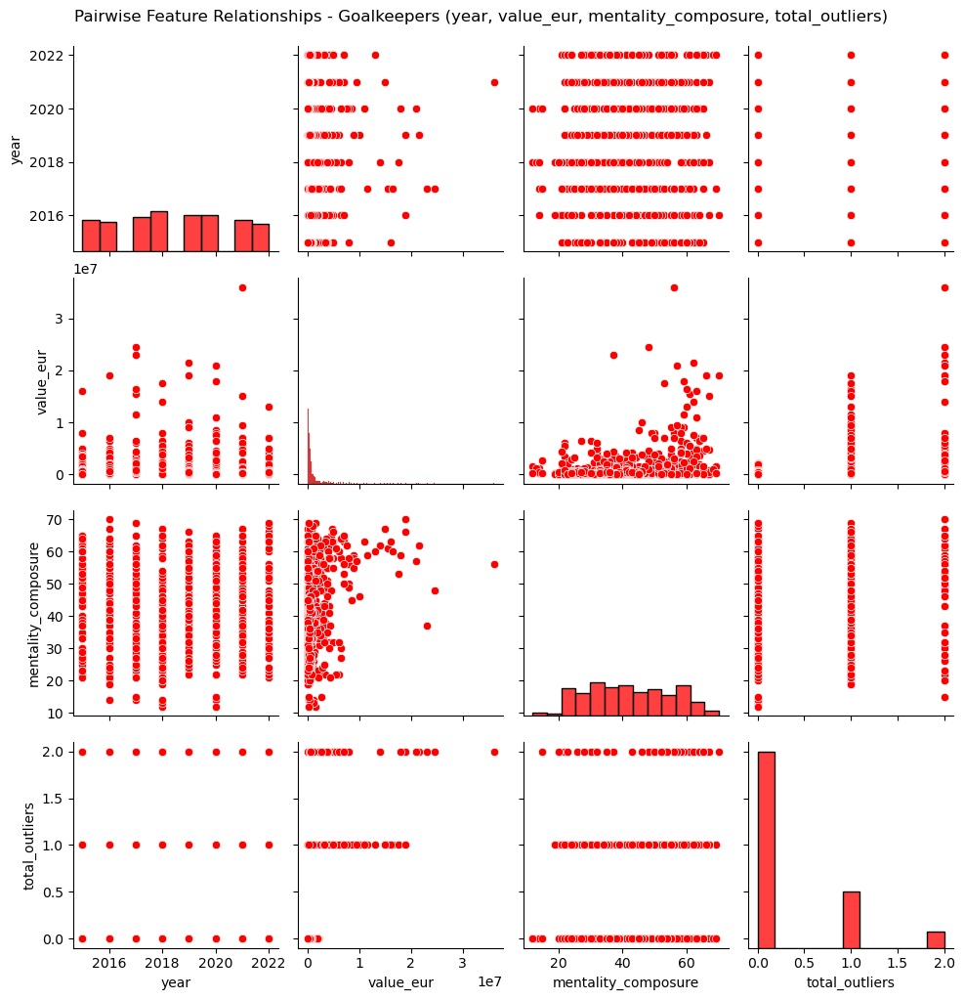

In [332]:
# --- Identify numeric columns for Goalkeepers ---
numeric_cols_gk = [f[0] for f in df_gk_final.dtypes if f[1] in ('int', 'double')]

# --- Define batch size (e.g., 4 columns per plot) ---
batch_size = 5

for i in range(0, len(numeric_cols_gk), batch_size):
    batch = numeric_cols_gk[i:i + batch_size]

    # Sample a small fraction to avoid memory overload
    batch_pd = df_gk_final.select(batch).sample(fraction=0.05, seed=42).toPandas()

    # Create pairplot for the batch
    sb.pairplot(batch_pd, plot_kws={'color':'red'}, diag_kws={'color':'red'})
    
    plt.suptitle(f"Pairwise Feature Relationships - Goalkeepers ({', '.join(batch)})", y=1.02)
    plt.show()

In [381]:
# --- Drop unwanted columns from both DataFrames ---
cols_to_drop = ["year", "total_outliers", "gender"]

df_gk_final = df_gk_final.drop(*[c for c in cols_to_drop if c in df_gk_final.columns])
df_outfield_final = df_outfield_final.drop(*[c for c in cols_to_drop if c in df_outfield_final.columns])

# --- Print confirmation ---
print("✅ Columns dropped successfully where applicable.")
print(f"Remaining columns in df_gk_final: {len(df_gk_final.columns)}")
print(f"Remaining columns in df_outfield_final: {len(df_outfield_final.columns)}")

✅ Columns dropped successfully where applicable.
Remaining columns in df_gk_final: 77
Remaining columns in df_outfield_final: 83


### Identify Correlations and Remove One Feature from Each Highly Correlated Pair

In [382]:
# --- Identify numeric columns for Outfield players ---
numeric_cols_outfield = [c for c, t in df_outfield_final.dtypes if t in ('int', 'double')]
print("Numeric columns (Outfield players):")
print(numeric_cols_outfield)

# --- Identify numeric columns for Goalkeepers ---
numeric_cols_gk = [c for c, t in df_gk_final.dtypes if t in ('int', 'double')]
print("\nNumeric columns (Goalkeepers):")
print(numeric_cols_gk)

Numeric columns (Outfield players):
['overall', 'potential', 'age', 'height_cm', 'weight_kg', 'league_level', 'nationality_id', 'weak_foot', 'skill_moves', 'international_reputation', 'attacking_crossing', 'attacking_finishing', 'attacking_heading_accuracy', 'attacking_short_passing', 'attacking_volleys', 'skill_dribbling', 'skill_curve', 'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed', 'movement_agility', 'movement_reactions', 'movement_balance', 'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength', 'power_long_shots', 'mentality_aggression', 'mentality_interceptions', 'mentality_positioning', 'mentality_vision', 'mentality_penalties', 'defending_marking_awareness', 'defending_standing_tackle', 'defending_sliding_tackle', 'goalkeeping_diving', 'goalkeeping_handling', 'goalkeeping_kicking', 'goalkeeping_positioning', 'goalkeeping_reflexes', 'ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', '

#### Outfield Players

In [383]:
# --- Compute correlation matrix for Outfield players ---
numeric_cols_outfield = [c for c, t in df_outfield_final.dtypes if t in ("int", "double")]

corr_matrix_outfield = df_outfield_final.select(numeric_cols_outfield).toPandas().corr()

print("=== Correlation Matrix: Outfield Players ===")
print(corr_matrix_outfield)

=== Correlation Matrix: Outfield Players ===
                      overall  potential       age  height_cm  weight_kg  \
overall              1.000000   0.678883  0.458371   0.080309   0.172388   
potential            0.678883   1.000000 -0.225579   0.037572   0.016553   
age                  0.458371  -0.225579  1.000000   0.062061   0.206396   
height_cm            0.080309   0.037572  0.062061   1.000000   0.743038   
weight_kg            0.172388   0.016553  0.206396   0.743038   1.000000   
...                       ...        ...       ...        ...        ...   
passing              0.665908   0.432928  0.336041  -0.258835  -0.168837   
dribbling            0.591802   0.470784  0.163301  -0.382263  -0.285456   
defending            0.332735   0.163785  0.254058   0.212487   0.206766   
physic               0.517984   0.183224  0.428673   0.489496   0.573618   
mentality_composure  0.720205   0.437372  0.404682   0.026047   0.104881   

                     league_level  nationa

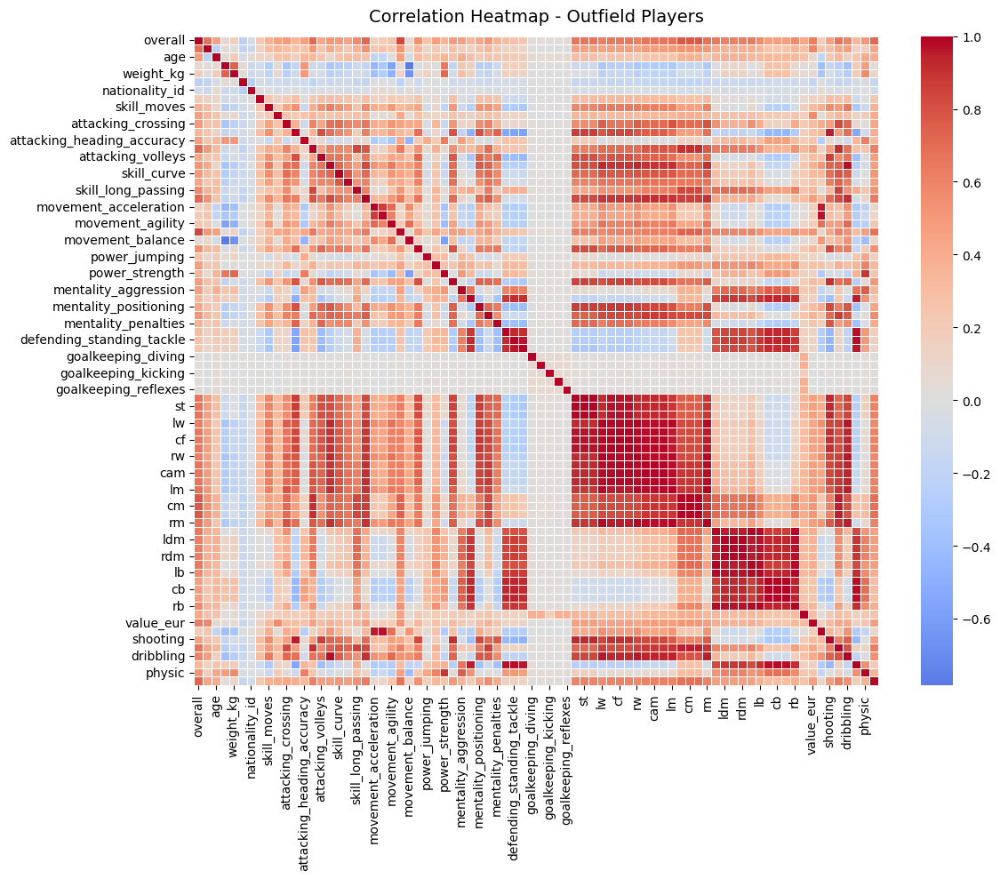

In [384]:
# --- Visualize correlation heatmap for Outfield players ---
plt.figure(figsize=(12, 10))
sb.heatmap(corr_matrix_outfield, annot=False, cmap="coolwarm", center=0, linewidths=0.5)
plt.title("Correlation Heatmap - Outfield Players", fontsize=14, pad=12)
plt.tight_layout()
plt.show()

In [385]:
# --- Detect and recommend drops for highly correlated features (|corr| ≥ 0.8) ---

# Compute correlation matrix
numeric_cols_outfield = [c for c, t in df_outfield_final.dtypes if t in ("int", "double")]
corr_matrix_outfield = df_outfield_final.select(numeric_cols_outfield).toPandas().corr()

# Define threshold
threshold = 0.8
target = "value_eur"

# Find high correlation pairs
high_corr_pairs = [
    (col1, col2, corr_matrix_outfield.loc[col1, col2])
    for col1 in corr_matrix_outfield.columns
    for col2 in corr_matrix_outfield.columns
    if col1 != col2 and abs(corr_matrix_outfield.loc[col1, col2]) >= threshold
]

# Remove duplicates (A,B) and (B,A)
unique_high_corr_pairs = []
seen = set()
for a, b, v in high_corr_pairs:
    if (b, a) not in seen:
        unique_high_corr_pairs.append((a, b, v))
        seen.add((a, b))

# --- Recommend which feature to drop ---
recommendations = []
for a, b, v in unique_high_corr_pairs:
    corr_a = abs(corr_matrix_outfield.loc[a, target]) if target in corr_matrix_outfield.columns else None
    corr_b = abs(corr_matrix_outfield.loc[b, target]) if target in corr_matrix_outfield.columns else None
    
    if corr_a is not None and corr_b is not None:
        drop = a if corr_a < corr_b else b
        recommendations.append((a, b, v, drop, corr_a, corr_b))

# --- Display results ---
print("=== Highly Correlated Feature Pairs (|corr| ≥ 0.8) and Drop Recommendations ===")
for a, b, v, drop, corr_a, corr_b in recommendations:
    print(f"{a:<25} ↔ {b:<25} = {v:.3f} | corr(value_eur): ({corr_a:.3f}, {corr_b:.3f}) → Drop: {drop}")

print(f"\nTotal highly correlated pairs: {len(recommendations)}")


=== Highly Correlated Feature Pairs (|corr| ≥ 0.8) and Drop Recommendations ===
overall                   ↔ movement_reactions        = 0.836 | corr(value_eur): (0.628, 0.538) → Drop: movement_reactions
attacking_crossing        ↔ passing                   = 0.821 | corr(value_eur): (0.300, 0.428) → Drop: attacking_crossing
attacking_finishing       ↔ attacking_volleys         = 0.809 | corr(value_eur): (0.264, 0.299) → Drop: attacking_finishing
attacking_finishing       ↔ mentality_positioning     = 0.807 | corr(value_eur): (0.264, 0.303) → Drop: attacking_finishing
attacking_finishing       ↔ ls                        = 0.874 | corr(value_eur): (0.264, 0.459) → Drop: attacking_finishing
attacking_finishing       ↔ st                        = 0.874 | corr(value_eur): (0.264, 0.459) → Drop: attacking_finishing
attacking_finishing       ↔ rs                        = 0.874 | corr(value_eur): (0.264, 0.459) → Drop: attacking_finishing
attacking_finishing       ↔ lf                        

In [386]:
# --- Drop weakly correlated duplicate features (based on previous recommendations) ---

# Collect unique features to drop
features_to_drop = list(set([r[3] for r in recommendations]))  # column index 3 = drop candidate

print("Features recommended for removal due to high inter-correlation:")
print(features_to_drop)
print(f"Total features to drop: {len(features_to_drop)}")

# Record size before dropping
before_rows = df_outfield_final.count()
before_cols = len(df_outfield_final.columns)

# Drop features
df_outfield_corr_cln = df_outfield_final.drop(*features_to_drop)

# Record size after dropping
after_rows = df_outfield_corr_cln.count()
after_cols = len(df_outfield_corr_cln.columns)

print("\n✅ Drop process complete:")
print(f"   • Rows: {before_rows:,} → {after_rows:,}")
print(f"   • Columns: {before_cols:,} → {after_cols:,}")

Features recommended for removal due to high inter-correlation:
['defending_sliding_tackle', 'cb', 'movement_sprint_speed', 'lw', 'cm', 'defending', 'power_shot_power', 'rwb', 'rs', 'power_strength', 'lcb', 'lam', 'defending_marking_awareness', 'movement_reactions', 'cf', 'attacking_crossing', 'rw', 'lf', 'defending_standing_tackle', 'ldm', 'ram', 'skill_long_passing', 'passing', 'rm', 'rdm', 'rcb', 'rb', 'rcm', 'shooting', 'cdm', 'attacking_short_passing', 'skill_dribbling', 'ls', 'dribbling', 'lm', 'attacking_finishing', 'movement_acceleration', 'mentality_positioning', 'lb', 'mentality_vision', 'power_long_shots', 'st', 'attacking_volleys', 'rf', 'mentality_interceptions', 'cam', 'skill_ball_control']
Total features to drop: 47

✅ Drop process complete:
   • Rows: 121,766 → 121,766
   • Columns: 83 → 36


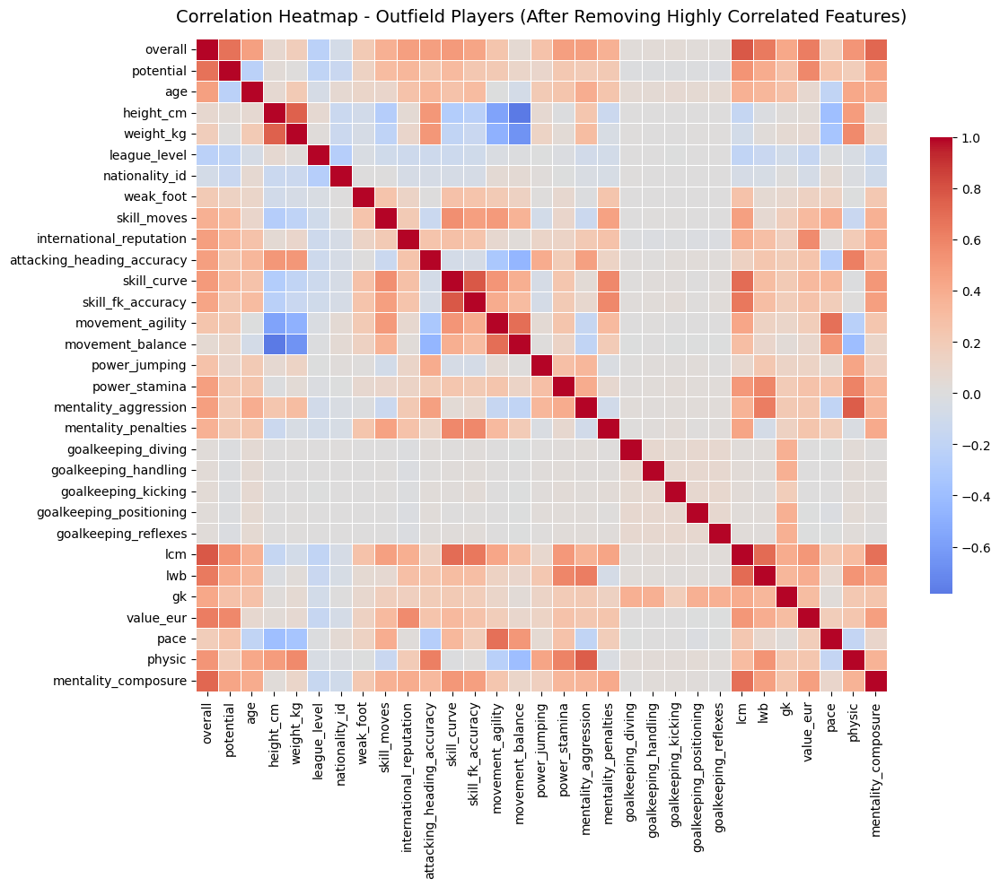

In [387]:
# --- Visualize correlation heatmap for Outfield players (after dropping correlated features) ---

# Recompute correlation matrix from cleaned DataFrame
numeric_cols_outfield_cln = [c for c, t in df_outfield_corr_cln.dtypes if t in ("int", "double")]
corr_matrix_outfield_cln = df_outfield_corr_cln.select(numeric_cols_outfield_cln).toPandas().corr()

# Plot heatmap
plt.figure(figsize=(12, 10))
sb.heatmap(
    corr_matrix_outfield_cln,
    annot=False,
    cmap="coolwarm",
    center=0,
    linewidths=0.5,
    cbar_kws={'shrink': 0.7}
)
plt.title("Correlation Heatmap - Outfield Players (After Removing Highly Correlated Features)", fontsize=14, pad=14)
plt.tight_layout()
plt.show()


#### Goalkeeper

In [388]:
# --- Compute correlation matrix for Goalkeepers ---
numeric_cols_gk = [c for c, t in df_gk_final.dtypes if t in ("int", "double")]

corr_matrix_gk = df_gk_final.select(numeric_cols_gk).toPandas().corr()

print("=== Correlation Matrix: Goalkeepers ===")
print(corr_matrix_gk)


=== Correlation Matrix: Goalkeepers ===
                      overall  potential       age  height_cm  weight_kg  \
overall              1.000000   0.705652  0.523518   0.160101   0.264012   
potential            0.705652   1.000000 -0.110232   0.158963   0.079747   
age                  0.523518  -0.110232  1.000000   0.006564   0.252162   
height_cm            0.160101   0.158963  0.006564   1.000000   0.578728   
weight_kg            0.264012   0.079747  0.252162   0.578728   1.000000   
...                       ...        ...       ...        ...        ...   
rcb                  0.458498   0.164360  0.381536   0.122197   0.254199   
rb                   0.484995   0.203690  0.352500   0.014526   0.117090   
gk                   0.998179   0.717072  0.507968   0.163904   0.260291   
value_eur            0.605403   0.579993  0.095306   0.108049   0.105878   
mentality_composure  0.405694   0.161505  0.392948   0.040664   0.136635   

                     league_level  nationality_

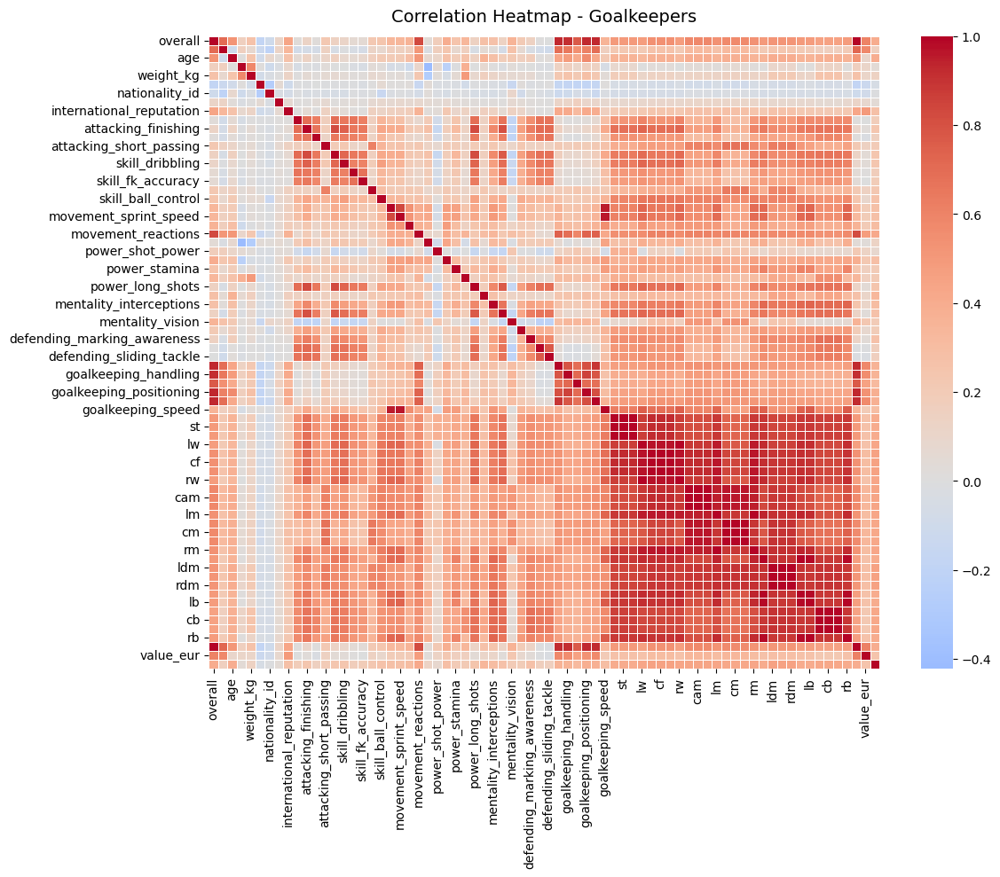

In [389]:
# --- Visualize correlation heatmap for Goalkeepers ---
plt.figure(figsize=(12, 10))
sb.heatmap(corr_matrix_gk, annot=False, cmap="coolwarm", center=0, linewidths=0.5)
plt.title("Correlation Heatmap - Goalkeepers", fontsize=14, pad=12)
plt.tight_layout()
plt.show()

In [390]:
# --- Detect and recommend drops for highly correlated features (|corr| ≥ 0.8) ---

# Compute correlation matrix
numeric_cols_gk = [c for c, t in df_gk_final.dtypes if t in ("int", "double")]
corr_matrix_gk = df_gk_final.select(numeric_cols_gk).toPandas().corr()

# Define threshold
threshold = 0.8
target = "value_eur"

# Find high correlation pairs
high_corr_pairs = [
    (col1, col2, corr_matrix_gk.loc[col1, col2])
    for col1 in corr_matrix_gk.columns
    for col2 in corr_matrix_gk.columns
    if col1 != col2 and abs(corr_matrix_gk.loc[col1, col2]) >= threshold
]

# Remove duplicates (A,B) and (B,A)
unique_high_corr_pairs = []
seen = set()
for a, b, v in high_corr_pairs:
    if (b, a) not in seen:
        unique_high_corr_pairs.append((a, b, v))
        seen.add((a, b))

# --- Recommend which feature to drop ---
recommendations = []
for a, b, v in unique_high_corr_pairs:
    corr_a = abs(corr_matrix_gk.loc[a, target]) if target in corr_matrix_gk.columns else None
    corr_b = abs(corr_matrix_gk.loc[b, target]) if target in corr_matrix_gk.columns else None
    
    if corr_a is not None and corr_b is not None:
        drop = a if corr_a < corr_b else b
        recommendations.append((a, b, v, drop, corr_a, corr_b))

# --- Display results ---
print("=== Highly Correlated Feature Pairs (|corr| ≥ 0.8) and Drop Recommendations (Goalkeepers) ===")
for a, b, v, drop, corr_a, corr_b in recommendations:
    print(f"{a:<25} ↔ {b:<25} = {v:.3f} | corr(value_eur): ({corr_a:.3f}, {corr_b:.3f}) → Drop: {drop}")

print(f"\nTotal highly correlated pairs: {len(recommendations)}")


=== Highly Correlated Feature Pairs (|corr| ≥ 0.8) and Drop Recommendations (Goalkeepers) ===
overall                   ↔ movement_reactions        = 0.828 | corr(value_eur): (0.605, 0.481) → Drop: movement_reactions
overall                   ↔ goalkeeping_diving        = 0.928 | corr(value_eur): (0.605, 0.580) → Drop: goalkeeping_diving
overall                   ↔ goalkeeping_handling      = 0.913 | corr(value_eur): (0.605, 0.559) → Drop: goalkeeping_handling
overall                   ↔ goalkeeping_positioning   = 0.932 | corr(value_eur): (0.605, 0.533) → Drop: goalkeeping_positioning
overall                   ↔ goalkeeping_reflexes      = 0.930 | corr(value_eur): (0.605, 0.576) → Drop: goalkeeping_reflexes
overall                   ↔ gk                        = 0.998 | corr(value_eur): (0.605, 0.612) → Drop: overall
attacking_finishing       ↔ attacking_volleys         = 0.821 | corr(value_eur): (0.024, 0.042) → Drop: attacking_finishing
attacking_finishing       ↔ power_long_shots  

In [391]:
# --- Drop weakly correlated duplicate features (based on previous recommendations) ---

# Collect unique features to drop
features_to_drop = list(set([r[3] for r in recommendations]))  # column index 3 = drop candidate

print("Features recommended for removal due to high inter-correlation (Goalkeepers):")
print(features_to_drop)
print(f"Total features to drop: {len(features_to_drop)}")

# Record size before dropping
before_rows = df_gk_final.count()
before_cols = len(df_gk_final.columns)

# Drop features
df_gk_corr_cln = df_gk_final.drop(*features_to_drop)

# Record size after dropping
after_rows = df_gk_corr_cln.count()
after_cols = len(df_gk_corr_cln.columns)

print("\n✅ Drop process complete for Goalkeepers:")
print(f"   • Rows: {before_rows:,} → {after_rows:,}")
print(f"   • Columns: {before_cols:,} → {after_cols:,}")

Features recommended for removal due to high inter-correlation (Goalkeepers):
['cb', 'movement_sprint_speed', 'lw', 'cm', 'goalkeeping_handling', 'rwb', 'lwb', 'rs', 'lcb', 'lam', 'movement_reactions', 'cf', 'rw', 'ldm', 'lf', 'ram', 'goalkeeping_diving', 'rcb', 'rdm', 'rb', 'rm', 'rcm', 'overall', 'cdm', 'ls', 'goalkeeping_reflexes', 'lm', 'attacking_finishing', 'movement_acceleration', 'lb', 'goalkeeping_positioning', 'st', 'attacking_volleys', 'rf', 'cam']
Total features to drop: 35

✅ Drop process complete for Goalkeepers:
   • Rows: 15,027 → 15,027
   • Columns: 77 → 42


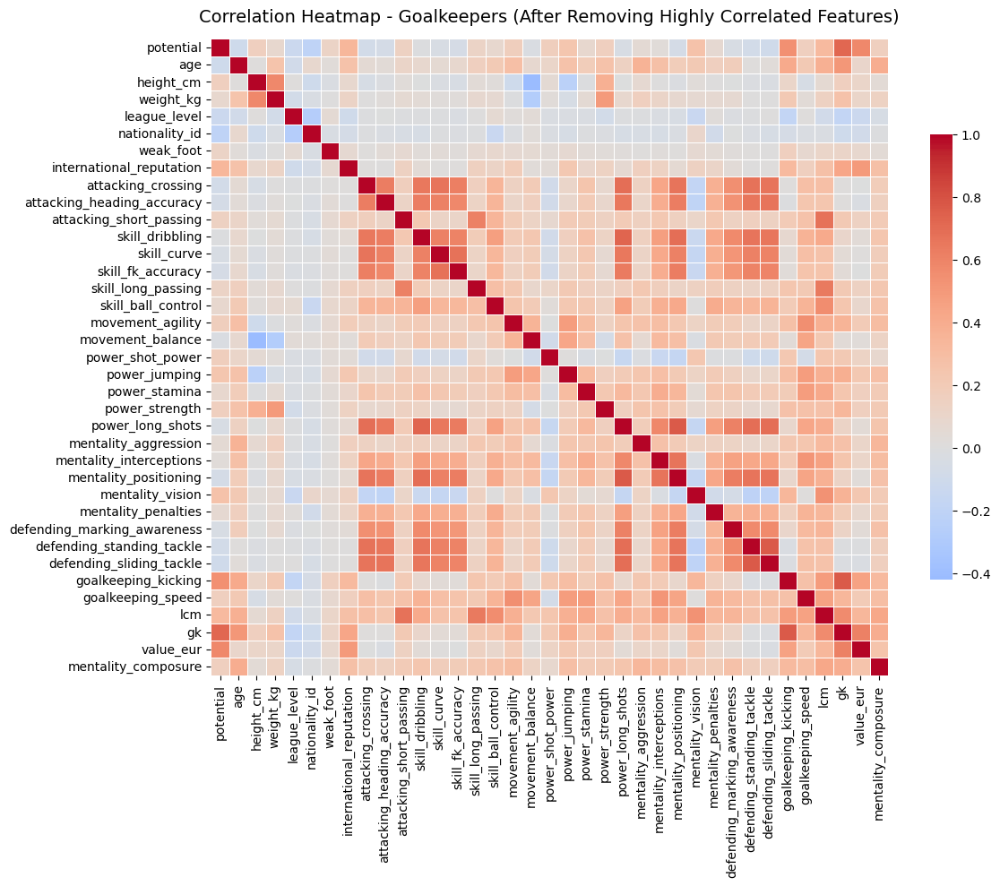

In [392]:
# --- Visualize correlation heatmap for Goalkeepers (after dropping correlated features) ---

# Recompute correlation matrix from cleaned DataFrame
numeric_cols_gk_cln = [c for c, t in df_gk_corr_cln.dtypes if t in ("int", "double")]
corr_matrix_gk_cln = df_gk_corr_cln.select(numeric_cols_gk_cln).toPandas().corr()

# Plot heatmap
plt.figure(figsize=(12, 10))
sb.heatmap(
    corr_matrix_gk_cln,
    annot=False,
    cmap="coolwarm",
    center=0,
    linewidths=0.5,
    cbar_kws={'shrink': 0.7}
)
plt.title("Correlation Heatmap - Goalkeepers (After Removing Highly Correlated Features)", fontsize=14, pad=14)
plt.tight_layout()
plt.show()

### Data Ingestion into Stable Storage (Infrastructure)

In [393]:
df_outfield_columns = """
overall INT, potential INT, wage_eur INT, age INT,
height_cm INT, weight_kg INT, league_name STRING, league_level INT, nationality_id INT,
preferred_foot STRING, weak_foot INT, skill_moves INT, international_reputation INT,
work_rate STRING, body_type STRING, attacking_heading_accuracy INT, skill_curve INT,
skill_fk_accuracy INT, movement_agility INT, movement_balance INT, power_jumping INT,
power_stamina INT, mentality_aggression INT, mentality_penalties INT,
goalkeeping_diving INT, goalkeeping_handling INT, goalkeeping_kicking INT,
goalkeeping_positioning INT, goalkeeping_reflexes INT, lcm INT, lwb INT, gk INT,
gender STRING, value_eur INT, pace INT, physic INT, mentality_composure INT,
player_category STRING
"""

df_gk_columns = """
potential INT, wage_eur INT, age INT, height_cm INT, weight_kg INT,
league_name STRING, league_level INT, nationality_id INT, preferred_foot STRING, weak_foot INT,
international_reputation INT, work_rate STRING, body_type STRING, attacking_crossing INT,
attacking_heading_accuracy INT, attacking_short_passing INT, skill_dribbling INT, skill_curve INT,
skill_fk_accuracy INT, skill_long_passing INT, skill_ball_control INT, movement_agility INT,
movement_balance INT, power_shot_power INT, power_jumping INT, power_stamina INT, power_strength INT,
power_long_shots INT, mentality_aggression INT, mentality_interceptions INT,
mentality_positioning INT, mentality_vision INT, mentality_penalties INT,
defending_marking_awareness INT, defending_standing_tackle INT, defending_sliding_tackle INT,
goalkeeping_kicking INT, goalkeeping_speed INT, lam INT, gk INT,
value_eur INT, release_clause_eur INT, mentality_composure INT, player_category STRING
"""

In [394]:
# --- Database connection properties ---
db_properties = {
    "username": "postgres",
    "password": "saad1234",
    "url": "jdbc:postgresql://localhost:5432/fifa_db",
    "driver": "org.postgresql.Driver"
}

# --- Save Outfield Players ---
outfield_table = "fifa_cleaned.fifa15_22_outfield_cln"

(
    df_outfield_corr_cln.write
    .format("jdbc")
    .mode("overwrite")
    .option("url", db_properties["url"])
    .option("dbtable", outfield_table)
    .option("user", db_properties["username"])
    .option("password", db_properties["password"])
    .option("driver", db_properties["driver"])
    .save()
)

print(f"✅ Outfield DataFrame successfully written to PostgreSQL table: {outfield_table}")

# --- Save Goalkeepers ---
gk_table = "fifa_cleaned.fifa15_22_gk_cln"

(
    df_gk_corr_cln.write
    .format("jdbc")
    .mode("overwrite")
    .option("url", db_properties["url"])
    .option("dbtable", gk_table)
    .option("user", db_properties["username"])
    .option("password", db_properties["password"])
    .option("driver", db_properties["driver"])
    .save()
)

print(f"✅ Goalkeeper DataFrame successfully written to PostgreSQL table: {gk_table}")


✅ Outfield DataFrame successfully written to PostgreSQL table: fifa_cleaned.fifa15_22_outfield_cln
✅ Goalkeeper DataFrame successfully written to PostgreSQL table: fifa_cleaned.fifa15_22_gk_cln


### Import the Processed (Cleansed, Outlier-Handled, and Correlation-Filtered) Data from PostgreSQL

In [5]:
# --- Read Outfield Players DataFrame from PostgreSQL ---

db_properties_outfield = {
    "username": "postgres",
    "password": "saad1234",
    "url": "jdbc:postgresql://localhost:5432/fifa_db",
    "table": "fifa_cleaned.fifa15_22_outfield_cln",  # ✅ updated table
    "driver": "org.postgresql.Driver"
}

df_outfield_pg = (
    spark.read.format("jdbc")
    .option("url", db_properties_outfield["url"])
    .option("dbtable", db_properties_outfield["table"])
    .option("user", db_properties_outfield["username"])
    .option("password", db_properties_outfield["password"])
    .option("driver", db_properties_outfield["driver"])
    .load()
)

# --- Summary ---
row_count_outfield = df_outfield_pg.count()
col_count_outfield = len(df_outfield_pg.columns)

print("✅ Outfield players DataFrame successfully loaded from PostgreSQL.")
print(f"   • Rows: {row_count_outfield:,}")
print(f"   • Columns: {col_count_outfield:,}")
print()

# Display one sample record
df_outfield_pg.show(1, vertical=True)

✅ Outfield players DataFrame successfully loaded from PostgreSQL.
   • Rows: 121,766
   • Columns: 36

-RECORD 0----------------------------------------
 overall                    | 58                 
 potential                  | 59                 
 age                        | 27                 
 height_cm                  | 177                
 weight_kg                  | 70                 
 league_name                | Swiss Super League 
 league_level               | 1                  
 nationality_id             | 27                 
 preferred_foot             | Left               
 weak_foot                  | 3                  
 skill_moves                | 2                  
 international_reputation   | 1                  
 work_rate                  | High/Medium        
 body_type                  | Normal (170-185)   
 attacking_heading_accuracy | 43                 
 skill_curve                | 49                 
 skill_fk_accuracy          | 45               

In [6]:
# --- Read Goalkeepers DataFrame from PostgreSQL ---

db_properties_gk = {
    "username": "postgres",
    "password": "saad1234",
    "url": "jdbc:postgresql://localhost:5432/fifa_db",
    "table": "fifa_cleaned.fifa15_22_gk_cln",  # ✅ updated table
    "driver": "org.postgresql.Driver"
}

df_gk_pg = (
    spark.read.format("jdbc")
    .option("url", db_properties_gk["url"])
    .option("dbtable", db_properties_gk["table"])
    .option("user", db_properties_gk["username"])
    .option("password", db_properties_gk["password"])
    .option("driver", db_properties_gk["driver"])
    .load()
)

# --- Summary ---
row_count_gk = df_gk_pg.count()
col_count_gk = len(df_gk_pg.columns)

print("✅ Goalkeepers DataFrame successfully loaded from PostgreSQL.")
print(f"   • Rows: {row_count_gk:,}")
print(f"   • Columns: {col_count_gk:,}")
print()

# Display one sample record
df_gk_pg.show(1, vertical=True)

✅ Goalkeepers DataFrame successfully loaded from PostgreSQL.
   • Rows: 15,027
   • Columns: 42

-RECORD 0-------------------------------------------
 potential                   | 71                   
 age                         | 25                   
 height_cm                   | 188                  
 weight_kg                   | 72                   
 league_name                 | Spanish Segunda D... 
 league_level                | 2                    
 nationality_id              | 39                   
 preferred_foot              | Right                
 weak_foot                   | 2                    
 international_reputation    | 1                    
 work_rate                   | Medium/Medium        
 body_type                   | Lean (185+)          
 attacking_crossing          | 25                   
 attacking_heading_accuracy  | 13                   
 attacking_short_passing     | 24                   
 skill_dribbling             | 13                   
 s

### Detect and Remove Columns with a Single Distinct Value  

In [7]:
print("=== Checking for Single-Value Columns: Outfield Players ===")

# Detect columns with a single distinct value
single_value_cols_outfield = []
for c, t in df_outfield_pg.dtypes:
    distinct_count = df_outfield_pg.select(F.countDistinct(F.col(c)).alias("distinct_count")).collect()[0]["distinct_count"]
    if distinct_count == 1:
        single_value_cols_outfield.append(c)

# Summary before dropping
before_cols_outfield = len(df_outfield_pg.columns)
before_rows_outfield = df_outfield_pg.count()

if single_value_cols_outfield:
    print("⚠️ Columns with a single distinct value detected:")
    for col_name in single_value_cols_outfield:
        print(f" - {col_name}")
    print(f"Total single-value columns: {len(single_value_cols_outfield)}")

    # Drop columns
    df_outfield_pg = df_outfield_pg.drop(*single_value_cols_outfield)
    after_cols_outfield = len(df_outfield_pg.columns)

    print("\n✅ Dropped single-value columns successfully.")
    print(f"   • Columns: {before_cols_outfield} → {after_cols_outfield}")
    print(f"   • Rows: {before_rows_outfield:,} (unchanged)")
else:
    print("✅ No single-value columns detected.")

=== Checking for Single-Value Columns: Outfield Players ===
✅ No single-value columns detected.


In [8]:
print("=== Checking for Single-Value Columns: Goalkeepers ===")

# Detect columns with a single distinct value
single_value_cols_gk = []
for c, t in df_gk_pg.dtypes:
    distinct_count = df_gk_pg.select(F.countDistinct(F.col(c)).alias("distinct_count")).collect()[0]["distinct_count"]
    if distinct_count == 1:
        single_value_cols_gk.append(c)

# Summary before dropping
before_cols_gk = len(df_gk_pg.columns)
before_rows_gk = df_gk_pg.count()

if single_value_cols_gk:
    print("⚠️ Columns with a single distinct value detected:")
    for col_name in single_value_cols_gk:
        print(f" - {col_name}")
    print(f"Total single-value columns: {len(single_value_cols_gk)}")

    # Drop columns
    df_gk_pg = df_gk_pg.drop(*single_value_cols_gk)
    after_cols_gk = len(df_gk_pg.columns)

    print("\n✅ Dropped single-value columns successfully.")
    print(f"   • Columns: {before_cols_gk} → {after_cols_gk}")
    print(f"   • Rows: {before_rows_gk:,} (unchanged)")
else:
    print("✅ No single-value columns detected.")

=== Checking for Single-Value Columns: Goalkeepers ===
⚠️ Columns with a single distinct value detected:
 - work_rate
 - player_category
Total single-value columns: 2

✅ Dropped single-value columns successfully.
   • Columns: 42 → 40
   • Rows: 15,027 (unchanged)


### Handle Binary Variables

In [9]:
# --- Check for Boolean (binary) columns in Outfield players DataFrame ---
bool_cols_outfield = [c for c, t in df_outfield_pg.dtypes if t == "boolean"]
if bool_cols_outfield:
    print("Boolean columns found in Outfield DataFrame:", bool_cols_outfield)
else:
    print("No Boolean (binary) columns detected in Outfield DataFrame.")

# --- Check for Boolean (binary) columns in Goalkeepers DataFrame ---
bool_cols_gk = [c for c, t in df_gk_pg.dtypes if t == "boolean"]
if bool_cols_gk:
    print("Boolean columns found in Goalkeepers DataFrame:", bool_cols_gk)
else:
    print("No Boolean (binary) columns detected in Goalkeepers DataFrame.")


No Boolean (binary) columns detected in Outfield DataFrame.
No Boolean (binary) columns detected in Goalkeepers DataFrame.


### Handling Ordinal and Nominal Variables

#### Outfield Players

In [10]:
# --- For Outfield Players ---
dtype_groups_outfield = defaultdict(list)
for col_name, dtype in df_outfield_pg.dtypes:
    dtype_groups_outfield[dtype].append(col_name)

print("=== Outfield Players: Columns Grouped by Data Type ===")
for dtype, cols in dtype_groups_outfield.items():
    print(f"\n{dtype.upper()} ({len(cols)} columns):")
    for c in cols:
        print(f" - {c}")

=== Outfield Players: Columns Grouped by Data Type ===

INT (31 columns):
 - overall
 - potential
 - age
 - height_cm
 - weight_kg
 - league_level
 - nationality_id
 - weak_foot
 - skill_moves
 - international_reputation
 - attacking_heading_accuracy
 - skill_curve
 - skill_fk_accuracy
 - movement_agility
 - movement_balance
 - power_jumping
 - power_stamina
 - mentality_aggression
 - mentality_penalties
 - goalkeeping_diving
 - goalkeeping_handling
 - goalkeeping_kicking
 - goalkeeping_positioning
 - goalkeeping_reflexes
 - lcm
 - lwb
 - gk
 - value_eur
 - pace
 - physic
 - mentality_composure

STRING (5 columns):
 - league_name
 - preferred_foot
 - work_rate
 - body_type
 - player_category


In [11]:
# --- Handle Nominal Variables for Outfield Players ---
# We don't have any ordinal variables.

# Step 1–5: Transform string columns to numeric and one-hot encode
stage_1 = StringIndexer(inputCol='league_name',       outputCol='league_name_index', handleInvalid="keep")
stage_2 = StringIndexer(inputCol='preferred_foot',    outputCol='preferred_foot_index', handleInvalid="keep")
stage_3 = StringIndexer(inputCol='work_rate',         outputCol='work_rate_index', handleInvalid="keep")
stage_4 = StringIndexer(inputCol='body_type',         outputCol='body_type_index', handleInvalid="keep")
stage_5 = StringIndexer(inputCol='player_category',   outputCol='player_category_index', handleInvalid="keep")

# One-hot encode the indexed columns
stage_6 = OneHotEncoder(
    inputCols=[
        "league_name_index", "preferred_foot_index", "work_rate_index",
        "body_type_index", "player_category_index"
    ],
    outputCols=[
        "league_name_encoded", "preferred_foot_encoded", "work_rate_encoded",
        "body_type_encoded", "player_category_encoded"
    ]
)

# Setup pipeline
pipeline_outfield = Pipeline(stages=[stage_1, stage_2, stage_3, stage_4, stage_5, stage_6])

# Fit and transform
pipeline_model_outfield = pipeline_outfield.fit(df_outfield_pg)
df_outfield_encoded = pipeline_model_outfield.transform(df_outfield_pg)

print("✅ String columns encoded successfully for Outfield players (excluding gender).")
df_outfield_encoded.select(
    "league_name", "preferred_foot", "work_rate", "body_type", "player_category",
    "league_name_encoded", "preferred_foot_encoded", "work_rate_encoded",
    "body_type_encoded", "player_category_encoded"
).show(1, vertical=True)


✅ String columns encoded successfully for Outfield players (excluding gender).
-RECORD 0-------------------------------------
 league_name             | Swiss Super League 
 preferred_foot          | Left               
 work_rate               | High/Medium        
 body_type               | Normal (170-185)   
 player_category         | Midfielder         
 league_name_encoded     | (57,[31],[1.0])    
 preferred_foot_encoded  | (2,[1],[1.0])      
 work_rate_encoded       | (9,[1],[1.0])      
 body_type_encoded       | (10,[0],[1.0])     
 player_category_encoded | (3,[0],[1.0])      
only showing top 1 row


#### Goalkeeper

In [12]:
# --- For Goalkeepers ---
dtype_groups_gk = defaultdict(list)
for col_name, dtype in df_gk_pg.dtypes:
    dtype_groups_gk[dtype].append(col_name)

print("\n\n=== Goalkeepers: Columns Grouped by Data Type ===")
for dtype, cols in dtype_groups_gk.items():
    print(f"\n{dtype.upper()} ({len(cols)} columns):")
    for c in cols:
        print(f" - {c}")



=== Goalkeepers: Columns Grouped by Data Type ===

INT (37 columns):
 - potential
 - age
 - height_cm
 - weight_kg
 - league_level
 - nationality_id
 - weak_foot
 - international_reputation
 - attacking_crossing
 - attacking_heading_accuracy
 - attacking_short_passing
 - skill_dribbling
 - skill_curve
 - skill_fk_accuracy
 - skill_long_passing
 - skill_ball_control
 - movement_agility
 - movement_balance
 - power_shot_power
 - power_jumping
 - power_stamina
 - power_strength
 - power_long_shots
 - mentality_aggression
 - mentality_interceptions
 - mentality_positioning
 - mentality_vision
 - mentality_penalties
 - defending_marking_awareness
 - defending_standing_tackle
 - defending_sliding_tackle
 - goalkeeping_kicking
 - goalkeeping_speed
 - lcm
 - gk
 - value_eur
 - mentality_composure

STRING (3 columns):
 - league_name
 - preferred_foot
 - body_type


In [13]:
# --- Handle Nominal Variables for Goalkeepers ---
# We don't have any ordinal variables.

# Step 1–3: Transform remaining string columns to numeric and one-hot encode
stage_1 = StringIndexer(inputCol='league_name',    outputCol='league_name_index', handleInvalid="keep")
stage_2 = StringIndexer(inputCol='preferred_foot', outputCol='preferred_foot_index', handleInvalid="keep")
stage_3 = StringIndexer(inputCol='body_type',      outputCol='body_type_index', handleInvalid="keep")

# One-hot encode the indexed columns
stage_4 = OneHotEncoder(
    inputCols=["league_name_index", "preferred_foot_index", "body_type_index"],
    outputCols=["league_name_encoded", "preferred_foot_encoded", "body_type_encoded"]
)

# Setup pipeline
pipeline_gk = Pipeline(stages=[stage_1, stage_2, stage_3, stage_4])

# Fit and transform
pipeline_model_gk = pipeline_gk.fit(df_gk_pg)
df_gk_encoded = pipeline_model_gk.transform(df_gk_pg)

print("✅ String columns encoded successfully for Goalkeepers (excluding dropped features).")
df_gk_encoded.select(
    "league_name", "preferred_foot", "body_type",
    "league_name_encoded", "preferred_foot_encoded", "body_type_encoded"
).show(1, vertical=True)


✅ String columns encoded successfully for Goalkeepers (excluding dropped features).
-RECORD 0--------------------------------------
 league_name            | Spanish Segunda D... 
 preferred_foot         | Right                
 body_type              | Lean (185+)          
 league_name_encoded    | (57,[4],[1.0])       
 preferred_foot_encoded | (2,[0],[1.0])        
 body_type_encoded      | (9,[1],[1.0])        
only showing top 1 row


### Assemble Features into Vector

#### Outfield Players

In [14]:
# --- Assemble Features into Vector for Outfield Players ---
# The target column (outcome variable) must not be included in the features
target_col = "value_eur"

# Exclude non-feature and categorical source columns
feature_list_outfield = df_outfield_encoded.drop(
    # original nominal columns + their index (keep *_encoded)
    "league_name", "league_name_index",
    "preferred_foot", "preferred_foot_index",
    "work_rate", "work_rate_index",
    "body_type", "body_type_index",
    "player_category", "player_category_index",
    # exclude target
    target_col
).columns

print("Number of features (Outfield):", len(feature_list_outfield))
print(feature_list_outfield[:10])  # peek first few

# Assemble features into a single vector
assembler_outfield = VectorAssembler(
    inputCols=feature_list_outfield,
    outputCol="features"
)

df_outfield_vector = assembler_outfield.transform(df_outfield_encoded)
print("✅ Feature vector assembled for Outfield Players.")
df_outfield_vector.select("features", target_col).show(1, truncate=False, vertical=True)

Number of features (Outfield): 35
['overall', 'potential', 'age', 'height_cm', 'weight_kg', 'league_level', 'nationality_id', 'weak_foot', 'skill_moves', 'international_reputation']
✅ Feature vector assembled for Outfield Players.
-RECORD 0------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 features  | (111,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,61,88,90,98,108],[58.0,59.0,27.0,177.0,70.0,1.0,27.0,3.0,2.0,1.0,43.0,49.0,45.0,63.0,72.0,54.0,44.0,43.0,44.0,11.0,10.0,10.0,9.0,15.0,54.0,51.0,14.0,64.0,46.0,60.0,1.0,1.0,1.0,1.0,1.0]) 
 value_eur | 150000                                                                                                                                                                                  

#### Goalkeeper

In [15]:
# --- Assemble Features into Vector for Goalkeepers ---
# The target column (outcome variable) must not be included in the features
target_col = "value_eur"

# Exclude non-feature and categorical source columns
feature_list_gk = df_gk_encoded.drop(
    # original nominal columns + their index (keep *_encoded)
    "league_name", "league_name_index",
    "preferred_foot", "preferred_foot_index",
    "body_type", "body_type_index",
    # exclude target
    target_col
).columns

print("Number of features (Goalkeepers):", len(feature_list_gk))
print(feature_list_gk[:10])  # peek first few

# Assemble features into a single vector
assembler_gk = VectorAssembler(
    inputCols=feature_list_gk,
    outputCol="features"
)

df_gk_vector = assembler_gk.transform(df_gk_encoded)
print("✅ Feature vector assembled for Goalkeepers.")
df_gk_vector.select("features", target_col).show(1, truncate=False, vertical=True)


Number of features (Goalkeepers): 39
['potential', 'age', 'height_cm', 'weight_kg', 'league_level', 'nationality_id', 'weak_foot', 'international_reputation', 'attacking_crossing', 'attacking_heading_accuracy']
✅ Feature vector assembled for Goalkeepers.
-RECORD 0-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
 features  | (104,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,40,93,96],[71.0,25.0,188.0,72.0,2.0,39.0,2.0,1.0,25.0,13.0,24.0,13.0,25.0,22.0,21.0,13.0,55.0,53.0,22.0,68.0,42.0,48.0,12.0,28.0,17.0,13.0,30.0,23.0,14.0,20.0,16.0,57.0,49.0,24.0,67.0,33.0,1.0,1.0,1.0]) 
 value_eur | 775000                                                                                    

### Data Splitting and Scaling

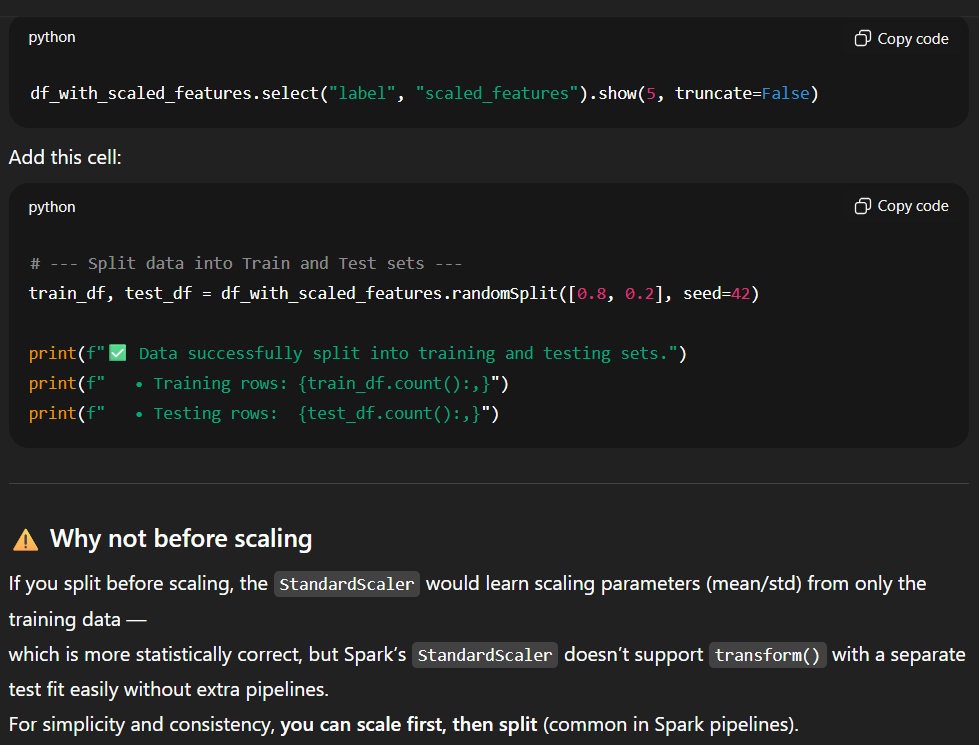

In [16]:
Image("p3_GPTFalsyResponse.png")

#### Outfield Players

In [17]:
# --- Step 1: Log-transform the target variable ---
df_outfield_vector = df_outfield_vector.withColumn("log_value_eur", F.log1p(F.col("value_eur")))

# --- Step 2: Split data BEFORE scaling ---
train_outfield, test_outfield = df_outfield_vector.randomSplit([0.8, 0.2], seed=42)

# --- Step 3: Scale features using StandardScaler ---
scaler_outfield = StandardScaler(
    inputCol="features",
    outputCol="scaled_features",
    withMean=True,
    withStd=True
)
scaler_model_outfield = scaler_outfield.fit(train_outfield)
train_outfield_scaled = scaler_model_outfield.transform(train_outfield)
test_outfield_scaled = scaler_model_outfield.transform(test_outfield)

# --- Step 4: Add label column (log-transformed target) ---
train_outfield_scaled = train_outfield_scaled.withColumn("label", F.col("log_value_eur").cast("double"))
test_outfield_scaled = test_outfield_scaled.withColumn("label", F.col("log_value_eur").cast("double"))

# --- Summary ---
print("✅ Outfield Players split, log-transformed, and scaled successfully.")
print(f"   • Training rows: {train_outfield_scaled.count():,}")
print(f"   • Testing rows:  {test_outfield_scaled.count():,}")
print(f"   • Vector length: {len(train_outfield_scaled.select('scaled_features').first()['scaled_features'])}")


✅ Outfield Players split, log-transformed, and scaled successfully.
   • Training rows: 97,273
   • Testing rows:  24,493
   • Vector length: 111


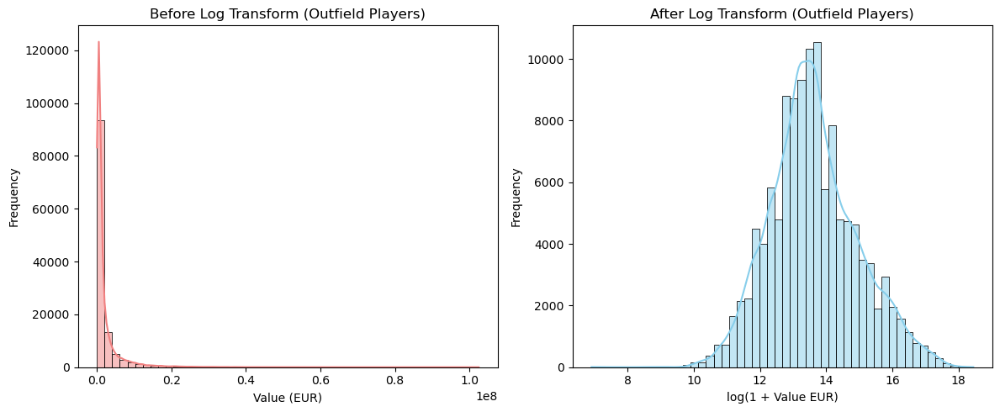

In [18]:
# --- Convert to Pandas
outfield_pd = df_outfield_vector.select("value_eur").toPandas()

# --- Compute log-transformed values ---
outfield_pd["log_value_eur"] = np.log1p(outfield_pd["value_eur"])

# --- Create side-by-side histograms ---
plt.figure(figsize=(12, 5))

# Before log transform
plt.subplot(1, 2, 1)
sb.histplot(outfield_pd["value_eur"], bins=50, color="lightcoral", kde=True)
plt.title("Before Log Transform (Outfield Players)", fontsize=12)
plt.xlabel("Value (EUR)")
plt.ylabel("Frequency")

# After log transform
plt.subplot(1, 2, 2)
sb.histplot(outfield_pd["log_value_eur"], bins=50, color="skyblue", kde=True)
plt.title("After Log Transform (Outfield Players)", fontsize=12)
plt.xlabel("log(1 + Value EUR)")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()


In [24]:
# --- SANITY CHECK: Verify the label column ---
print("Sanity Check: Comparing label vs. log_value_eur")
train_outfield_scaled.select("label", "log_value_eur", "value_eur").show(5)
print()


Sanity Check: Comparing label vs. log_value_eur
+------------------+------------------+---------+
|             label|     log_value_eur|value_eur|
+------------------+------------------+---------+
| 10.12667110305036| 10.12667110305036|    25000|
| 10.12667110305036| 10.12667110305036|    25000|
|  9.90353755128617|  9.90353755128617|    20000|
| 10.12667110305036| 10.12667110305036|    25000|
|10.819798284210286|10.819798284210286|    50000|
+------------------+------------------+---------+
only showing top 5 rows



#### Goalkeeper

In [20]:
# --- Step 1: Log-transform the target variable ---
df_gk_vector = df_gk_vector.withColumn("log_value_eur", F.log1p(F.col("value_eur")))

# --- Step 2: Split data BEFORE scaling ---
train_gk, test_gk = df_gk_vector.randomSplit([0.8, 0.2], seed=42)

# --- Step 3: Scale features using StandardScaler ---
scaler_gk = StandardScaler(
    inputCol="features",
    outputCol="scaled_features",
    withMean=True,
    withStd=True
)
scaler_model_gk = scaler_gk.fit(train_gk)

train_gk_scaled = scaler_model_gk.transform(train_gk)
test_gk_scaled = scaler_model_gk.transform(test_gk)

# --- Step 4: Add label column (log-transformed target) ---
train_gk_scaled = train_gk_scaled.withColumn("label", F.col("log_value_eur").cast("double"))
test_gk_scaled = test_gk_scaled.withColumn("label", F.col("log_value_eur").cast("double"))


# --- Summary ---
print("✅ Goalkeepers split, log-transformed, and scaled successfully.")
print(f"   • Training rows: {train_gk_scaled.count():,}")
print(f"   • Testing rows:  {test_gk_scaled.count():,}")
print(f"   • Vector length: {len(train_gk_scaled.select('scaled_features').first()['scaled_features'])}")


✅ Goalkeepers split, log-transformed, and scaled successfully.
   • Training rows: 12,081
   • Testing rows:  2,946
   • Vector length: 104


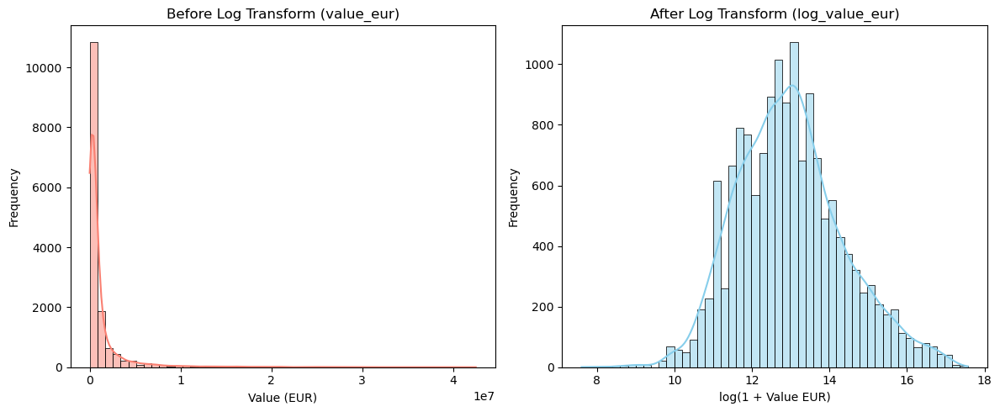

In [21]:
# --- Convert to Pandas
gk_pd = df_gk_vector.select("value_eur").toPandas()

# --- Compute log-transformed column ---
gk_pd["log_value_eur"] = np.log1p(gk_pd["value_eur"])

# --- Create side-by-side histograms ---
plt.figure(figsize=(12, 5))

# Before log transform
plt.subplot(1, 2, 1)
sb.histplot(gk_pd["value_eur"], bins=50, color="salmon", kde=True)
plt.title("Before Log Transform (value_eur)")
plt.xlabel("Value (EUR)")
plt.ylabel("Frequency")

# After log transform
plt.subplot(1, 2, 2)
sb.histplot(gk_pd["log_value_eur"], bins=50, color="skyblue", kde=True)
plt.title("After Log Transform (log_value_eur)")
plt.xlabel("log(1 + Value EUR)")
plt.ylabel("Frequency")

plt.tight_layout()
plt.show()


In [23]:
# --- SANITY CHECK: Verify the label column ---
print("Sanity Check: Comparing label vs. log_value_eur")
train_gk_scaled.select("label", "log_value_eur", "value_eur").show(5)
print()


Sanity Check: Comparing label vs. log_value_eur
+------------------+------------------+---------+
|             label|     log_value_eur|value_eur|
+------------------+------------------+---------+
| 9.210440366976517| 9.210440366976517|    10000|
|10.308985993422082|10.308985993422082|    30000|
| 8.699681400989514| 8.699681400989514|     6000|
| 8.699681400989514| 8.699681400989514|     6000|
| 8.699681400989514| 8.699681400989514|     6000|
+------------------+------------------+---------+
only showing top 5 rows



## Machine Learning - Spark

### Model 1: Linear Regression

In [44]:
# --- Linear Regression Stage ---
class LinearRegressionStage:
    def __init__(self, featuresCol="features", labelCol="label"):
        self.featuresCol = featuresCol
        self.labelCol = labelCol

    def build(self):
        return LinearRegression(
            featuresCol=self.featuresCol,
            labelCol=self.labelCol
        )


# --- Parameter Grid Class ---
class LRParamGrid:
    def __init__(self, lr_estimator):
        self.lr = lr_estimator

    def build(self):
        return (
            ParamGridBuilder()
            .addGrid(self.lr.regParam, [0, 0.01, 0.1 , 1])
            .addGrid(self.lr.maxIter, [30, 50, 70, 100])
            .build()
        )


# --- Cross-Validator Wrapper Class ---
class CrossValidatorStage:
    def __init__(self, metricName="rmse", labelCol="label", predictionCol="prediction", numFolds=5):
        self.metricName = metricName
        self.labelCol = labelCol
        self.predictionCol = predictionCol
        self.numFolds = numFolds

    def build(self, estimator, paramGrid):
        evaluator = RegressionEvaluator(
            labelCol=self.labelCol,
            predictionCol=self.predictionCol,
            metricName=self.metricName
        )
        return CrossValidator(
            estimator=estimator,
            estimatorParamMaps=paramGrid,
            evaluator=evaluator,
            numFolds=self.numFolds,
            parallelism=2
        )

#### Outfield Players

In [45]:
# --- Run Cross-Validation for Outfield Players (training only) ---

# Initialize stages
lr_stage = LinearRegressionStage(featuresCol="scaled_features", labelCol="label")
lr = lr_stage.build()

param_grid = LRParamGrid(lr).build()

# --- 1. Set up CV for RMSE (the primary metric for finding the best model) ---
cv_stage_rmse = CrossValidatorStage(metricName="rmse", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_rmse = cv_stage_rmse.build(lr, param_grid)

# --- 2. Set up CV for R² (to get the R² validation metric) ---
cv_stage_r2 = CrossValidatorStage(metricName="r2", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_r2 = cv_stage_r2.build(lr, param_grid)

# --- 3. Fit both cross-validation models ---
print("Fitting Cross-Validator for RMSE...")
cv_model_rmse = crossval_rmse.fit(train_outfield_scaled)
print("Fitting Cross-Validator for R²...")
cv_model_r2 = crossval_r2.fit(train_outfield_scaled)

# --- 4. Display cross-validation results (from validation folds) ---
print("\n=== Cross-Validation Results: Linear Regression (Outfield Players) ===")
param_maps = cv_model_rmse.getEstimatorParamMaps()
avg_metrics_rmse = cv_model_rmse.avgMetrics
avg_metrics_r2 = cv_model_r2.avgMetrics

for i, (params, rmse, r2) in enumerate(zip(param_maps, avg_metrics_rmse, avg_metrics_r2)):
    print(f"Trial {i+1:02d} → regParam={params[lr.regParam]:<4} | maxIter={params[lr.maxIter]:<3} | Val. RMSE={rmse:.3f} | Val. R²={r2:.3f}")

# --- You can now use 'cv_model_rmse' in your separate test script ---
# --- We'll use the RMSE-optimized one as the primary 'cv_model' ---
cv_model = cv_model_rmse
print("\n✅ CV model for Outfield Players is trained (optimized for RMSE).")

Fitting Cross-Validator for RMSE...
Fitting Cross-Validator for R²...

=== Cross-Validation Results: Linear Regression (Outfield Players) ===
Trial 01 → regParam=0.0  | maxIter=30  | Val. RMSE=0.302 | Val. R²=0.948
Trial 02 → regParam=0.0  | maxIter=50  | Val. RMSE=0.302 | Val. R²=0.948
Trial 03 → regParam=0.0  | maxIter=70  | Val. RMSE=0.302 | Val. R²=0.948
Trial 04 → regParam=0.0  | maxIter=100 | Val. RMSE=0.302 | Val. R²=0.948
Trial 05 → regParam=0.01 | maxIter=30  | Val. RMSE=0.304 | Val. R²=0.948
Trial 06 → regParam=0.01 | maxIter=50  | Val. RMSE=0.304 | Val. R²=0.948
Trial 07 → regParam=0.01 | maxIter=70  | Val. RMSE=0.304 | Val. R²=0.948
Trial 08 → regParam=0.01 | maxIter=100 | Val. RMSE=0.304 | Val. R²=0.948
Trial 09 → regParam=0.1  | maxIter=30  | Val. RMSE=0.340 | Val. R²=0.935
Trial 10 → regParam=0.1  | maxIter=50  | Val. RMSE=0.340 | Val. R²=0.935
Trial 11 → regParam=0.1  | maxIter=70  | Val. RMSE=0.340 | Val. R²=0.935
Trial 12 → regParam=0.1  | maxIter=100 | Val. RMSE=0.34

In [46]:
# --- Evaluate Tuned Linear Regression Model on Test Data (Outfield Players) ---

# Use the best model obtained from cross-validation
best_model_outfield = cv_model.bestModel

# Generate predictions on the held-out test set
predictions_outfield_test = best_model_outfield.transform(test_outfield_scaled)

# Initialize regression evaluators for RMSE and R²
evaluator_rmse = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="rmse"
)
evaluator_r2 = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="r2"
)

# Compute test metrics
rmse_test_outfield = evaluator_rmse.evaluate(predictions_outfield_test)
r2_test_outfield = evaluator_r2.evaluate(predictions_outfield_test)

# Display evaluation summary
print("=== Test Evaluation: Linear Regression (Outfield Players) ===")
print(f"RMSE (Test): {rmse_test_outfield:,.3f}")
print(f"R² (Test):   {r2_test_outfield:.3f}")

# Show a few predicted vs actual values
predictions_outfield_test.select("label", "prediction").show(5, truncate=False, vertical=True)

=== Test Evaluation: Linear Regression (Outfield Players) ===
RMSE (Test): 0.298
R² (Test):   0.949
-RECORD 0------------------------
 label      | 10.12667110305036  
 prediction | 9.383359342458316  
-RECORD 1------------------------
 label      | 11.002116507732017 
 prediction | 9.561438566216552  
-RECORD 2------------------------
 label      | 11.002116507732017 
 prediction | 9.727323431178558  
-RECORD 3------------------------
 label      | 9.90353755128617   
 prediction | 9.667515810187401  
-RECORD 4------------------------
 label      | 11.002116507732017 
 prediction | 9.825890104293695  
only showing top 5 rows


#### Goalkeeper

In [47]:
# --- Run Cross-Validation for Goalkeepers (training only) ---

# Initialize stages
lr_stage = LinearRegressionStage(featuresCol="scaled_features", labelCol="label")
lr = lr_stage.build()

param_grid = LRParamGrid(lr).build()

# --- 1. Set up CV for RMSE (the primary metric for finding the best model) ---
cv_stage_rmse = CrossValidatorStage(metricName="rmse", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_rmse = cv_stage_rmse.build(lr, param_grid)

# --- 2. Set up CV for R² (to get the R² validation metric) ---
cv_stage_r2 = CrossValidatorStage(metricName="r2", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_r2 = cv_stage_r2.build(lr, param_grid)

# --- 3. Fit both cross-validation models ---
print("Fitting Cross-Validator for RMSE...")
cv_model_rmse = crossval_rmse.fit(train_gk_scaled)
print("Fitting Cross-Validator for R²...")
cv_model_r2 = crossval_r2.fit(train_gk_scaled)

# --- 4. Display cross-validation results (from validation folds) ---
print("\n=== Cross-Validation Results: Linear Regression (Goalkeepers) ===")
param_maps = cv_model_rmse.getEstimatorParamMaps()
avg_metrics_rmse = cv_model_rmse.avgMetrics
avg_metrics_r2 = cv_model_r2.avgMetrics

for i, (params, rmse, r2) in enumerate(zip(param_maps, avg_metrics_rmse, avg_metrics_r2)):
    print(f"Trial {i+1:02d} → regParam={params[lr.regParam]:<4} | maxIter={params[lr.maxIter]:<3} | Val. RMSE={rmse:.3f} | Val. R²={r2:.3f}")

# --- You can now use 'cv_model_rmse' in your separate test script ---
# --- We'll use the RMSE-optimized one as the primary 'cv_model' ---
cv_model = cv_model_rmse
print("\n✅ CV model for Goalkeepers is trained (optimized for RMSE).")

Fitting Cross-Validator for RMSE...
Fitting Cross-Validator for R²...

=== Cross-Validation Results: Linear Regression (Goalkeepers) ===
Trial 01 → regParam=0.0  | maxIter=30  | Val. RMSE=0.370 | Val. R²=0.928
Trial 02 → regParam=0.0  | maxIter=50  | Val. RMSE=0.370 | Val. R²=0.928
Trial 03 → regParam=0.0  | maxIter=70  | Val. RMSE=0.370 | Val. R²=0.928
Trial 04 → regParam=0.0  | maxIter=100 | Val. RMSE=0.370 | Val. R²=0.928
Trial 05 → regParam=0.01 | maxIter=30  | Val. RMSE=0.373 | Val. R²=0.927
Trial 06 → regParam=0.01 | maxIter=50  | Val. RMSE=0.373 | Val. R²=0.927
Trial 07 → regParam=0.01 | maxIter=70  | Val. RMSE=0.373 | Val. R²=0.927
Trial 08 → regParam=0.01 | maxIter=100 | Val. RMSE=0.373 | Val. R²=0.927
Trial 09 → regParam=0.1  | maxIter=30  | Val. RMSE=0.429 | Val. R²=0.903
Trial 10 → regParam=0.1  | maxIter=50  | Val. RMSE=0.429 | Val. R²=0.903
Trial 11 → regParam=0.1  | maxIter=70  | Val. RMSE=0.429 | Val. R²=0.903
Trial 12 → regParam=0.1  | maxIter=100 | Val. RMSE=0.429 | V

In [48]:
# --- Evaluate Tuned Linear Regression Model on Test Data (Goalkeepers) ---

# Use the best model obtained from cross-validation
best_model_gk = cv_model.bestModel

# Generate predictions on the held-out test set
predictions_gk_test = best_model_gk.transform(test_gk_scaled)

# Initialize regression evaluators for RMSE and R²
evaluator_rmse = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="rmse"
)
evaluator_r2 = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="r2"
)

# Compute test metrics
rmse_test_gk = evaluator_rmse.evaluate(predictions_gk_test)
r2_test_gk = evaluator_r2.evaluate(predictions_gk_test)

# Display evaluation summary
print("=== Test Evaluation: Linear Regression (Goalkeepers) ===")
print(f"RMSE (Test): {rmse_test_gk:,.3f}")
print(f"R² (Test):   {r2_test_gk:.3f}")

# Show a few predicted vs actual values
predictions_gk_test.select("label", "prediction").show(5, truncate=False, vertical=True)

=== Test Evaluation: Linear Regression (Goalkeepers) ===
RMSE (Test): 0.370
R² (Test):   0.929
-RECORD 0------------------------
 label      | 7.601402334583733  
 prediction | 7.704271146072711  
-RECORD 1------------------------
 label      | 10.12667110305036  
 prediction | 9.35990940126807   
-RECORD 2------------------------
 label      | 10.12667110305036  
 prediction | 10.073285806195777 
-RECORD 3------------------------
 label      | 10.463131911491967 
 prediction | 10.069683231243964 
-RECORD 4------------------------
 label      | 10.463131911491967 
 prediction | 9.093621861344896  
only showing top 5 rows


### Model 2: Random Forest

#### Common Setup

In [49]:
# --- Random Forest Stage ---
class RandomForestStage:
    def __init__(self, featuresCol="features", labelCol="label"):
        self.featuresCol = featuresCol
        self.labelCol = labelCol

    def build(self):
        return RandomForestRegressor(
            featuresCol=self.featuresCol,
            labelCol=self.labelCol,
            seed=42
        )


# --- Parameter Grid Class ---
class RFParamGrid:
    def __init__(self, rf_estimator):
        self.rf = rf_estimator

    def build(self):
        return (
            ParamGridBuilder()
            .addGrid(self.rf.numTrees, [5, 15, 30, 50])
            .addGrid(self.rf.maxDepth, [3, 5, 10, 15])
            .build()
        )


# --- Cross-Validator Wrapper Class ---
class CrossValidatorStage:
    def __init__(self, metricName="rmse", labelCol="label", predictionCol="prediction", numFolds=5):
        self.metricName = metricName
        self.labelCol = labelCol
        self.predictionCol = predictionCol
        self.numFolds = numFolds

    def build(self, estimator, paramGrid):
        evaluator = RegressionEvaluator(
            labelCol=self.labelCol,
            predictionCol=self.predictionCol,
            metricName=self.metricName
        )
        return CrossValidator(
            estimator=estimator,
            estimatorParamMaps=paramGrid,
            evaluator=evaluator,
            numFolds=self.numFolds,
            parallelism=2
        )

#### Outfield Players

In [50]:
# --- Run Cross-Validation for Outfield Players (training only) ---

# Initialize stages
rf_stage = RandomForestStage(featuresCol="scaled_features", labelCol="label")
rf = rf_stage.build()

param_grid = RFParamGrid(rf).build()

# --- 1. Set up CV for RMSE (the primary metric for finding the best model) ---
cv_stage_rmse = CrossValidatorStage(metricName="rmse", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_rmse = cv_stage_rmse.build(rf, param_grid)

# --- 2. Set up CV for R² (to get the R² validation metric) ---
cv_stage_r2 = CrossValidatorStage(metricName="r2", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_r2 = cv_stage_r2.build(rf, param_grid)

# --- 3. Fit both cross-validation models ---
print("Fitting Cross-Validator for RMSE...")
cv_model_rmse = crossval_rmse.fit(train_outfield_scaled)
print("Fitting Cross-Validator for R²...")
cv_model_r2 = crossval_r2.fit(train_outfield_scaled)

# --- 4. Display cross-validation results (from validation folds) ---
print("\n=== Cross-Validation Results: Random Forest (Outfield Players) ===")
param_maps = cv_model_rmse.getEstimatorParamMaps()
avg_metrics_rmse = cv_model_rmse.avgMetrics
avg_metrics_r2 = cv_model_r2.avgMetrics

for i, (params, rmse, r2) in enumerate(zip(param_maps, avg_metrics_rmse, avg_metrics_r2)):
    print(f"Trial {i+1:02d} → numTrees={params[rf.numTrees]:<3} | maxDepth={params[rf.maxDepth]:<2} | Val. RMSE={rmse:.3f} | Val. R²={r2:.3f}")

# --- You can now use 'cv_model_rmse' in your separate test script ---
# --- We'll use the RMSE-optimized one as the primary 'cv_model' ---
cv_model = cv_model_rmse
print("\n✅ CV model for Outfield Players is trained (optimized for RMSE).")

Fitting Cross-Validator for RMSE...
Fitting Cross-Validator for R²...

=== Cross-Validation Results: Random Forest (Outfield Players) ===
Trial 01 → numTrees=5   | maxDepth=3  | Val. RMSE=0.521 | Val. R²=0.846
Trial 02 → numTrees=5   | maxDepth=5  | Val. RMSE=0.397 | Val. R²=0.911
Trial 03 → numTrees=5   | maxDepth=10 | Val. RMSE=0.287 | Val. R²=0.953
Trial 04 → numTrees=5   | maxDepth=15 | Val. RMSE=0.272 | Val. R²=0.958
Trial 05 → numTrees=15  | maxDepth=3  | Val. RMSE=0.518 | Val. R²=0.848
Trial 06 → numTrees=15  | maxDepth=5  | Val. RMSE=0.380 | Val. R²=0.918
Trial 07 → numTrees=15  | maxDepth=10 | Val. RMSE=0.276 | Val. R²=0.957
Trial 08 → numTrees=15  | maxDepth=15 | Val. RMSE=0.256 | Val. R²=0.963
Trial 09 → numTrees=30  | maxDepth=3  | Val. RMSE=0.528 | Val. R²=0.842
Trial 10 → numTrees=30  | maxDepth=5  | Val. RMSE=0.386 | Val. R²=0.915
Trial 11 → numTrees=30  | maxDepth=10 | Val. RMSE=0.275 | Val. R²=0.957
Trial 12 → numTrees=30  | maxDepth=15 | Val. RMSE=0.252 | Val. R²=0.96

In [51]:
# --- Evaluate Tuned Random Forest Model on Test Data (Outfield Players) ---

# Use the best model obtained from cross-validation
best_model_outfield = cv_model.bestModel

# Generate predictions on the held-out test set
predictions_outfield_test = best_model_outfield.transform(test_outfield_scaled)

# Initialize regression evaluators for RMSE and R²
evaluator_rmse = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="rmse"
)
evaluator_r2 = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="r2"
)

# Compute test metrics
rmse_test_outfield = evaluator_rmse.evaluate(predictions_outfield_test)
r2_test_outfield = evaluator_r2.evaluate(predictions_outfield_test)

# Display evaluation summary
print("=== Test Evaluation: Random Forest (Outfield Players) ===")
print(f"RMSE (Test): {rmse_test_outfield:,.2f}")
print(f"R² (Test):   {r2_test_outfield:.3f}")

# Show a few predicted vs actual values
predictions_outfield_test.select("label", "prediction").show(5, truncate=False, vertical=True)

=== Test Evaluation: Random Forest (Outfield Players) ===
RMSE (Test): 0.24
R² (Test):   0.967
-RECORD 0------------------------
 label      | 10.12667110305036  
 prediction | 10.400758406357108 
-RECORD 1------------------------
 label      | 11.002116507732017 
 prediction | 10.381145496237764 
-RECORD 2------------------------
 label      | 11.002116507732017 
 prediction | 10.519008065493406 
-RECORD 3------------------------
 label      | 9.90353755128617   
 prediction | 10.169663409334284 
-RECORD 4------------------------
 label      | 11.002116507732017 
 prediction | 10.576044981843317 
only showing top 5 rows


#### Goalkeeper

In [52]:
# --- Run Cross-Validation for Goalkeepers (training only) ---

# Initialize stages
rf_stage = RandomForestStage(featuresCol="scaled_features", labelCol="label")
rf = rf_stage.build()

param_grid = RFParamGrid(rf).build()

# --- 1. Set up CV for RMSE (the primary metric for finding the best model) ---
cv_stage_rmse = CrossValidatorStage(metricName="rmse", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_rmse = cv_stage_rmse.build(rf, param_grid)

# --- 2. Set up CV for R² (to get the R² validation metric) ---
cv_stage_r2 = CrossValidatorStage(metricName="r2", labelCol="label", predictionCol="prediction", numFolds=5)
crossval_r2 = cv_stage_r2.build(rf, param_grid)

# --- 3. Fit both cross-validation models ---
print("Fitting Cross-Validator for RMSE...")
cv_model_rmse = crossval_rmse.fit(train_gk_scaled)
print("Fitting Cross-Validator for R²...")
cv_model_r2 = crossval_r2.fit(train_gk_scaled)

# --- 4. Display cross-validation results (from validation folds) ---
print("\n=== Cross-Validation Results: Random Forest (Goalkeepers) ===")
param_maps = cv_model_rmse.getEstimatorParamMaps()
avg_metrics_rmse = cv_model_rmse.avgMetrics
avg_metrics_r2 = cv_model_r2.avgMetrics

for i, (params, rmse, r2) in enumerate(zip(param_maps, avg_metrics_rmse, avg_metrics_r2)):
    print(f"Trial {i+1:02d} → numTrees={params[rf.numTrees]:<3} | maxDepth={params[rf.maxDepth]:<2} | Val. RMSE={rmse:.3f} | Val. R²={r2:.3f}")

# --- You can now use 'cv_model_rmse' in your separate test script ---
# --- We'll use the RMSE-optimized one as the primary 'cv_model' ---
cv_model = cv_model_rmse
print("\n✅ CV model for Goalkeepers is trained (optimized for RMSE).")

Fitting Cross-Validator for RMSE...
Fitting Cross-Validator for R²...

=== Cross-Validation Results: Random Forest (Goalkeepers) ===
Trial 01 → numTrees=5   | maxDepth=3  | Val. RMSE=0.649 | Val. R²=0.779
Trial 02 → numTrees=5   | maxDepth=5  | Val. RMSE=0.481 | Val. R²=0.878
Trial 03 → numTrees=5   | maxDepth=10 | Val. RMSE=0.310 | Val. R²=0.949
Trial 04 → numTrees=5   | maxDepth=15 | Val. RMSE=0.304 | Val. R²=0.952
Trial 05 → numTrees=15  | maxDepth=3  | Val. RMSE=0.575 | Val. R²=0.826
Trial 06 → numTrees=15  | maxDepth=5  | Val. RMSE=0.415 | Val. R²=0.909
Trial 07 → numTrees=15  | maxDepth=10 | Val. RMSE=0.274 | Val. R²=0.960
Trial 08 → numTrees=15  | maxDepth=15 | Val. RMSE=0.266 | Val. R²=0.963
Trial 09 → numTrees=30  | maxDepth=3  | Val. RMSE=0.603 | Val. R²=0.809
Trial 10 → numTrees=30  | maxDepth=5  | Val. RMSE=0.413 | Val. R²=0.910
Trial 11 → numTrees=30  | maxDepth=10 | Val. RMSE=0.266 | Val. R²=0.963
Trial 12 → numTrees=30  | maxDepth=15 | Val. RMSE=0.257 | Val. R²=0.965
Tri

In [53]:
# --- Evaluate Tuned Random Forest Model on Test Data (Goalkeepers) ---

# Use the best model obtained from cross-validation
best_model_gk = cv_model.bestModel

# Generate predictions on the held-out test set
predictions_gk_test = best_model_gk.transform(test_gk_scaled)

# Initialize regression evaluators for RMSE and R²
evaluator_rmse = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="rmse"
)
evaluator_r2 = RegressionEvaluator(
    labelCol="label",
    predictionCol="prediction",
    metricName="r2"
)

# Compute test metrics
rmse_test_gk = evaluator_rmse.evaluate(predictions_gk_test)
r2_test_gk = evaluator_r2.evaluate(predictions_gk_test)

# Display evaluation summary
print("=== Test Evaluation: Random Forest (Goalkeepers) ===")
print(f"RMSE (Test): {rmse_test_gk:,.2f}")
print(f"R² (Test):   {r2_test_gk:.3f}")

# Show a few predicted vs actual values
predictions_gk_test.select("label", "prediction").show(5, truncate=False, vertical=True)

=== Test Evaluation: Random Forest (Goalkeepers) ===
RMSE (Test): 0.25
R² (Test):   0.968
-RECORD 0------------------------
 label      | 7.601402334583733  
 prediction | 8.846453160893134  
-RECORD 1------------------------
 label      | 10.12667110305036  
 prediction | 10.225889732785765 
-RECORD 2------------------------
 label      | 10.12667110305036  
 prediction | 10.3710155467786   
-RECORD 3------------------------
 label      | 10.463131911491967 
 prediction | 10.436156103889644 
-RECORD 4------------------------
 label      | 10.463131911491967 
 prediction | 10.18512988957872  
only showing top 5 rows


## Neural Networks - PyTorch

### Setup

In [245]:
# --- Create Validation Set for NN ---
# Split the 20% test set into a 10% validation and 10% test set
val_outfield_scaled, test_outfield_scaled_nn = test_outfield_scaled.randomSplit([0.5, 0.5], seed=42)
val_gk_scaled, test_gk_scaled_nn = test_gk_scaled.randomSplit([0.5, 0.5], seed=42)

print("--- NN Data Split ---")
# Assuming 'train_outfield_scaled' and 'train_gk_scaled' are available
print(f"Outfield Training:   {train_outfield_scaled.count():,}")
print(f"Outfield Validation: {val_outfield_scaled.count():,}")
print(f"Outfield Test (NN):  {test_outfield_scaled_nn.count():,}")

print(f"\nGK Training:   {train_gk_scaled.count():,}")
print(f"GK Validation: {val_gk_scaled.count():,}")
print(f"GK Test (NN):  {test_gk_scaled_nn.count():,}")

--- NN Data Split ---
Outfield Training:   97,273
Outfield Validation: 6,185
Outfield Test (NN):  5,979

GK Training:   12,081
GK Validation: 740
GK Test (NN):  701


In [246]:
def write_df_to_mds(spark_df, outpath, batch_size=1000):
    df_converted = (
        spark_df.withColumn("features", vector_to_array("features"))
                .withColumn("features", col("features").cast(ArrayType(FloatType(), True)))
    )

    rows = df_converted.select("features", "label").toLocalIterator()
    if os.path.exists(outpath):
        shutil.rmtree(outpath)
    os.makedirs(outpath, exist_ok=True)

    columns = {"features": "ndarray:float32", "label": "float32"}

    buffer = []
    with MDSWriter(out=outpath, columns=columns) as out_stream:
        for row in rows:
            sample = {
                "features": np.array(row["features"], dtype=np.float32),
                "label": float(row["label"])
            }
            buffer.append(sample)
            if len(buffer) >= batch_size:
                for s in buffer:
                    out_stream.write(s)
                buffer.clear()
        for s in buffer:
            out_stream.write(s)

    print(f"✅ StreamingDataset successfully written → {outpath}")

In [247]:
# --- Prepare MDS Streaming Datasets for NN Training ---

# Outfield
train_outfield_path = "./outfield_mds_train"
val_outfield_path = "./outfield_mds_val"
test_outfield_path = "./outfield_mds_test"

write_df_to_mds(train_outfield_scaled, train_outfield_path)
write_df_to_mds(val_outfield_scaled, val_outfield_path)
write_df_to_mds(test_outfield_scaled_nn, test_outfield_path)

# Goalkeepers
train_gk_path = "./gk_mds_train"
val_gk_path = "./gk_mds_val"
test_gk_path = "./gk_mds_test"

write_df_to_mds(train_gk_scaled, train_gk_path)
write_df_to_mds(val_gk_scaled, val_gk_path)
write_df_to_mds(test_gk_scaled_nn, test_gk_path)

print("✅ All MDS streaming datasets prepared.")

✅ StreamingDataset successfully written → ./outfield_mds_train
✅ StreamingDataset successfully written → ./outfield_mds_val
✅ StreamingDataset successfully written → ./outfield_mds_test
✅ StreamingDataset successfully written → ./gk_mds_train
✅ StreamingDataset successfully written → ./gk_mds_val
✅ StreamingDataset successfully written → ./gk_mds_test
✅ All MDS streaming datasets prepared.


In [248]:
def train_model_regression_streaming(model, train_loader, val_loader,
                                     lr=0.001, N_epochs=20, model_name="model_checkpoint.pth"):
    """
    General-purpose training loop for regression tasks using streaming DataLoaders.
    Tracks RMSE and R² for both training and validation sets.
    Saves best model checkpoint based on lowest validation RMSE.
    """

    loss_fn = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    train_rmse, val_rmse, train_r2, val_r2, best_rmse = [], [], [], [], np.inf

    for epoch in range(N_epochs):
        # --- Training ---
        model.train()
        y_true, y_pred = [], []
        for batch in train_loader:
            x, y = batch["features"], batch["label"].view(-1, 1)
            preds = model(x)
            loss = loss_fn(preds, y)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            y_true.append(y.detach().cpu().numpy())
            y_pred.append(preds.detach().cpu().numpy())

        y_true, y_pred = np.vstack(y_true), np.vstack(y_pred)
        rmse_train = np.sqrt(np.mean((y_pred - y_true) ** 2))
        r2_train = 1 - np.sum((y_pred - y_true) ** 2) / np.sum((y_true - y_true.mean()) ** 2)
        train_rmse.append(rmse_train)
        train_r2.append(r2_train)

        # --- Validation ---
        model.eval()
        with torch.no_grad():
            y_true_v, y_pred_v = [], []
            for batch in val_loader:
                x, y = batch["features"], batch["label"].view(-1, 1)
                preds = model(x)
                y_true_v.append(y.cpu().numpy())
                y_pred_v.append(preds.cpu().numpy())

        y_true_v, y_pred_v = np.vstack(y_true_v), np.vstack(y_pred_v)
        rmse_val = np.sqrt(np.mean((y_pred_v - y_true_v) ** 2))
        r2_val = 1 - np.sum((y_pred_v - y_true_v) ** 2) / np.sum((y_true_v - y_true_v.mean()) ** 2)
        val_rmse.append(rmse_val)
        val_r2.append(r2_val)

        print(
            f"Epoch {epoch+1:02d}/{N_epochs} → "
            f"Train RMSE = {rmse_train:.3f} | Val RMSE = {rmse_val:.3f} | "
            f"Train R² = {r2_train:.3f} | Val R² = {r2_val:.3f}"
        )

        if rmse_val < best_rmse:
            torch.save(model.state_dict(), model_name)
            best_rmse = rmse_val
            print(f"💾 Best model saved ({model_name})")

    # --- Plot RMSE ---
    plt.figure(figsize=(6,5))
    plt.plot(range(1, N_epochs+1), train_rmse, label="Train RMSE")
    plt.plot(range(1, N_epochs+1), val_rmse, label="Validation RMSE")
    plt.xlabel("Epochs")
    plt.ylabel("RMSE")
    plt.legend()
    plt.title("RMSE Progression Over Epochs")
    plt.tight_layout()
    plt.show()

    # --- Plot R² ---
    plt.figure(figsize=(6,5))
    plt.plot(range(1, N_epochs+1), train_r2, label="Train R²")
    plt.plot(range(1, N_epochs+1), val_r2, label="Validation R²")
    plt.xlabel("Epochs")
    plt.ylabel("R²")
    plt.legend()
    plt.title("R² Progression Over Epochs")
    plt.tight_layout()
    plt.show()

    print(f"\n✅ Training complete. Best Val RMSE = {best_rmse:.3f}")

In [249]:
def evaluate_nn_model(model, test_loader, title="Model Evaluation"):
    """
    Evaluates a trained neural network regression model on a given test DataLoader.
    Computes RMSE and R², and visualizes predicted vs actual and residual distribution.
    
    Parameters
    ----------
    model : torch.nn.Module
        The trained model to evaluate.
    test_loader : DataLoader
        DataLoader providing the test dataset.
    title : str
        Title prefix for print statements and plot titles.
    """

    model.eval()
    y_true, y_pred = [], []

    # Collect predictions and true labels
    with torch.no_grad():
        for batch in test_loader:
            x_batch = batch["features"]
            y_batch = batch["label"].view(-1, 1)
            preds = model(x_batch)
            y_true.extend(y_batch.flatten().tolist())
            y_pred.extend(preds.flatten().tolist())

    # Convert to NumPy arrays
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    # --- Compute metrics ---
    rmse = np.sqrt(np.mean((y_pred - y_true) ** 2))
    r2 = 1 - np.sum((y_true - y_pred) ** 2) / np.sum((y_true - np.mean(y_true)) ** 2)

    print(f"=== Test Evaluation: {title} ===")
    print(f"RMSE (Test): {rmse:,.4f}")
    print(f"R² (Test):   {r2:.4f}")

    # --- Visualization ---
    plt.figure(figsize=(12, 5))

    # 1️⃣ Predicted vs Actual
    plt.subplot(1, 2, 1)
    plt.scatter(y_true, y_pred, alpha=0.5, edgecolor="k")
    plt.plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'r--')
    plt.xlabel("Actual (log_value_eur)")
    plt.ylabel("Predicted")
    plt.title(f"Predicted vs Actual ({title})")
    plt.grid(True)

    # 2️⃣ Residual Histogram
    plt.subplot(1, 2, 2)
    residuals = y_true - y_pred
    plt.hist(residuals, bins=40, color="steelblue", alpha=0.7, edgecolor="k")
    plt.title(f"Residuals Distribution ({title})")
    plt.xlabel("Residual (Actual - Predicted)")
    plt.ylabel("Frequency")
    plt.grid(True)

    plt.tight_layout()
    plt.show()

    return rmse, r2

### Shallow Neural Networks (in_dim - 16ReLU - 1)

In [250]:
# --- Shallow MLP Regression Model and RMSE/R² Training Loop ---

class MLP_Shallow_Regression(nn.Module):
    def __init__(self, input_dim, output_dim=1):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 16),
            nn.ReLU(),
            nn.Linear(16, output_dim)
        )

    def forward(self, x):
        return self.net(x)

#### Outfield Players

In [251]:
# Outfield Players
in_dim_outfield = len(df_outfield_vector.first()["features"])
model_outfield = MLP_Shallow_Regression(in_dim_outfield, 1)
print("=== Outfield Shallow Model Structure ===")
print(model_outfield)

=== Outfield Shallow Model Structure ===
MLP_Shallow_Regression(
  (net): Sequential(
    (0): Linear(in_features=111, out_features=16, bias=True)
    (1): ReLU()
    (2): Linear(in_features=16, out_features=1, bias=True)
  )
)


In [252]:
def train_outfield_shallow_nn(df_outfield_vector, lr, N_epoch, batch_size):

    print("\n--- Preparing Outfield Shallow NN Training ---")

    # Data paths (already generated in Setup)
    train_path = "./outfield_mds_train"
    val_path = "./outfield_mds_val"
    test_path = "./outfield_mds_test"

    # DataLoaders
    BATCH_SIZE = batch_size
    train_loader_outfield = DataLoader(
        StreamingDataset(local=train_path, shuffle=True, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    val_loader_outfield = DataLoader(
        StreamingDataset(local=val_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    test_loader_outfield = DataLoader(
        StreamingDataset(local=test_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )

    # Model
    in_dim_outfield = len(df_outfield_vector.first()["features"])
    model_outfield = MLP_Shallow_Regression(in_dim_outfield, 1)


    # --- Training Phase ---
    train_model_regression_streaming(
        model_outfield,
        train_loader_outfield,
        val_loader_outfield,
        lr=lr,
        N_epochs=N_epoch,
        model_name="outfield_nn_shallow_best.pth"
    )

    # --- Final Evaluation (Test set) ---
    print("\n--- Evaluating Best Model on Test Set ---")
    model_outfield.load_state_dict(torch.load("outfield_nn_shallow_best.pth"))
    model_outfield.eval()

    y_true_test, y_pred_test = [], []
    with torch.no_grad():
        for batch in test_loader_outfield:
            x, y = batch["features"], batch["label"].view(-1, 1)
            preds = model_outfield(x)
            y_true_test.append(y.cpu().numpy())
            y_pred_test.append(preds.cpu().numpy())

    y_true_test, y_pred_test = np.vstack(y_true_test), np.vstack(y_pred_test)
    rmse_test = np.sqrt(np.mean((y_pred_test - y_true_test) ** 2))
    r2_test = 1 - np.sum((y_pred_test - y_true_test) ** 2) / np.sum((y_true_test - y_true_test.mean()) ** 2)
    print(f"✅ Final Test RMSE: {rmse_test:.3f} | Test R²: {r2_test:.3f}")



--- Preparing Outfield Shallow NN Training ---
Epoch 01/40 → Train RMSE = 1.457 | Val RMSE = 0.524 | Train R² = -0.203 | Val R² = 0.840
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 02/40 → Train RMSE = 0.459 | Val RMSE = 0.385 | Train R² = 0.881 | Val R² = 0.914
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 03/40 → Train RMSE = 0.374 | Val RMSE = 0.331 | Train R² = 0.921 | Val R² = 0.936
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 04/40 → Train RMSE = 0.360 | Val RMSE = 0.336 | Train R² = 0.927 | Val R² = 0.934
Epoch 05/40 → Train RMSE = 0.353 | Val RMSE = 0.304 | Train R² = 0.929 | Val R² = 0.946
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 06/40 → Train RMSE = 0.343 | Val RMSE = 0.306 | Train R² = 0.933 | Val R² = 0.945
Epoch 07/40 → Train RMSE = 0.342 | Val RMSE = 0.334 | Train R² = 0.934 | Val R² = 0.935
Epoch 08/40 → Train RMSE = 0.340 | Val RMSE = 0.382 | Train R² = 0.935 | Val R² = 0.915
Epoch 09/40 → Train RMSE = 0.336 | Val RMSE = 0

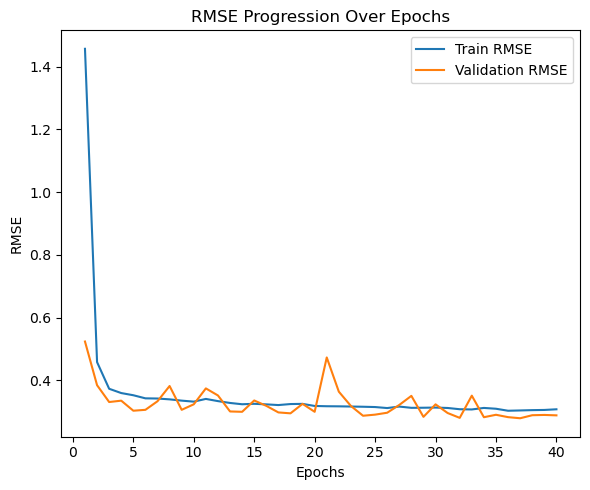

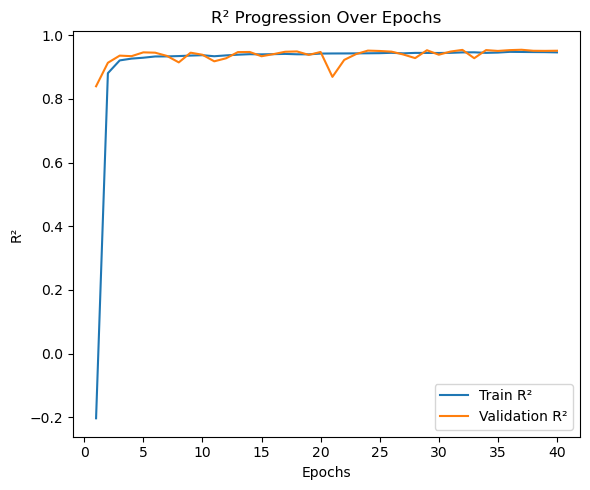


✅ Training complete. Best Val RMSE = 0.280

--- Evaluating Best Model on Test Set ---
✅ Final Test RMSE: 0.283 | Test R²: 0.952


In [253]:
# --- Shallow NN: Outfield Players ---
train_outfield_shallow_nn(df_outfield_vector, lr=0.005, N_epoch=40, batch_size=128)


--- Preparing Outfield Shallow NN Training ---
Epoch 01/40 → Train RMSE = 2.367 | Val RMSE = 0.844 | Train R² = -2.176 | Val R² = 0.584
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 02/40 → Train RMSE = 0.753 | Val RMSE = 0.642 | Train R² = 0.678 | Val R² = 0.760
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 03/40 → Train RMSE = 0.565 | Val RMSE = 0.481 | Train R² = 0.819 | Val R² = 0.865
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 04/40 → Train RMSE = 0.451 | Val RMSE = 0.408 | Train R² = 0.885 | Val R² = 0.903
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 05/40 → Train RMSE = 0.395 | Val RMSE = 0.369 | Train R² = 0.912 | Val R² = 0.921
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 06/40 → Train RMSE = 0.364 | Val RMSE = 0.344 | Train R² = 0.925 | Val R² = 0.931
💾 Best model saved (outfield_nn_shallow_best.pth)
Epoch 07/40 → Train RMSE = 0.345 | Val RMSE = 0.324 | Train R² = 0.932 | Val R² = 0.939
💾 Best model saved (outfield_nn_sha

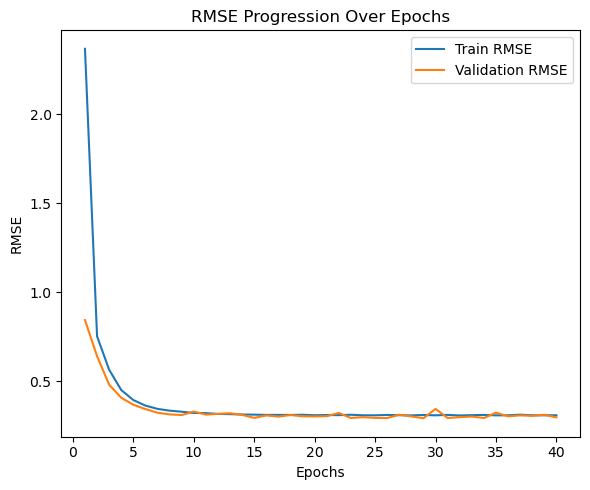

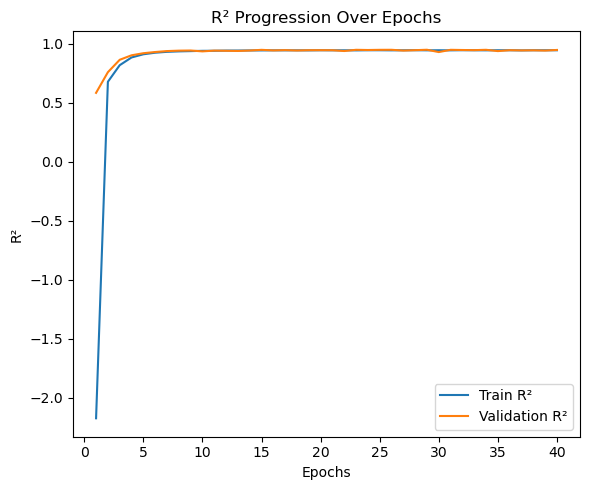


✅ Training complete. Best Val RMSE = 0.293

--- Evaluating Best Model on Test Set ---
✅ Final Test RMSE: 0.296 | Test R²: 0.948


In [283]:
# --- Shallow NN: Outfield Players ---
train_outfield_shallow_nn(df_outfield_vector, lr=0.0005, N_epoch=40, batch_size=128)

In [284]:
# --- Evaluate All Trained Models Using Saved Checkpoints ---

BATCH_SIZE = 128

# --- Load Test Loaders ---
test_loader_outfield = DataLoader(
    StreamingDataset(local="./outfield_mds_test", shuffle=False, batch_size=BATCH_SIZE),
    batch_size=BATCH_SIZE, num_workers=2
)

=== Test Evaluation: Outfield Shallow NN ===
RMSE (Test): 0.2955
R² (Test):   0.9483


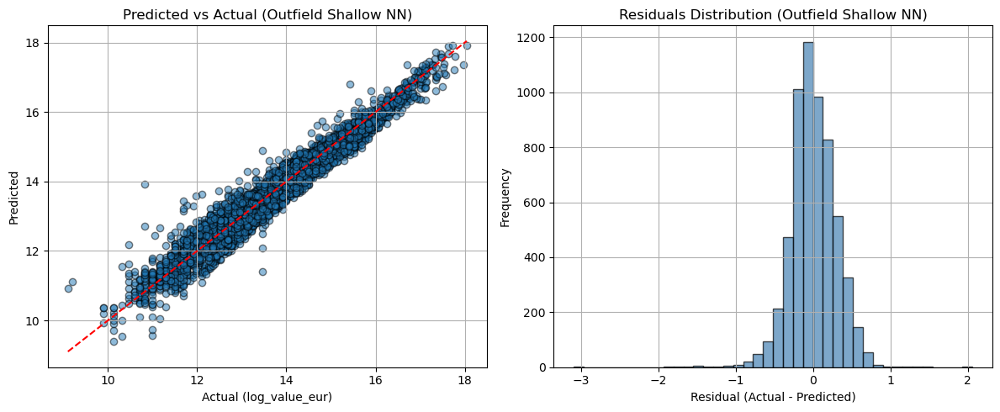

In [285]:
# Initialize model and load best checkpoint

input_dim_outfield = len(df_outfield_vector.first()["features"])
model_outfield_shallow = MLP_Shallow_Regression(input_dim_outfield)
model_outfield_shallow.load_state_dict(torch.load("outfield_nn_shallow_best.pth"))

# Evaluate
rmse_out_shallow, r2_out_shallow = evaluate_nn_model(
    model_outfield_shallow, test_loader_outfield, "Outfield Shallow NN"
)

#### Goalkeeper

In [257]:
# Goalkeepers
in_dim_gk = len(df_gk_vector.first()["features"])
model_gk = MLP_Shallow_Regression(in_dim_gk, 1)
print("=== Goalkeeper Shallow Model Structure ===")
print(model_gk)

=== Goalkeeper Shallow Model Structure ===
MLP_Shallow_Regression(
  (net): Sequential(
    (0): Linear(in_features=104, out_features=16, bias=True)
    (1): ReLU()
    (2): Linear(in_features=16, out_features=1, bias=True)
  )
)


In [258]:
def train_goalkeeper_shallow_nn(df_gk_vector, lr, N_epoch, batch_size):

    print("\n--- Preparing Goalkeeper Shallow NN Training ---")

    # Data paths (already generated in Setup)
    train_path = "./gk_mds_train"
    val_path = "./gk_mds_val"
    test_path = "./gk_mds_test"

    # DataLoaders
    BATCH_SIZE = batch_size
    train_loader_gk = DataLoader(
        StreamingDataset(local=train_path, shuffle=True, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    val_loader_gk = DataLoader(
        StreamingDataset(local=val_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    test_loader_gk = DataLoader(
        StreamingDataset(local=test_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )

    # Model
    in_dim_gk = len(df_gk_vector.first()["features"])
    model_gk = MLP_Shallow_Regression(in_dim_gk, 1)


    # --- Training Phase ---
    print("\n--- Training Goalkeeper Model (Shallow, Streaming) ---")
    train_model_regression_streaming(
        model_gk,
        train_loader_gk,
        val_loader_gk,  # <-- fixed: proper validation loader
        lr=lr,
        N_epochs=N_epoch,
        model_name="gk_nn_shallow_best.pth"
    )

    # --- Final Evaluation (Test set) ---
    print("\n--- Evaluating Best Model on Test Set ---")
    model_gk.load_state_dict(torch.load("gk_nn_shallow_best.pth"))
    model_gk.eval()

    y_true_test, y_pred_test = [], []
    with torch.no_grad():
        for batch in test_loader_gk:
            x, y = batch["features"], batch["label"].view(-1, 1)
            preds = model_gk(x)
            y_true_test.append(y.cpu().numpy())
            y_pred_test.append(preds.cpu().numpy())

    y_true_test, y_pred_test = np.vstack(y_true_test), np.vstack(y_pred_test)
    rmse_test = np.sqrt(np.mean((y_pred_test - y_true_test) ** 2))
    r2_test = 1 - np.sum((y_pred_test - y_true_test) ** 2) / np.sum((y_true_test - y_true_test.mean()) ** 2)
    print(f"✅ Final Test RMSE: {rmse_test:.3f} | Test R²: {r2_test:.3f}")
    


--- Preparing Goalkeeper Shallow NN Training ---

--- Training Goalkeeper Model (Shallow, Streaming) ---
Epoch 01/40 → Train RMSE = 2.061 | Val RMSE = 1.118 | Train R² = -1.230 | Val R² = 0.323
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 02/40 → Train RMSE = 1.034 | Val RMSE = 0.977 | Train R² = 0.439 | Val R² = 0.483
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 03/40 → Train RMSE = 0.893 | Val RMSE = 0.833 | Train R² = 0.581 | Val R² = 0.624
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 04/40 → Train RMSE = 0.784 | Val RMSE = 0.740 | Train R² = 0.677 | Val R² = 0.703
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 05/40 → Train RMSE = 0.698 | Val RMSE = 0.668 | Train R² = 0.744 | Val R² = 0.758
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 06/40 → Train RMSE = 0.641 | Val RMSE = 0.637 | Train R² = 0.784 | Val R² = 0.780
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 07/40 → Train RMSE = 0.595 | Val RMSE = 0.622 | Train R² = 0.814 | Val R² = 0.791
💾 Best model 

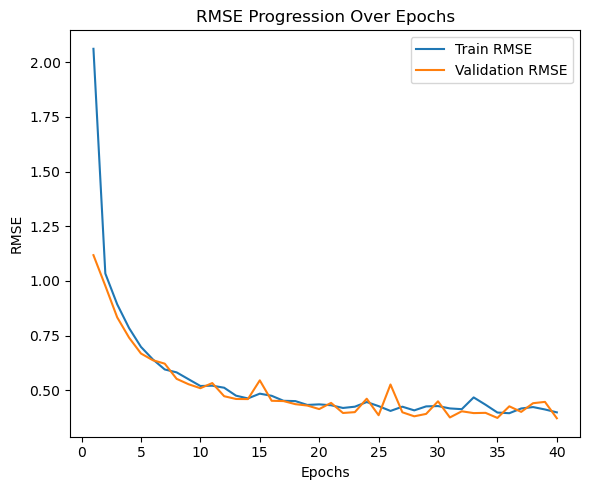

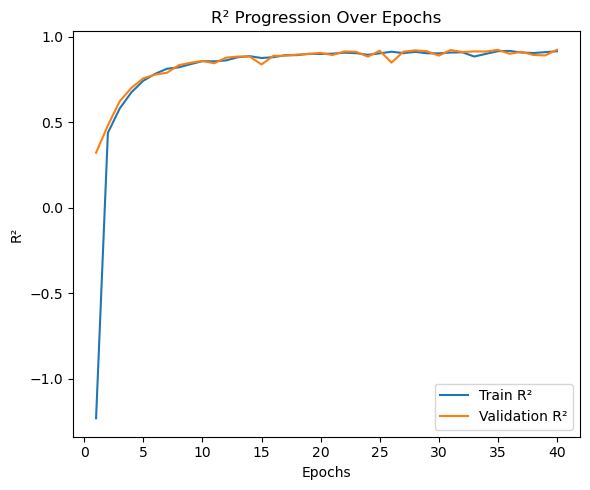


✅ Training complete. Best Val RMSE = 0.372

--- Evaluating Best Model on Test Set ---
✅ Final Test RMSE: 0.384 | Test R²: 0.929


In [279]:
# --- Shallow NN: Goalkeepers ---
train_goalkeeper_shallow_nn(df_gk_vector, lr=0.005, N_epoch=40, batch_size=128)


--- Preparing Goalkeeper Shallow NN Training ---

--- Training Goalkeeper Model (Shallow, Streaming) ---
Epoch 01/40 → Train RMSE = 3.656 | Val RMSE = 1.099 | Train R² = -6.016 | Val R² = 0.346
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 02/40 → Train RMSE = 1.032 | Val RMSE = 0.938 | Train R² = 0.441 | Val R² = 0.524
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 03/40 → Train RMSE = 0.902 | Val RMSE = 0.858 | Train R² = 0.573 | Val R² = 0.601
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 04/40 → Train RMSE = 0.824 | Val RMSE = 0.784 | Train R² = 0.644 | Val R² = 0.667
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 05/40 → Train RMSE = 0.761 | Val RMSE = 0.733 | Train R² = 0.696 | Val R² = 0.709
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 06/40 → Train RMSE = 0.702 | Val RMSE = 0.679 | Train R² = 0.741 | Val R² = 0.750
💾 Best model saved (gk_nn_shallow_best.pth)
Epoch 07/40 → Train RMSE = 0.657 | Val RMSE = 0.639 | Train R² = 0.774 | Val R² = 0.778
💾 Best model 

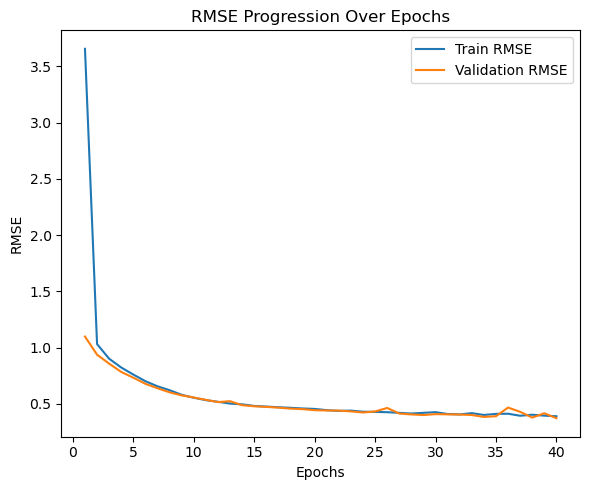

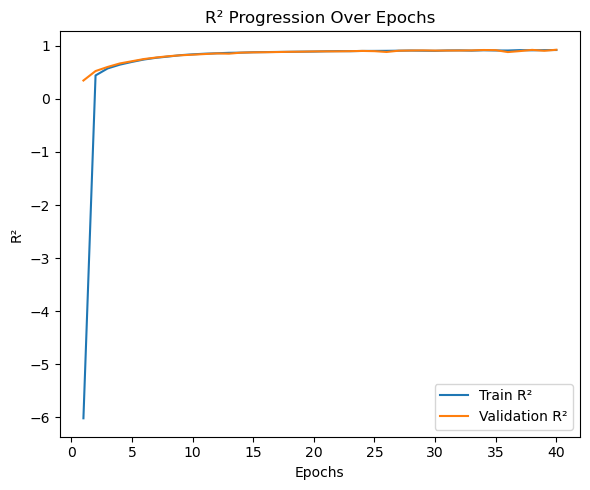


✅ Training complete. Best Val RMSE = 0.373

--- Evaluating Best Model on Test Set ---
✅ Final Test RMSE: 0.379 | Test R²: 0.930


In [280]:
# --- Shallow NN: Goalkeepers ---
train_goalkeeper_shallow_nn(df_gk_vector, lr=0.0025, N_epoch=40, batch_size=128)

In [281]:
# --- Evaluate All Trained Models Using Saved Checkpoints ---

BATCH_SIZE = 128

# --- Load Test Loaders ---
test_loader_gk = DataLoader(
    StreamingDataset(local="./gk_mds_test", shuffle=False, batch_size=BATCH_SIZE),
    batch_size=BATCH_SIZE, num_workers=2
)

=== Test Evaluation: Goalkeeper Shallow NN ===
RMSE (Test): 0.3795
R² (Test):   0.9305


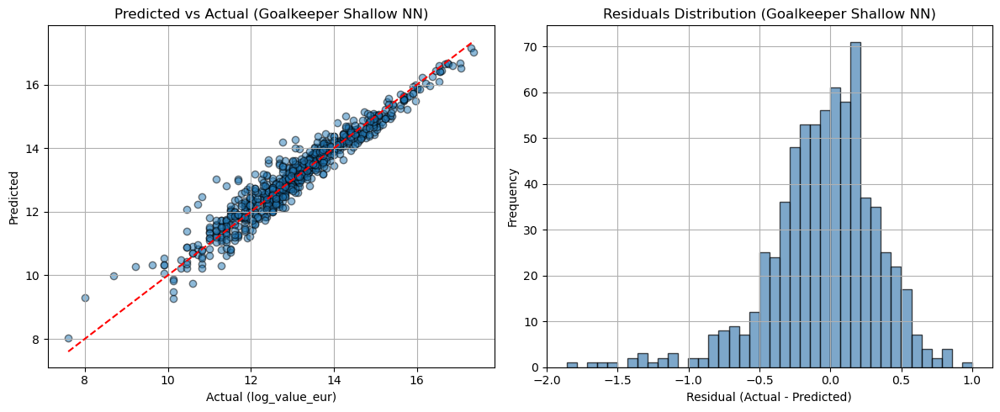

In [282]:
# Initialize model and load best checkpoint

input_dim_gk = len(df_gk_vector.first()["features"])
model_gk_shallow = MLP_Shallow_Regression(input_dim_gk)
model_gk_shallow.load_state_dict(torch.load("gk_nn_shallow_best.pth"))

rmse_gk_shallow, r2_gk_shallow = evaluate_nn_model(
    model_gk_shallow, test_loader_gk, "Goalkeeper Shallow NN"
)

### Deep Neural Networks (inp_dim - 64ReLU - 32ReLU - 16ReLU - 1)

In [263]:
# --- Model Definition (Deep Neural Network for Regression) ---

class MLP_Deep_Regression(nn.Module):
    def __init__(self, input_dim, output_dim=1):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, 64),
            nn.ReLU(),
            nn.Linear(64, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, output_dim)
        )

    def forward(self, x):
        return self.net(x)

#### Outfield Players

In [264]:
# Outfield Players
in_dim_outfield = len(df_outfield_vector.first()["features"])
model_outfield = MLP_Deep_Regression(in_dim_outfield, 1)
print("=== Outfield Shallow Model Structure ===")
print(model_outfield)

=== Outfield Shallow Model Structure ===
MLP_Deep_Regression(
  (net): Sequential(
    (0): Linear(in_features=111, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=32, bias=True)
    (3): ReLU()
    (4): Linear(in_features=32, out_features=16, bias=True)
    (5): ReLU()
    (6): Linear(in_features=16, out_features=1, bias=True)
  )
)


In [265]:
def train_outfield_deep_nn(df_outfield_vector, lr, N_epoch, batch_size):

    print("\n--- Preparing Outfield Deep NN Training ---")

    # Data paths (already generated in Setup)
    train_path = "./outfield_mds_train"
    val_path = "./outfield_mds_val"
    test_path = "./outfield_mds_test"

    # DataLoaders
    BATCH_SIZE = batch_size
    train_loader_outfield = DataLoader(
        StreamingDataset(local=train_path, shuffle=True, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    val_loader_outfield = DataLoader(
        StreamingDataset(local=val_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    test_loader_outfield = DataLoader(
        StreamingDataset(local=test_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )

    # Model
    in_dim_outfield = len(df_outfield_vector.first()["features"])
    model_outfield = MLP_Deep_Regression(in_dim_outfield, 1)


    # --- Training Phase ---
    print("\n--- Training Outfield Model (Deep, Streaming) ---")
    train_model_regression_streaming(
        model_outfield,
        train_loader_outfield,
        val_loader_outfield,  # <-- fixed: validation set now used
        lr=lr,
        N_epochs=N_epoch,
        model_name="outfield_nn_deep_best.pth"
    )

    # --- Final Evaluation (Test set) ---
    print("\n--- Evaluating Best Deep Model on Test Set ---")
    model_outfield.load_state_dict(torch.load("outfield_nn_deep_best.pth"))
    model_outfield.eval()

    y_true_test, y_pred_test = [], []
    with torch.no_grad():
        for batch in test_loader_outfield:
            x, y = batch["features"], batch["label"].view(-1, 1)
            preds = model_outfield(x)
            y_true_test.append(y.cpu().numpy())
            y_pred_test.append(preds.cpu().numpy())

    y_true_test, y_pred_test = np.vstack(y_true_test), np.vstack(y_pred_test)
    rmse_test = np.sqrt(np.mean((y_pred_test - y_true_test) ** 2))
    r2_test = 1 - np.sum((y_pred_test - y_true_test) ** 2) / np.sum((y_true_test - y_true_test.mean()) ** 2)
    print(f"✅ Final Test RMSE: {rmse_test:.3f} | Test R²: {r2_test:.3f}")


--- Preparing Outfield Deep NN Training ---

--- Training Outfield Model (Deep, Streaming) ---
Epoch 01/40 → Train RMSE = 0.880 | Val RMSE = 0.386 | Train R² = 0.561 | Val R² = 0.913
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 02/40 → Train RMSE = 0.398 | Val RMSE = 0.366 | Train R² = 0.910 | Val R² = 0.922
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 03/40 → Train RMSE = 0.364 | Val RMSE = 0.303 | Train R² = 0.925 | Val R² = 0.947
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 04/40 → Train RMSE = 0.359 | Val RMSE = 0.368 | Train R² = 0.927 | Val R² = 0.921
Epoch 05/40 → Train RMSE = 0.355 | Val RMSE = 0.427 | Train R² = 0.929 | Val R² = 0.894
Epoch 06/40 → Train RMSE = 0.356 | Val RMSE = 0.300 | Train R² = 0.928 | Val R² = 0.948
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 07/40 → Train RMSE = 0.340 | Val RMSE = 0.301 | Train R² = 0.934 | Val R² = 0.947
Epoch 08/40 → Train RMSE = 0.344 | Val RMSE = 0.305 | Train R² = 0.933 | Val R² = 0.946
Epoch 09/40 

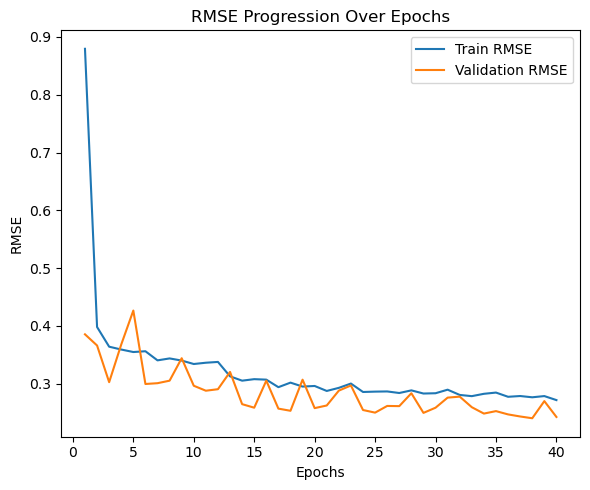

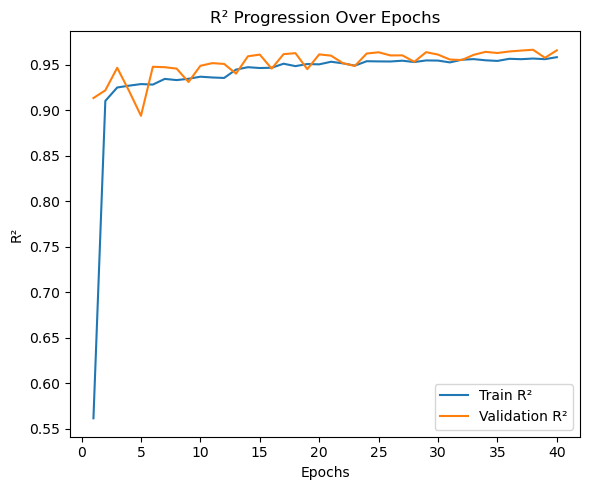


✅ Training complete. Best Val RMSE = 0.240

--- Evaluating Best Deep Model on Test Set ---
✅ Final Test RMSE: 0.248 | Test R²: 0.963


In [266]:
# --- Deep NN: Outfield Players ---
train_outfield_deep_nn(df_outfield_vector, lr=0.005, N_epoch=40, batch_size=128)


--- Preparing Outfield Deep NN Training ---

--- Training Outfield Model (Deep, Streaming) ---
Epoch 01/40 → Train RMSE = 2.101 | Val RMSE = 0.584 | Train R² = -1.501 | Val R² = 0.801
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 02/40 → Train RMSE = 0.488 | Val RMSE = 0.398 | Train R² = 0.865 | Val R² = 0.907
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 03/40 → Train RMSE = 0.386 | Val RMSE = 0.370 | Train R² = 0.916 | Val R² = 0.920
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 04/40 → Train RMSE = 0.359 | Val RMSE = 0.339 | Train R² = 0.927 | Val R² = 0.933
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 05/40 → Train RMSE = 0.345 | Val RMSE = 0.314 | Train R² = 0.933 | Val R² = 0.943
💾 Best model saved (outfield_nn_deep_best.pth)
Epoch 06/40 → Train RMSE = 0.332 | Val RMSE = 0.318 | Train R² = 0.937 | Val R² = 0.941
Epoch 07/40 → Train RMSE = 0.328 | Val RMSE = 0.334 | Train R² = 0.939 | Val R² = 0.935
Epoch 08/40 → Train RMSE = 0.323 | Val RMSE = 0.293 

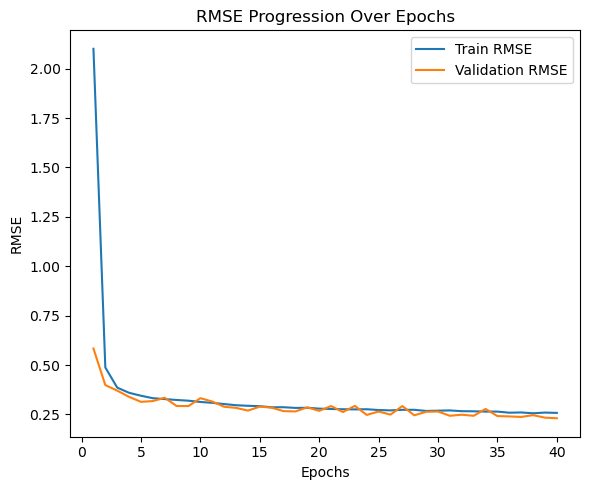

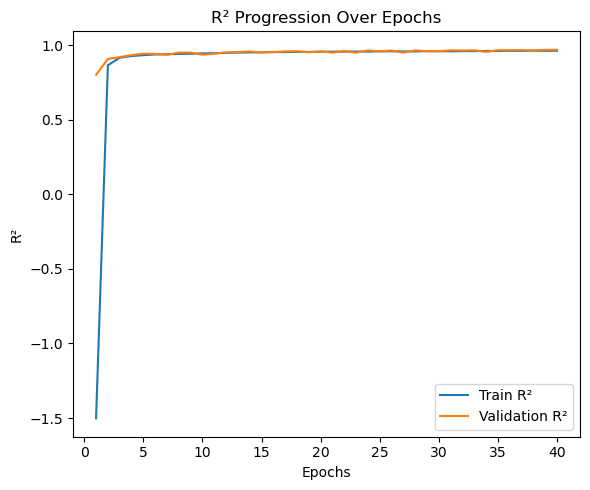


✅ Training complete. Best Val RMSE = 0.231

--- Evaluating Best Deep Model on Test Set ---
✅ Final Test RMSE: 0.235 | Test R²: 0.967


In [267]:
# --- Deep NN: Outfield Players ---
train_outfield_deep_nn(df_outfield_vector, lr=0.001, N_epoch=40, batch_size=128)

In [268]:
# --- Evaluate All Trained Models Using Saved Checkpoints ---

BATCH_SIZE = 128

# --- Load Test Loaders ---
test_loader_outfield = DataLoader(
    StreamingDataset(local="./outfield_mds_test", shuffle=False, batch_size=BATCH_SIZE),
    batch_size=BATCH_SIZE, num_workers=2
)

=== Test Evaluation: Outfield Deep NN ===
RMSE (Test): 0.2354
R² (Test):   0.9672


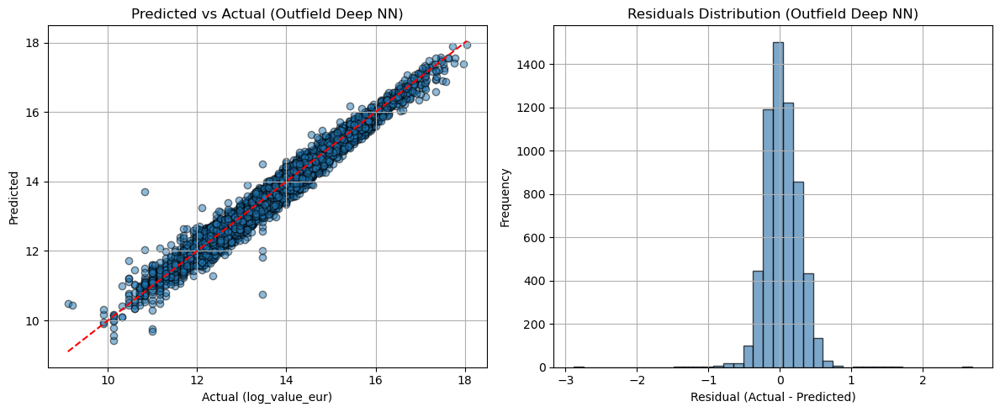

In [270]:
# Initialize model and load best checkpoint

input_dim_outfield = len(df_outfield_vector.first()["features"])
model_outfield_deep = MLP_Deep_Regression(input_dim_outfield)
model_outfield_deep.load_state_dict(torch.load("outfield_nn_deep_best.pth"))

rmse_out_deep, r2_out_deep = evaluate_nn_model(
    model_outfield_deep, test_loader_outfield, "Outfield Deep NN"
)

#### Goalkeeper

In [271]:
# Goalkeepers
in_dim_gk = len(df_gk_vector.first()["features"])
model_gk = MLP_Deep_Regression(in_dim_gk, 1)
print("=== Goalkeeper Shallow Model Structure ===")
print(model_gk)

=== Goalkeeper Shallow Model Structure ===
MLP_Deep_Regression(
  (net): Sequential(
    (0): Linear(in_features=104, out_features=64, bias=True)
    (1): ReLU()
    (2): Linear(in_features=64, out_features=32, bias=True)
    (3): ReLU()
    (4): Linear(in_features=32, out_features=16, bias=True)
    (5): ReLU()
    (6): Linear(in_features=16, out_features=1, bias=True)
  )
)


In [272]:
def train_goalkeeper_deep_nn(df_gk_vector, lr, N_epoch, batch_size):

    print("\n--- Preparing Goalkeeper Deep NN Training ---")

    # Data paths (already generated in Setup)
    train_path = "./gk_mds_train"
    val_path = "./gk_mds_val"
    test_path = "./gk_mds_test"

    # DataLoaders
    BATCH_SIZE = batch_size
    train_loader_gk = DataLoader(
        StreamingDataset(local=train_path, shuffle=True, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    val_loader_gk = DataLoader(
        StreamingDataset(local=val_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )
    test_loader_gk = DataLoader(
        StreamingDataset(local=test_path, shuffle=False, batch_size=BATCH_SIZE),
        batch_size=BATCH_SIZE, num_workers=2
    )

    # Model
    in_dim_gk = len(df_gk_vector.first()["features"])
    model_gk = MLP_Deep_Regression(in_dim_gk, 1)


    # --- Training Phase ---
    print("\n--- Training Goalkeeper Model (Deep, Streaming) ---")
    train_model_regression_streaming(
        model_gk,
        train_loader_gk,
        val_loader_gk,  # <-- fixed: use validation set
        lr=lr,
        N_epochs=N_epoch,
        model_name="gk_nn_deep_best.pth"
    )

    # --- Final Evaluation (Test set) ---
    print("\n--- Evaluating Best Model on Test Set ---")
    model_gk.load_state_dict(torch.load("gk_nn_deep_best.pth"))
    model_gk.eval()

    y_true_test, y_pred_test = [], []
    with torch.no_grad():
        for batch in test_loader_gk:
            x, y = batch["features"], batch["label"].view(-1, 1)
            preds = model_gk(x)
            y_true_test.append(y.cpu().numpy())
            y_pred_test.append(preds.cpu().numpy())

    y_true_test, y_pred_test = np.vstack(y_true_test), np.vstack(y_pred_test)
    rmse_test = np.sqrt(np.mean((y_pred_test - y_true_test) ** 2))
    r2_test = 1 - np.sum((y_pred_test - y_true_test) ** 2) / np.sum((y_true_test - y_true_test.mean()) ** 2)
    print(f"✅ Final Test RMSE: {rmse_test:.3f} | Test R²: {r2_test:.3f}")


--- Preparing Goalkeeper Deep NN Training ---

--- Training Goalkeeper Model (Deep, Streaming) ---
Epoch 01/40 → Train RMSE = 2.805 | Val RMSE = 1.011 | Train R² = -3.130 | Val R² = 0.446
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 02/40 → Train RMSE = 0.941 | Val RMSE = 0.829 | Train R² = 0.535 | Val R² = 0.628
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 03/40 → Train RMSE = 0.777 | Val RMSE = 0.720 | Train R² = 0.683 | Val R² = 0.719
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 04/40 → Train RMSE = 0.649 | Val RMSE = 0.611 | Train R² = 0.779 | Val R² = 0.797
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 05/40 → Train RMSE = 0.561 | Val RMSE = 0.543 | Train R² = 0.835 | Val R² = 0.840
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 06/40 → Train RMSE = 0.560 | Val RMSE = 0.535 | Train R² = 0.835 | Val R² = 0.845
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 07/40 → Train RMSE = 0.514 | Val RMSE = 0.555 | Train R² = 0.862 | Val R² = 0.833
Epoch 08/40 → Train RMSE = 0.488 | Va

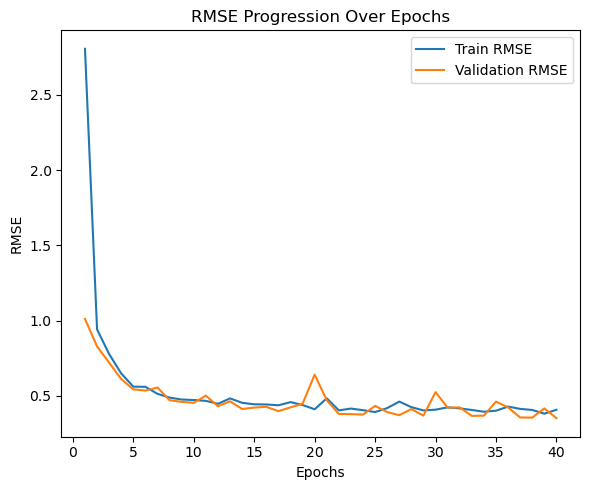

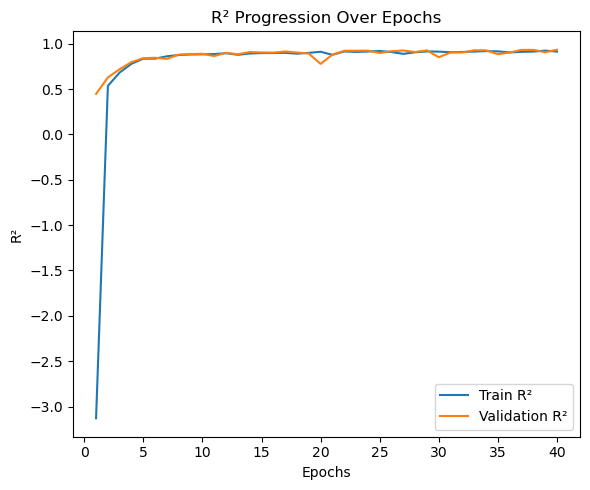


✅ Training complete. Best Val RMSE = 0.351

--- Evaluating Best Model on Test Set ---
✅ Final Test RMSE: 0.366 | Test R²: 0.935


In [273]:
# --- Deep NN: Goalkeepers ---
train_goalkeeper_deep_nn(df_gk_vector, lr=0.005, N_epoch=40, batch_size=128)


--- Preparing Goalkeeper Deep NN Training ---

--- Training Goalkeeper Model (Deep, Streaming) ---
Epoch 01/40 → Train RMSE = 3.556 | Val RMSE = 1.110 | Train R² = -5.638 | Val R² = 0.332
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 02/40 → Train RMSE = 1.060 | Val RMSE = 0.987 | Train R² = 0.410 | Val R² = 0.473
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 03/40 → Train RMSE = 0.932 | Val RMSE = 0.894 | Train R² = 0.544 | Val R² = 0.567
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 04/40 → Train RMSE = 0.827 | Val RMSE = 0.758 | Train R² = 0.641 | Val R² = 0.689
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 05/40 → Train RMSE = 0.714 | Val RMSE = 0.657 | Train R² = 0.732 | Val R² = 0.766
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 06/40 → Train RMSE = 0.622 | Val RMSE = 0.596 | Train R² = 0.797 | Val R² = 0.807
💾 Best model saved (gk_nn_deep_best.pth)
Epoch 07/40 → Train RMSE = 0.566 | Val RMSE = 0.575 | Train R² = 0.832 | Val R² = 0.821
💾 Best model saved (gk_nn_deep_best.p

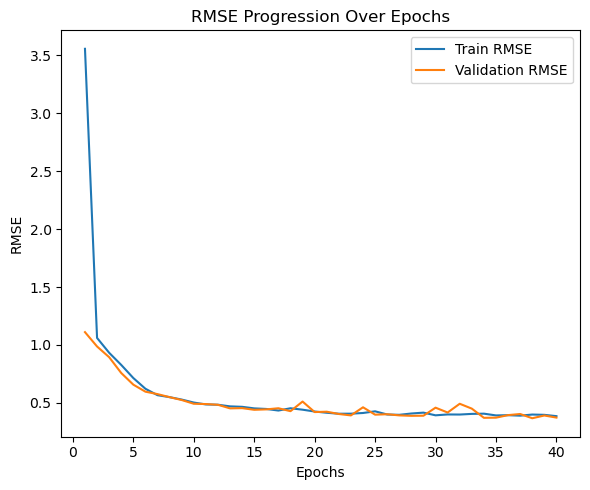

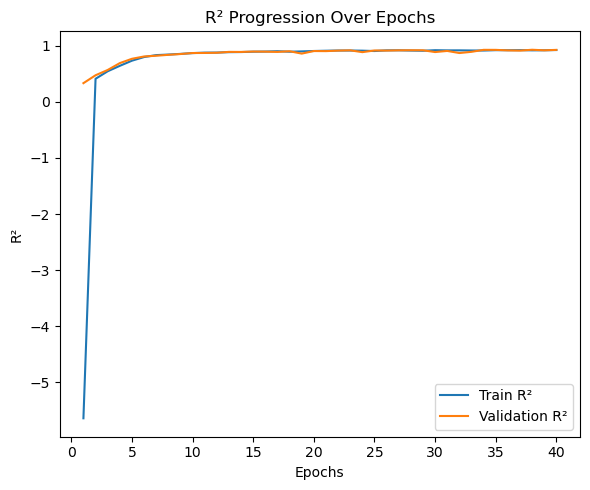


✅ Training complete. Best Val RMSE = 0.367

--- Evaluating Best Model on Test Set ---
✅ Final Test RMSE: 0.382 | Test R²: 0.930


In [274]:
# --- Deep NN: Goalkeepers ---
train_goalkeeper_deep_nn(df_gk_vector, lr=0.001, N_epoch=40, batch_size=128)

In [275]:
# --- Evaluate All Trained Models Using Saved Checkpoints ---

BATCH_SIZE = 128

# --- Load Test Loaders ---
test_loader_gk = DataLoader(
    StreamingDataset(local="./gk_mds_test", shuffle=False, batch_size=BATCH_SIZE),
    batch_size=BATCH_SIZE, num_workers=2
)

=== Test Evaluation: Goalkeeper Deep NN ===
RMSE (Test): 0.3816
R² (Test):   0.9297


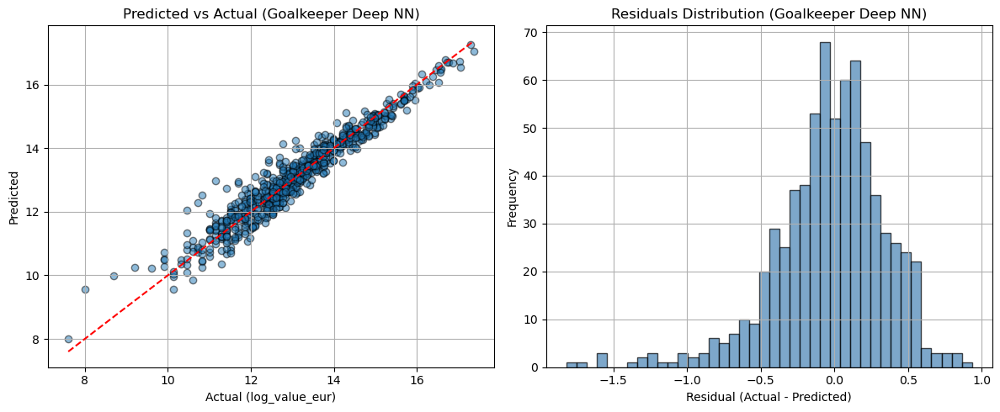

In [276]:
# Initialize model and load best checkpoint

input_dim_gk = len(df_gk_vector.first()["features"])
model_gk_deep = MLP_Deep_Regression(input_dim_gk)
model_gk_deep.load_state_dict(torch.load("gk_nn_deep_best.pth"))

rmse_gk_deep, r2_gk_deep = evaluate_nn_model(
    model_gk_deep, test_loader_gk, "Goalkeeper Deep NN"
)

## Model Performance Summary

Primary training loss function: **Mean Squared Error (MSE)**. All metrics below are computed on the **test set**.

### Outfield Players

#### Spark Models (Linear Regression & Random Forest)

| Model             | RMSE (Test) | R² (Test) |
|-------------------|-------------|-----------|
| Linear Regression | 0.298       | 0.949     |
| Random Forest     | 0.240       | 0.967     |


**Best (Outfield, Spark): Random Forest**

---

#### Neural Networks (PyTorch)

Training loss function: **MSE**

| Model       | RMSE (Test) | R² (Test) |
|-------------|-------------|-----------|
| Shallow NN  | 0.2955      | 0.9483    |
| Deep NN     | 0.2354      | 0.9672    |


**Best (Outfield, NN): Deep NN**

---

#### Overall Winner — Outfield Players

| Category                  | Best Model   |
|---------------------------|--------------|
| Traditional ML Model      | Random Forest |
| Neural Network Model      | Deep NN       |
| **Overall Top Performer** | **Deep NN**   |


### Goalkeeper

#### Spark Models (Linear Regression & Random Forest)

| Model             | RMSE (Test) | R² (Test) |
|-------------------|-------------|-----------|
| Linear Regression | 0.370       | 0.929     |
| Random Forest     | 0.250       | 0.968     |

**Best (Goalkeepers, Spark): Random Forest**

---

#### Neural Networks (PyTorch)

Training loss function: **MSE**

| Model       | RMSE (Test) | R² (Test) |
|-------------|-------------|-----------|
| Shallow NN  | 0.3795      | 0.9305    |
| Deep NN     | 0.3816      | 0.9297    |

**Best (Goalkeepers, NN): Shallow NN**

---

#### Overall Winner — Goalkeepers

| Category                  | Best Model     |
|---------------------------|----------------|
| Traditional ML Model      | Random Forest  |
| Neural Network Model      | Shallow NN     |
| **Overall Top Performer** | **Random Forest** |


# Task- IV: Deploy your code to the Cloud: (10% of the course grade)

**- Refer to:**
  - 14763_FIFA_Project_Cloud_Part1.ipynb
  - 14763_FIFA_Project_Cloud_Part2.ipynb

# Deploying PostgreSQL on a cloud VM using Docker (without Cloud SQL)

**- Refer to:**
  - 14763_FIFA_Project_Cloud _Docker_Container.ipynb

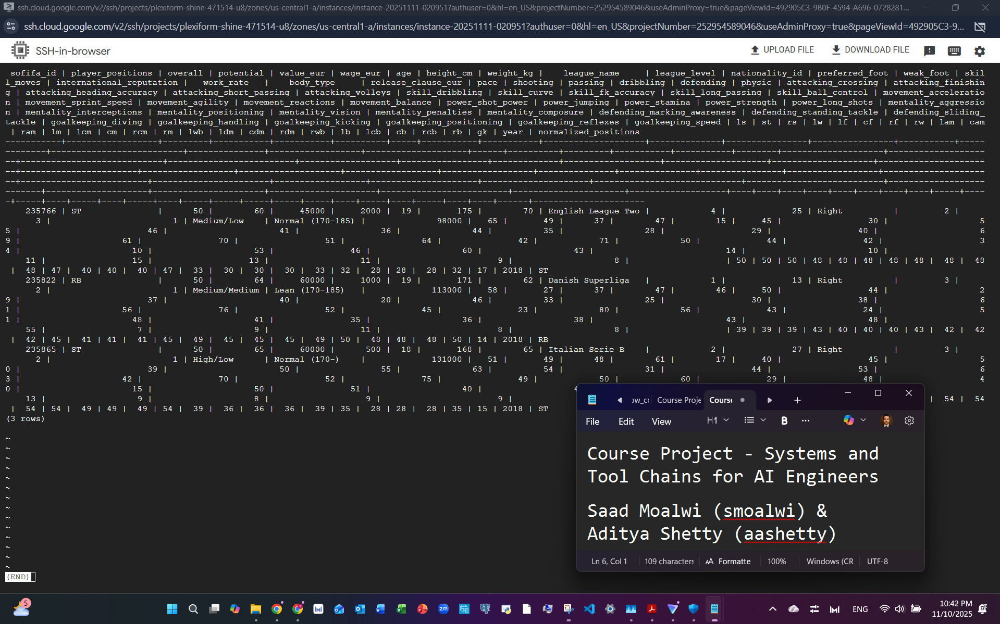

In [5]:
Image("PostgreSQL on the cloud as a Docker container.png")

| **Component** | **Detail** |
|----------------|------------|
| **Docker Container Name** | `postgres-db` |
| **If Docker Container Status** | Exited (Stopped). Must be started using `sudo docker start postgres-db`. |
| **PostgreSQL Database Name** | `postgres` (The default, used in `psql -d` command) |
| **PostgreSQL Username** | `postgres` (The default, used in `psql -U` command) |
| **Table Containing Data** | `fifa_cloud_docker_container` |
| **VM External IP** | (Must be looked up) You will get a new IP every time you start the VM unless you promote it to **Static**. |


1. **Start the PostgreSQL Container (VM Level)**

   First, ensure the Docker container (postgres-db) is running on your Virtual Machine.
   
   ```sudo docker start postgres-db```
2. **Access the Database and Query (Inside Container)**

   a) Enter Container:
   ```sudo docker exec -it postgres-db bash```

   b) Connect to DB:
   ```psql -d postgres -U postgres```
   
4. **View Sample Data (Inside psql prompt)**

   ```SELECT * FROM fifa_cloud_docker_container LIMIT 3;```